<a href="https://colab.research.google.com/github/holstbone/NLP/blob/main/A_3_Ontology_and_Context.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A.3 Ontology and Context


# Andy's Work Starts Here:

In [ ]:
!python --version

Python 3.7.11


## Load Python Libraries

In [ ]:
!pip install spacy==3.1.1

     |████████████████████████████████| 6.4 MB 5.2 MB/s 
     |████████████████████████████████| 42 kB 980 kB/s 
     |████████████████████████████████| 10.1 MB 39.3 MB/s 
     |████████████████████████████████| 621 kB 43.6 MB/s 
     |████████████████████████████████| 456 kB 32.3 MB/s 
  Attempting uninstall: catalogue
    Found existing installation: catalogue 1.0.0
    Uninstalling catalogue-1.0.0:
      Successfully uninstalled catalogue-1.0.0
  Attempting uninstall: srsly
    Found existing installation: srsly 1.0.5
    Uninstalling srsly-1.0.5:
      Successfully uninstalled srsly-1.0.5
  Attempting uninstall: thinc
    Found existing installation: thinc 7.4.0
    Uninstalling thinc-7.4.0:
      Successfully uninstalled thinc-7.4.0
  Attempting uninstall: spacy
    Found existing installation: spacy 2.2.4
    Uninstalling spacy-2.2.4:
      Successfully uninstalled spacy-2.2.4


In [ ]:
import re
import pandas as pd
import spacy
from spacy import displacy
import nltk
import os

from spacy.matcher import Matcher 
from spacy.tokens import Span 

import networkx as nx
import matplotlib
import matplotlib.pyplot as plt
from tqdm import tqdm

In [ ]:
print('The matplotlib version is {}.'.format(matplotlib.__version__))
print('The spacy version is {}.'.format(spacy.__version__))
print('The pandas version is {}.'.format(pd.__version__))
print('The re version is {}.'.format(re.__version__))
print('The networkx version is {}.'.format(nx.__version__))

The matplotlib version is 3.2.2.
The spacy version is 3.1.1.
The pandas version is 1.1.5.
The re version is 2.2.1.
The networkx version is 2.5.1.


In [ ]:
!python -m spacy download en_core_web_sm

2021-08-03 22:13:11.932438: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
     |████████████████████████████████| 13.6 MB 72 kB/s 
  Attempting uninstall: en-core-web-sm
    Found existing installation: en-core-web-sm 2.2.5
    Uninstalling en-core-web-sm-2.2.5:
      Successfully uninstalled en-core-web-sm-2.2.5
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [ ]:
nlp = spacy.load('en_core_web_sm')

In [ ]:
# Only run this once, they will be downloaded.
nltk.download('stopwords')
nltk.download('wordnet')
#nltk.download('punkt')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

## Load CSV (Class Corpus)

In [ ]:
# This section of the code prepares the required variables 
# to run functions set for each section of code

#read in class corpus csv into python
data=pd.read_csv('/content/drive/MyDrive/MSDS 453/A.1 - First Vectorized Representation (100 pts)/453_Sec56_Class_Corpus_v3_AH.csv')


### Manually convert text documents from Western European (Mac) and Western European (Windows), to Unicode (UTF-8)

In [ ]:
def get_corpus_text( path, titles ) :
    text_body=[]
    for doc in titles:
        filename = os.path.join( path, doc+'.txt' )
        # load text 
        files = os.listdir( path )
        #print(filename)
        file = open(filename, 'rt')#, encoding='utf-8-sig') 
        temp_text = file.read()
        file.close()
        text_body.append(temp_text)
        #print(len(text_body))
        
    return text_body

Make a copy of the original DataFrame, in case we need it later.

In [ ]:
data_v1 = data.copy()

In [ ]:
data_v1.columns

Index(['Doc_ID', 'DSI_Title', 'Text', 'Submission File Name', 'Student Name',
       'Genre of Movie', 'Review Type (pos or neg)', 'Movie Title'],
      dtype='object')

In [ ]:
data = data.drop(columns=['Text'])

Import the manually cleaned documents, which have been:

* Converted from Western European (Mac) and Western European (Windows), to Unicode (UTF-8).
* Stripped of metadata at the beginning of each review.

In [ ]:
zip_path = '/content/drive/MyDrive/MSDS 453/A.1 - First Vectorized Representation (100 pts)/Documents_AH_Manual_Clean.zip'
!cp "{zip_path}" .
!unzip -q Documents_AH_Manual_Clean.zip
!rm Documents_AH_Manual_Clean.zip

In [ ]:
FOLDER = "/content/Documents_AH_Manual_Clean"
titles = list(data['DSI_Title'])
text = get_corpus_text( FOLDER, titles )

In [ ]:
data.insert(2, 'Text', text)

In [ ]:
len(data['Text'])

200

## Create one big blog of text for knowledge graph generation

In [ ]:
corpusJoined = ' '.join([x for x in data['Text']]).split('.')

In [ ]:
corpusJoined[:5]

['Canadian director Denis Villeneuve made one great film in 2013 called Prisoners',
 ' Provocative, enthralling and beautifully composed, it peeled away the layers of a complex mystery story with a surprise in every frame',
 ' I was an instant fan',
 ' This promising relationship has come to a heartbreaking finale with every film since',
 ' Enemy and Sicario were unspeakable disasters, and Arrival, the director’s latest exercise in pretentious poopery, gives me every reason to believe I have parted company with Denis Villeneuve for good']

## Function for entity extraction

In [ ]:
#function for entity extraction
def get_entities(sent):
  ## chunk 1
  ent1 = ""
  ent2 = ""

  prv_tok_dep = ""    # dependency tag of previous token in the sentence
  prv_tok_text = ""   # previous token in the sentence

  prefix = ""
  modifier = ""

  #############################################################
  
  for tok in nlp(sent):
    ## chunk 2
    # if token is a punctuation mark then move on to the next token
    if tok.dep_ != "punct":
      # check: token is a compound word or not
      if tok.dep_ == "compound":
        prefix = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      
      # check: token is a modifier or not
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      
      ## chunk 3
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      

      ## chunk 4
      if tok.dep_.find("obj") == True:
        ent2 = modifier +" "+ prefix +" "+ tok.text
        
      ## chunk 5  
      # update variables
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
  #############################################################

  return [ent1.strip(), ent2.strip()]

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 6715/6715 [01:23<00:00, 80.14it/s]


In [ ]:
entity_pairs[:5]

[['Canadian director Denis Villeneuve', 'great  2013'],
 ['beautifully  it', 'complex mystery frame'],
 ['I', ''],
 ['promising  relationship', 'heartbreaking  film'],
 ['pretentious  I', 'Denis good']]

In [ ]:
test = nlp(corpusJoined[2])

In [ ]:
for tok in test:
  print(tok.text, tok.dep_)

  punct
I nsubj
was ROOT
an det
instant amod
fan attr


## Function to Get Relations

In [ ]:
def get_relation(sent):
    try:
        doc = nlp(sent)
        # Matcher class object 
        matcher = Matcher(nlp.vocab)
        #define the pattern 
        pattern = [{'DEP':'ROOT'}, 
                {'DEP':'prep','OP':"?"},
                {'DEP':'agent','OP':"?"},  
                {'POS':'ADJ','OP':"?"}] 
        matcher.add("matching_1", [pattern]) 
        matches = matcher(doc)
        k = len(matches) - 1
        span = doc[matches[k][1]:matches[k][2]] 
        return(span.text)
    except:
        pass

  

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is       788
         628
's       180
are      177
’s       119
\n\n     115
has      101
was       83
be        66
have      64
makes     37
plays     34
made      34
takes     32
want      26
seems     25
had       24
been      24
seem      24
Made      22
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
kg_df.head(100)

,source,target,edge
0,Canadian director Denis Villeneuve,great 2013,made
1,beautifully it,complex mystery frame,peeled
2,I,,was
3,promising relationship,heartbreaking film,
4,pretentious I,Denis good,were unspeakable
...,...,...,...
95,language,real two,thinks
96,two people,together end,’s
97,staid we,staid tropes,set
98,Arrival,trying times,is


In [ ]:
print(pd.Series(source).value_counts()[:20])

         647
it       152
It       144
that     115
he       104
I         95
they      88
you       66
He        65
who       61
we        60
she       49
They      45
film      38
She       34
We        32
movie     31
This      29
You       25
That      23
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

             766
it            86
them          45
him           31
you           26
film          25
movie         23
what          19
me            18
her           13
something     11
house         11
us            11
that          10
story         10
world         10
time           9
family         9
this           9
way            8
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

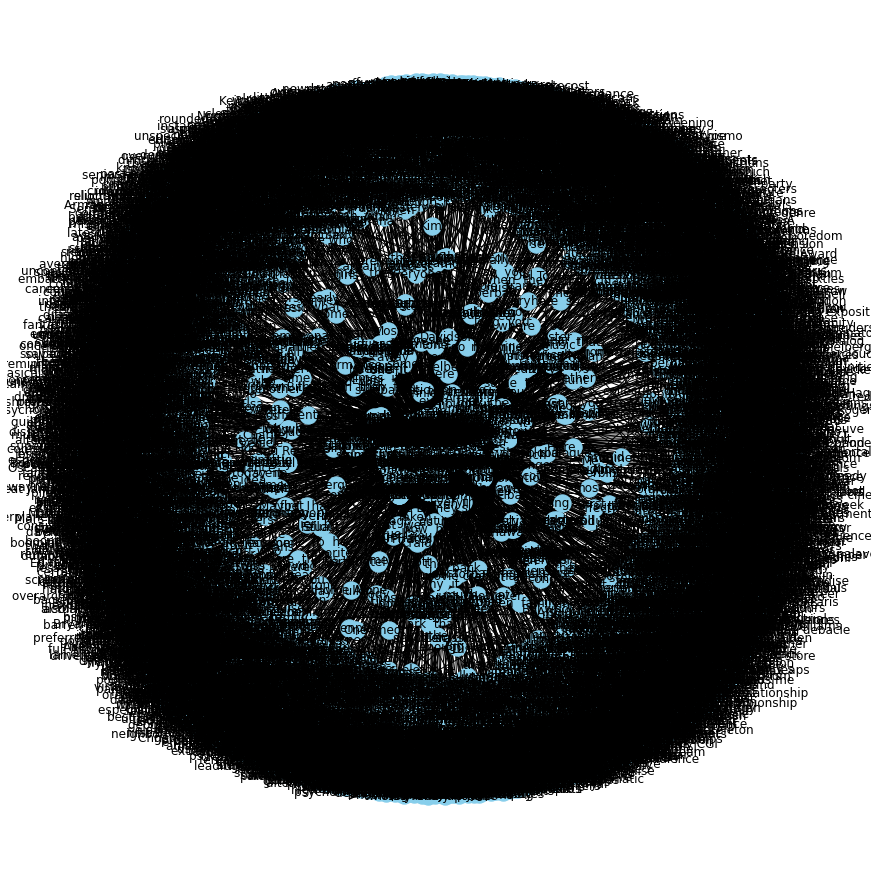

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

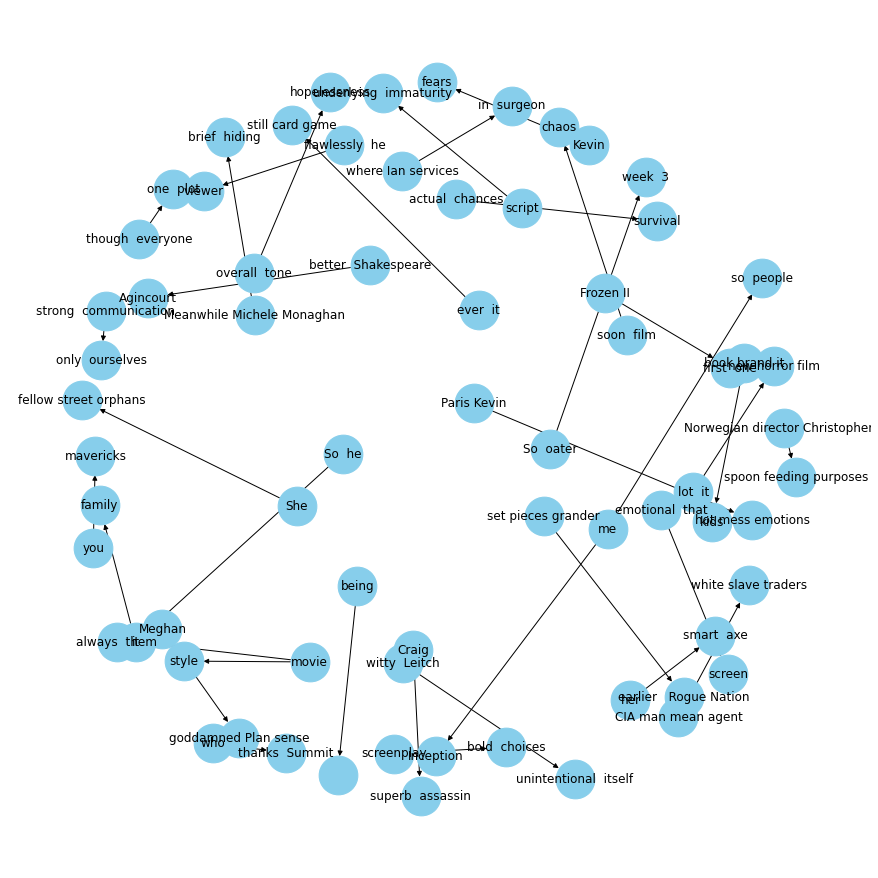

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())``

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

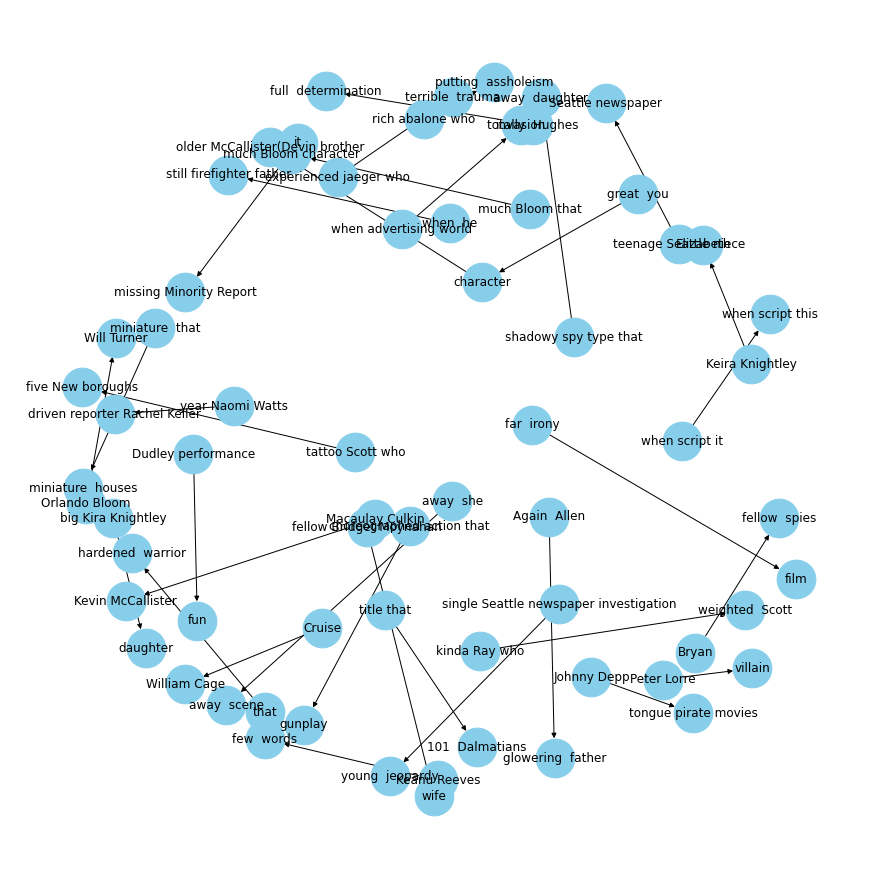

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

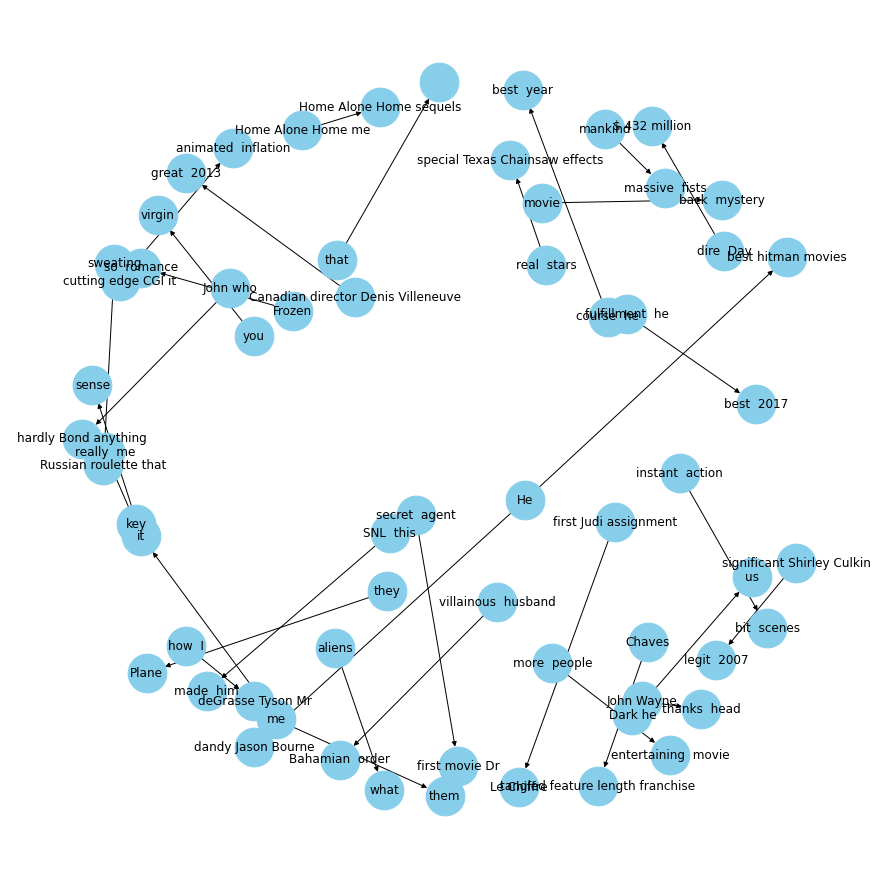

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

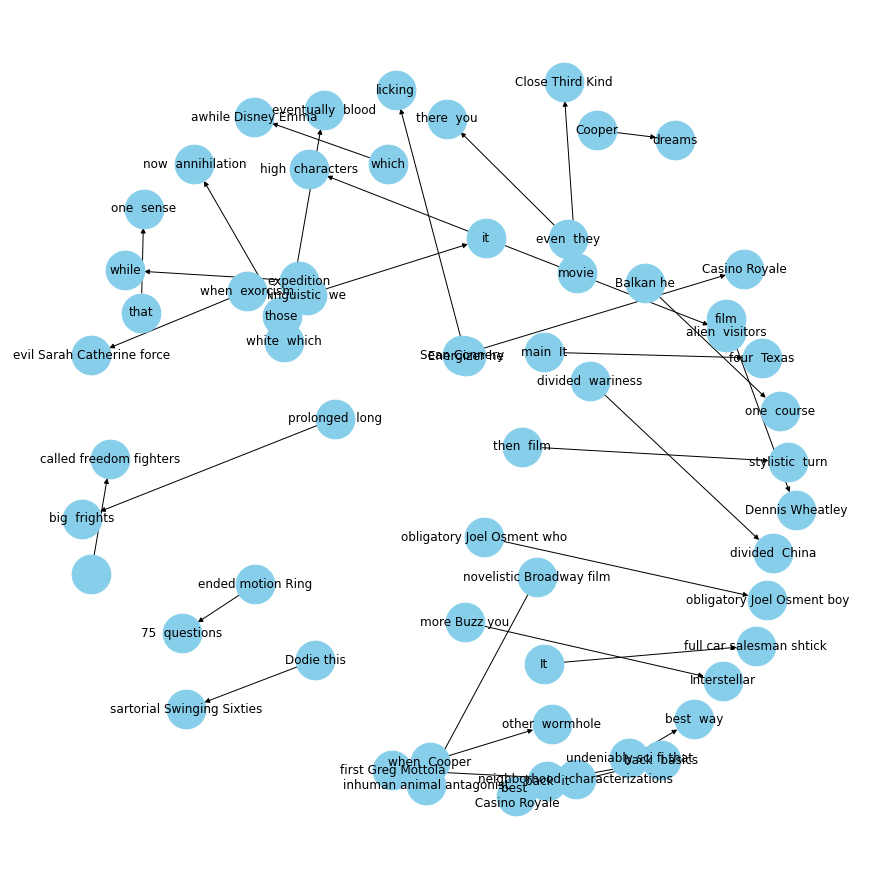

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

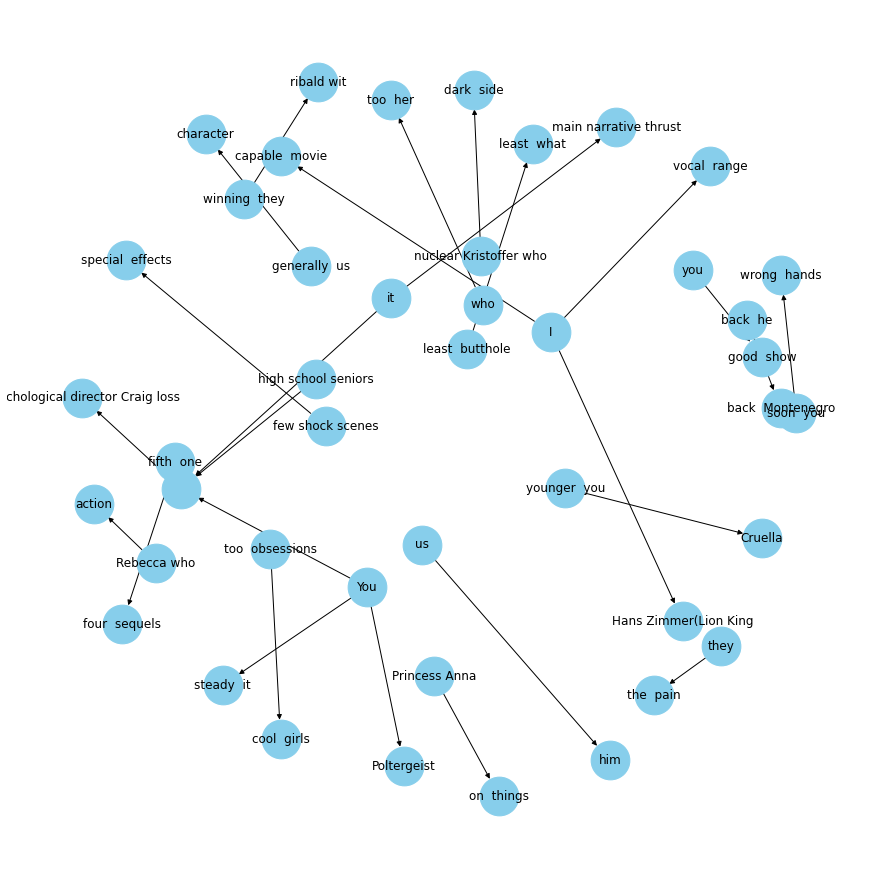

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

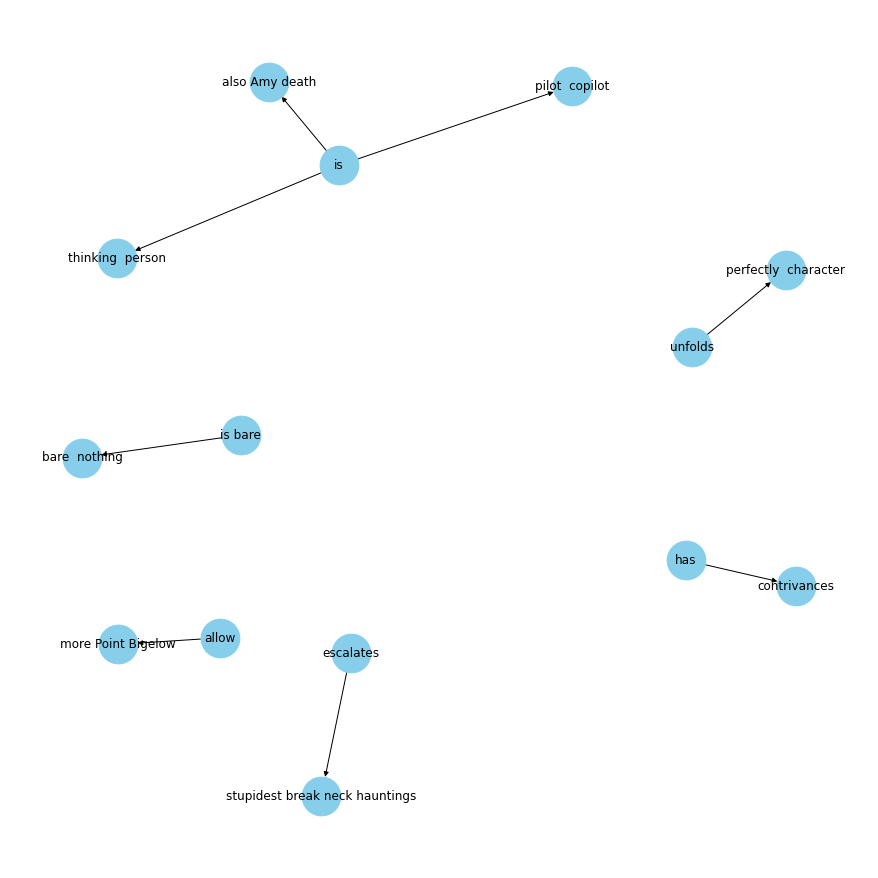

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="story"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation - SINGLE MOVIE

In [ ]:
data['Text'][160:170]

160    ﻿The new film Cruella (in theaters and on Disn...
161    ﻿I never expected to be able to use Disney and...
162    ﻿Cruella De Vil is one of Disney's most iconic...
163    ﻿In 1996, Glenn Close glided onto screens in f...
164    ﻿Think of the delicious new movie “Cruella” as...
165    ﻿In the original, animated 101 Dalmatians, the...
166    ﻿There's an excellent Emma in "Cruella," but i...
167    ﻿With her shock of black-and-white hair and cr...
168    ﻿Everything that’s good about “Cruella” can’t ...
169    ﻿Craig Gillespie’s Cruella explores the backst...
Name: Text, dtype: object

In [ ]:
corpusJoined = ' '.join([x for x in data['Text'][160:170]]).split('.')

In [ ]:
corpusJoined[:5]

['\ufeffThe new film Cruella (in theaters and on Disney+, May 28) is going okay until the fashion show',
 ' Young Cruella de Vil (Emma Stone) is trying to get revenge against a cruel couture designer, the Baroness (Emma Thompson), by staging a guerrilla runway show to upstage the Baroness’s own',
 ' It’s 1970s London, and Cruella and some other models take to the makeshift catwalk in shocking new glam-punk garb while a band thrashes away at a song',
 ' \n\nIt’s at this point that one realizes that the film, directed by I, Tonya’s Craig Gillespie, really is trying to be cool',
 ' And not just cool; it’s crediting a Disney character (inspired by a Dodie Smith character) with the invention of punk']

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 268/268 [00:03<00:00, 85.93it/s]


In [ ]:
entity_pairs[:5]

[['new  film', 'okay fashion show'],
 ['', 'cruel guerrilla runway ’s'],
 ['glam punk band', 'away  song'],
 ['film', 'I'],
 ['just  it', 'Dodie Smith punk']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

## Extract Source and Target

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         28
           20
was         8
's          7
’s          7
\n\n        6
makes       5
wants       3
takes       3
keeps       3
gets        3
been        3
are         3
want        3
becomes     3
take        2
starts      2
plays       2
be          2
finds       2
dtype: int64


In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
print(pd.Series(source).value_counts()[:10])

           30
she         9
It          7
She         6
Cruella     5
movie       4
film        4
you         3
that        3
he          2
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:10])

                             25
them                          3
kids                          2
her                           2
one                           2
101  Dalmatians               2
time                          2
Cruella                       2
all Mickey logo               1
inhuman animal antagonist     1
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

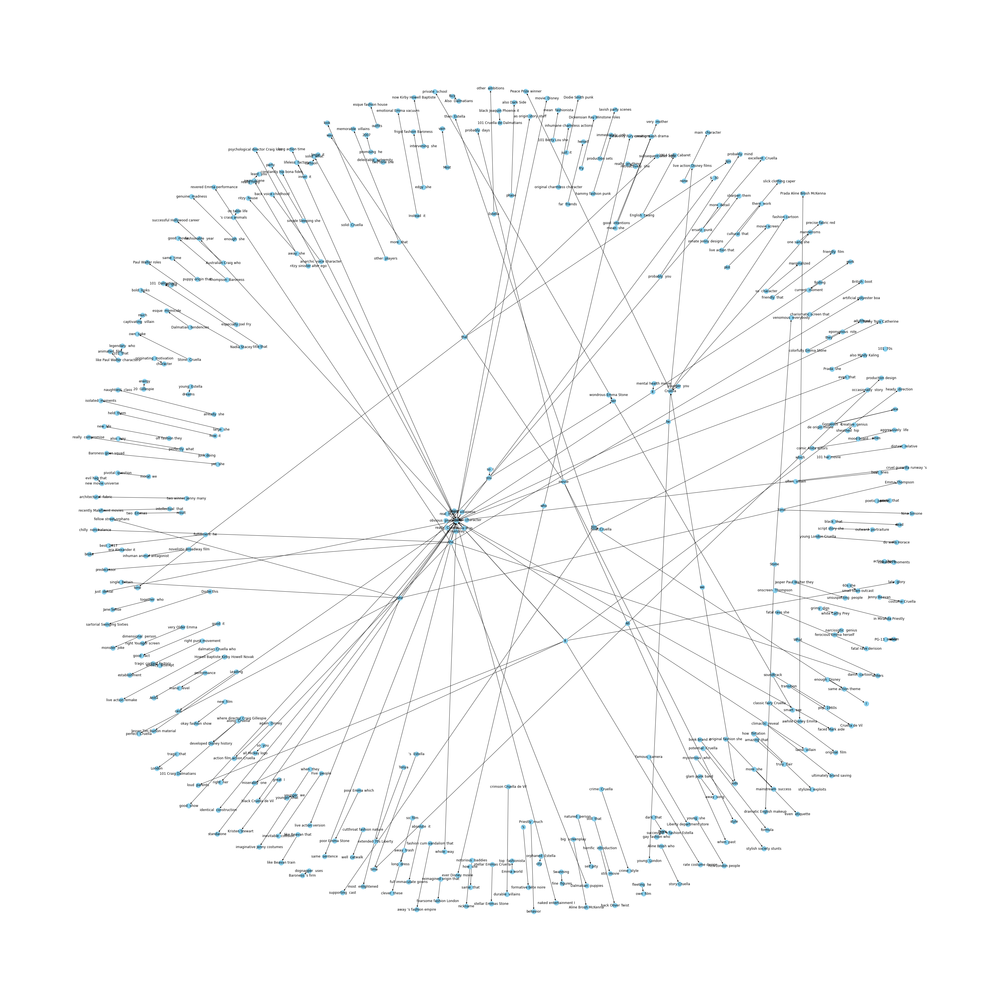

In [ ]:
plt.figure(figsize=(50,50))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
kg_df = kg_df.sort_values('source', ascending=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[0:67], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

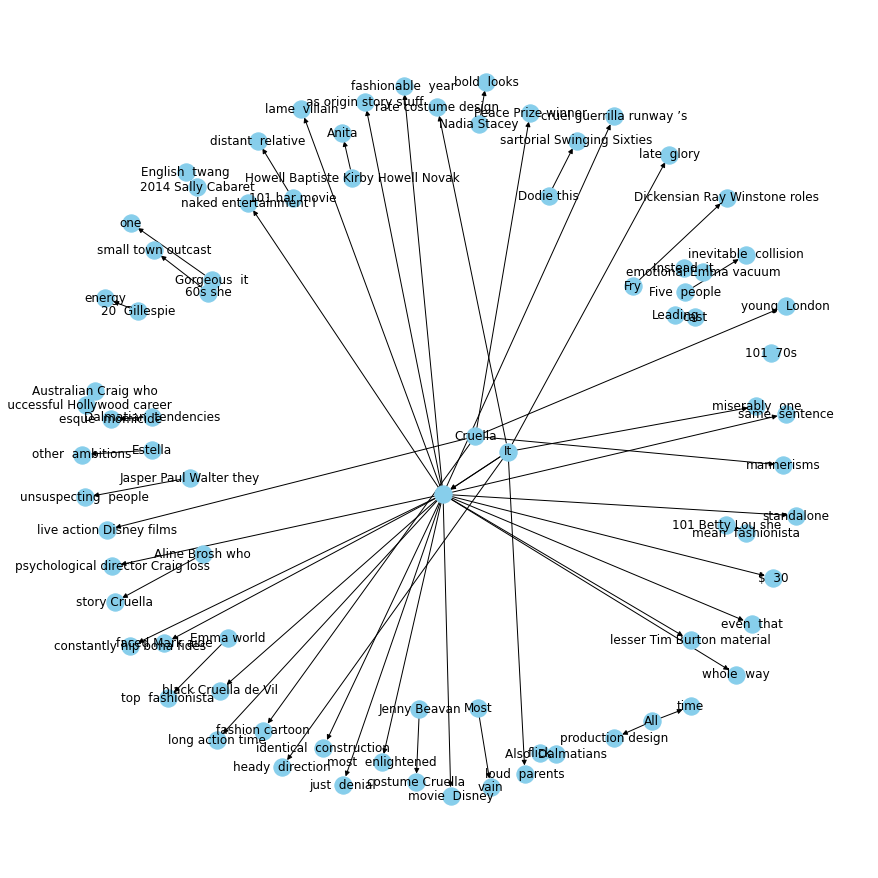

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[67:134], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

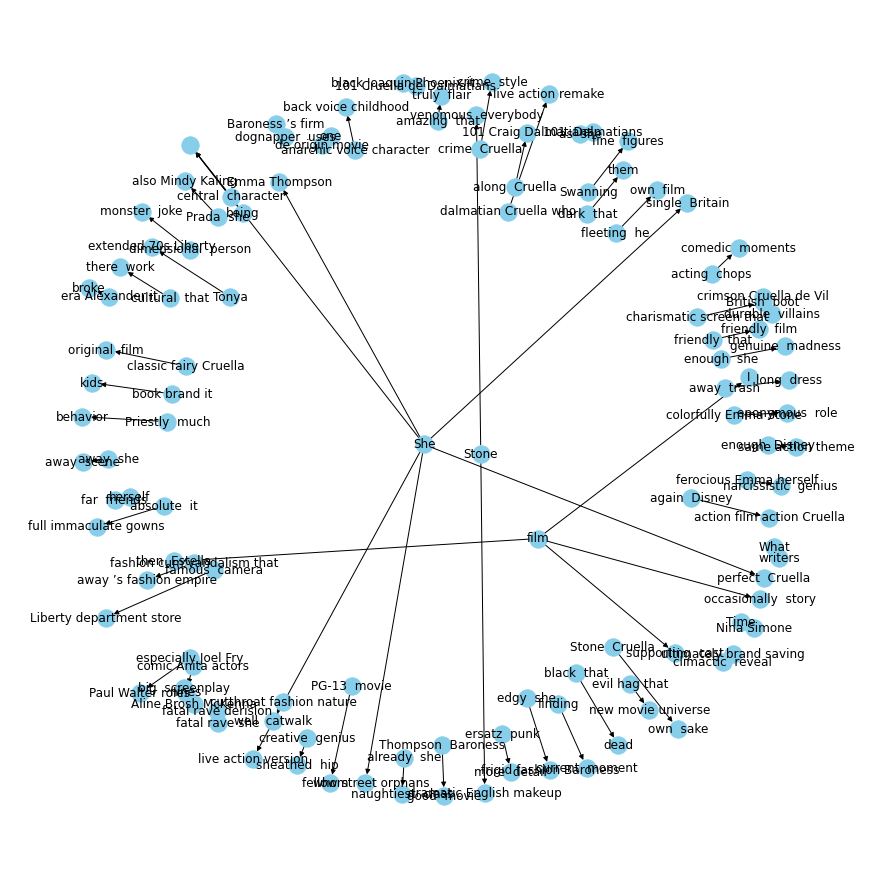

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[134:201], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

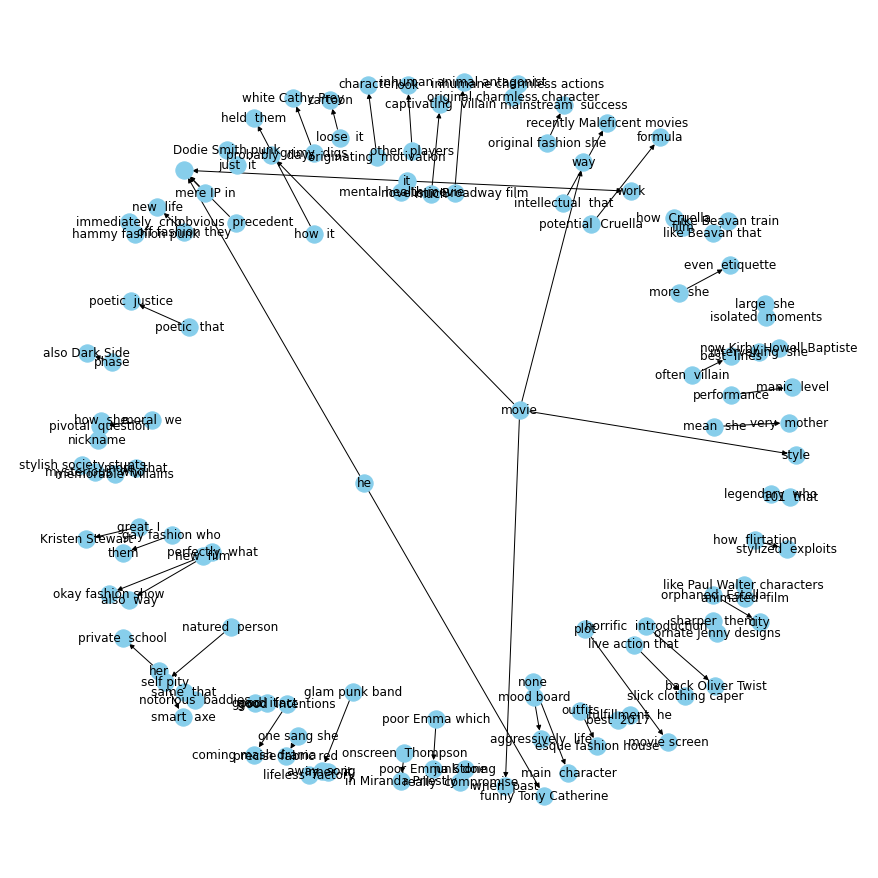

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[201:], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

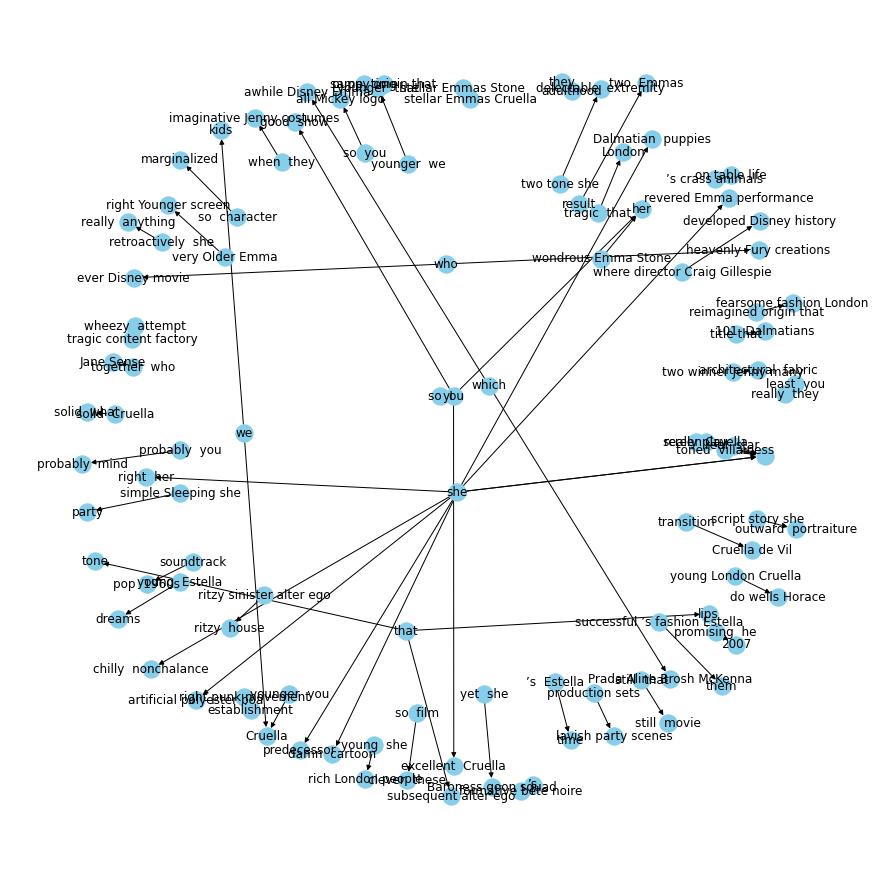

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
len(kg_df)

268

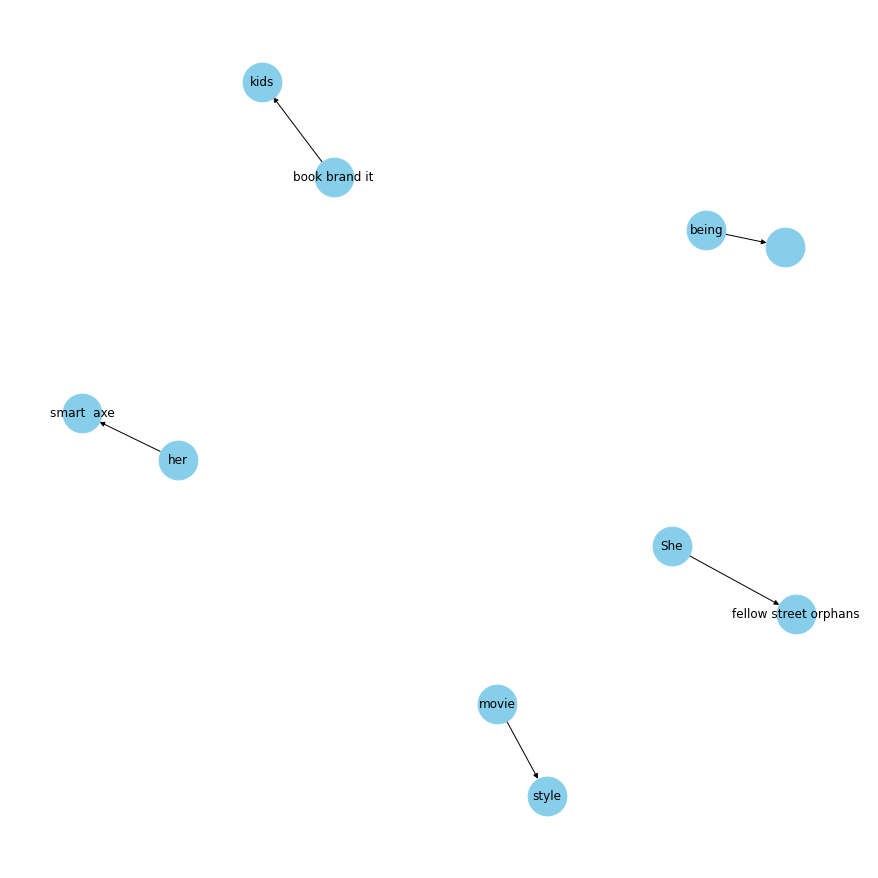

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

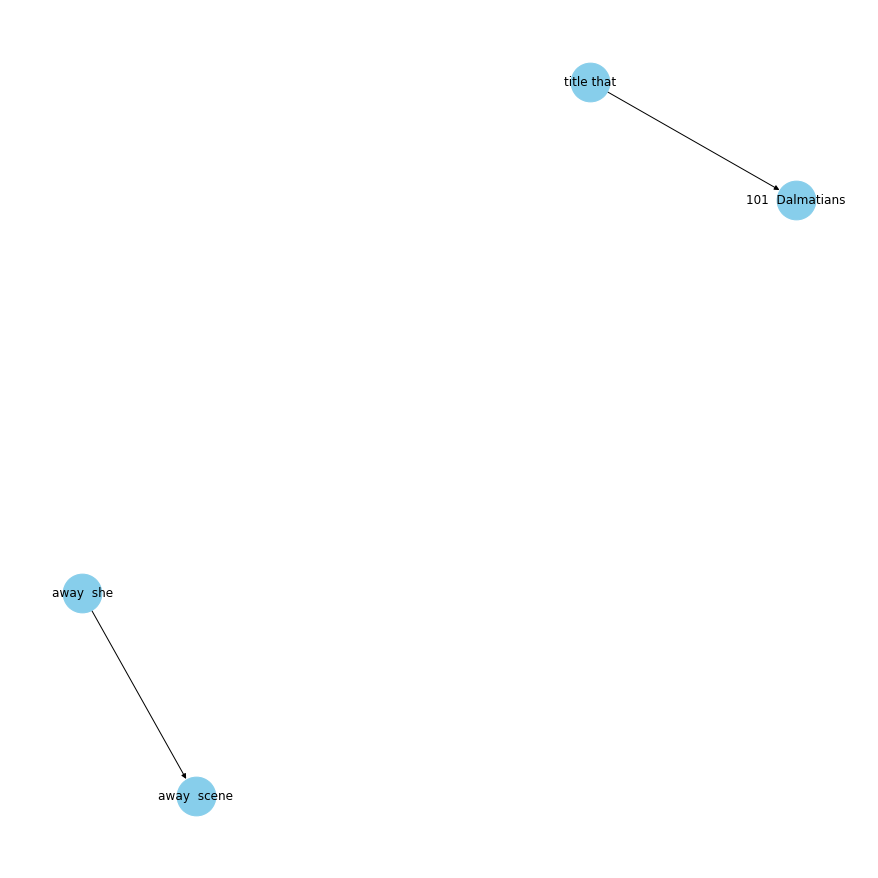

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

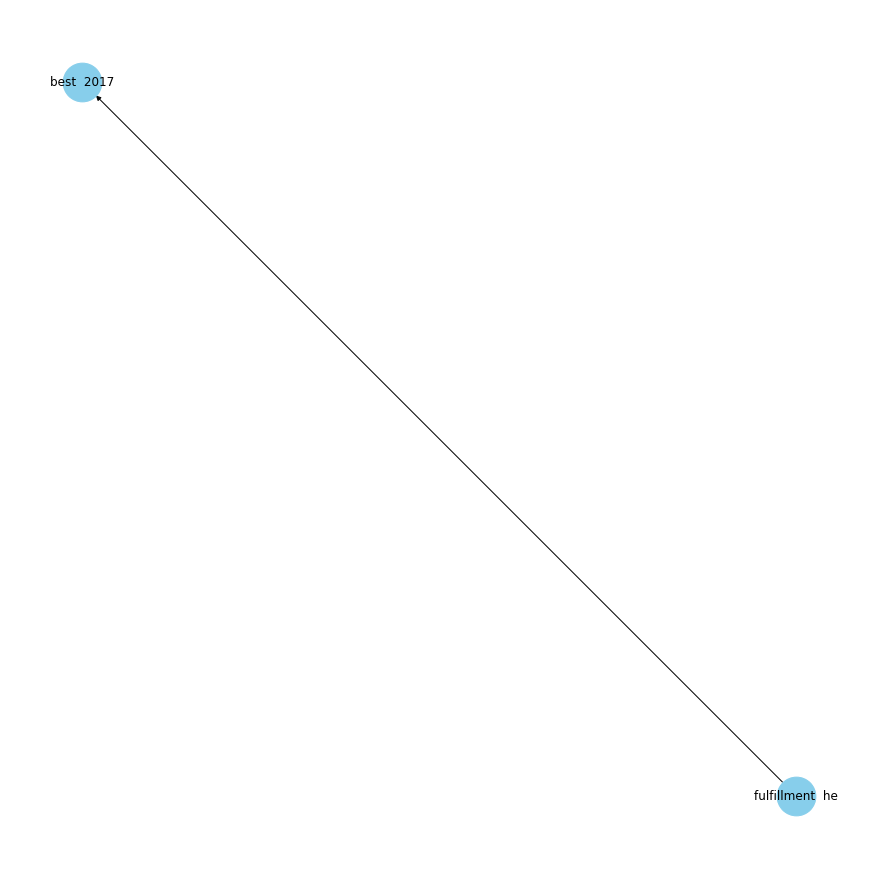

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

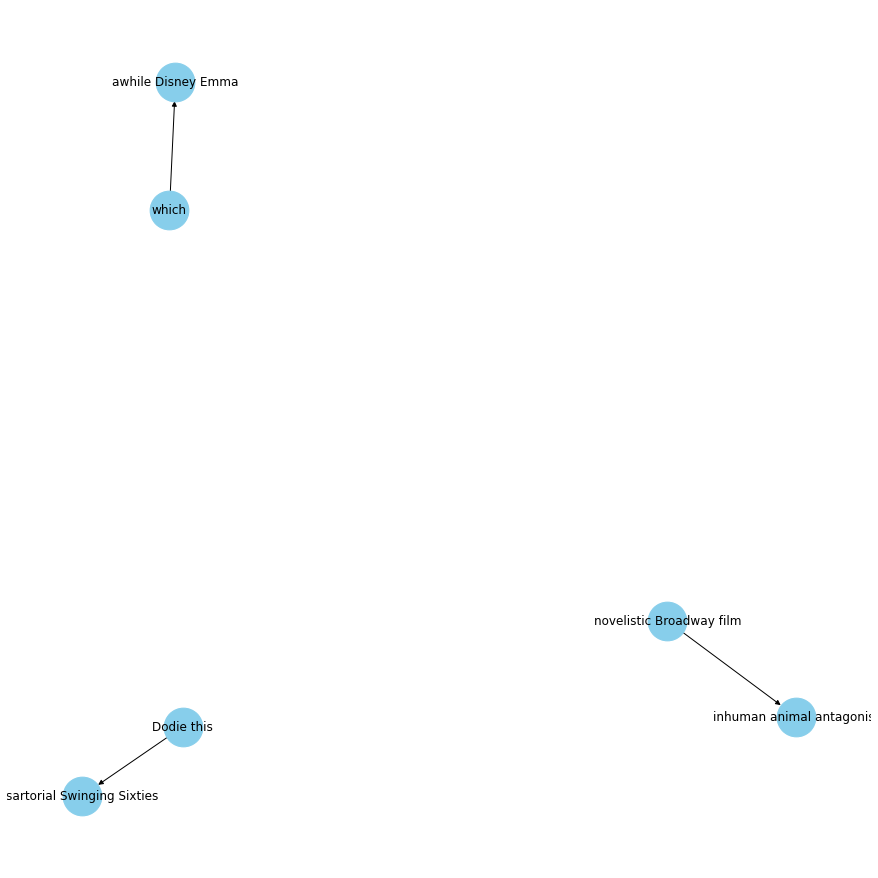

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

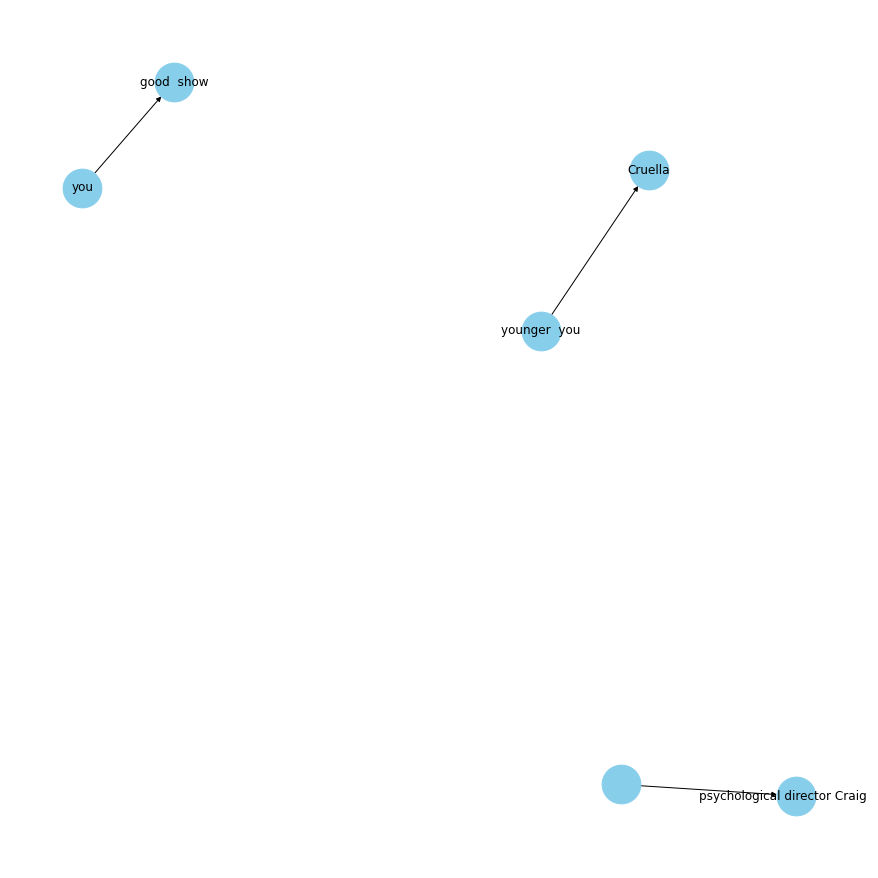

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

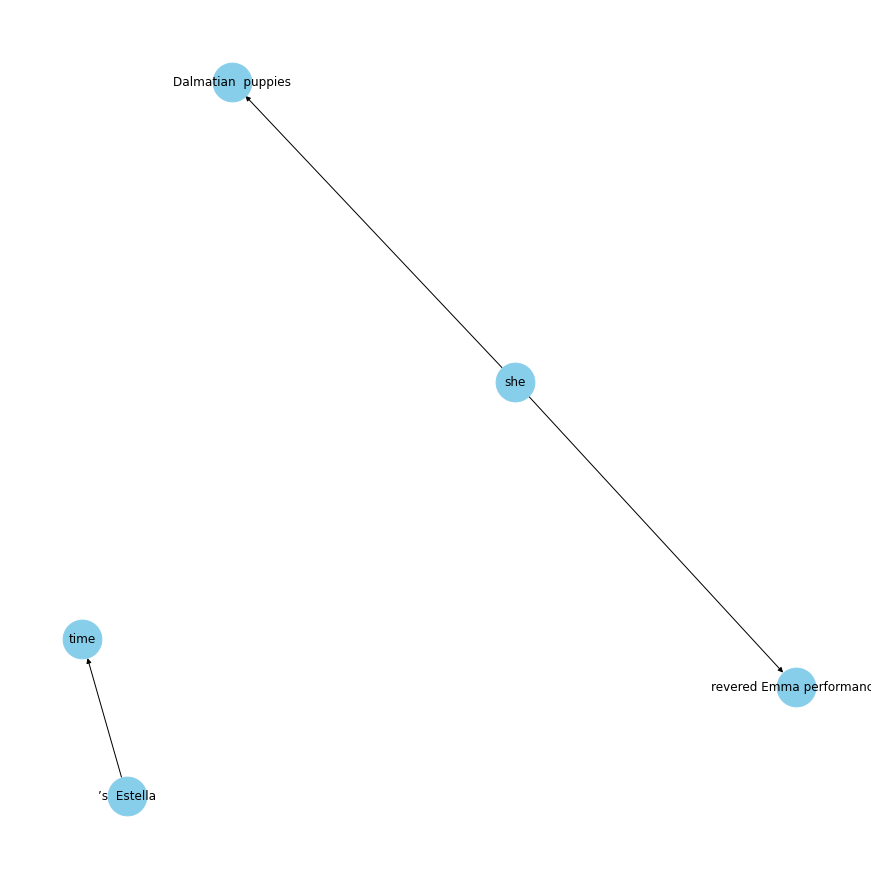

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="wants"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

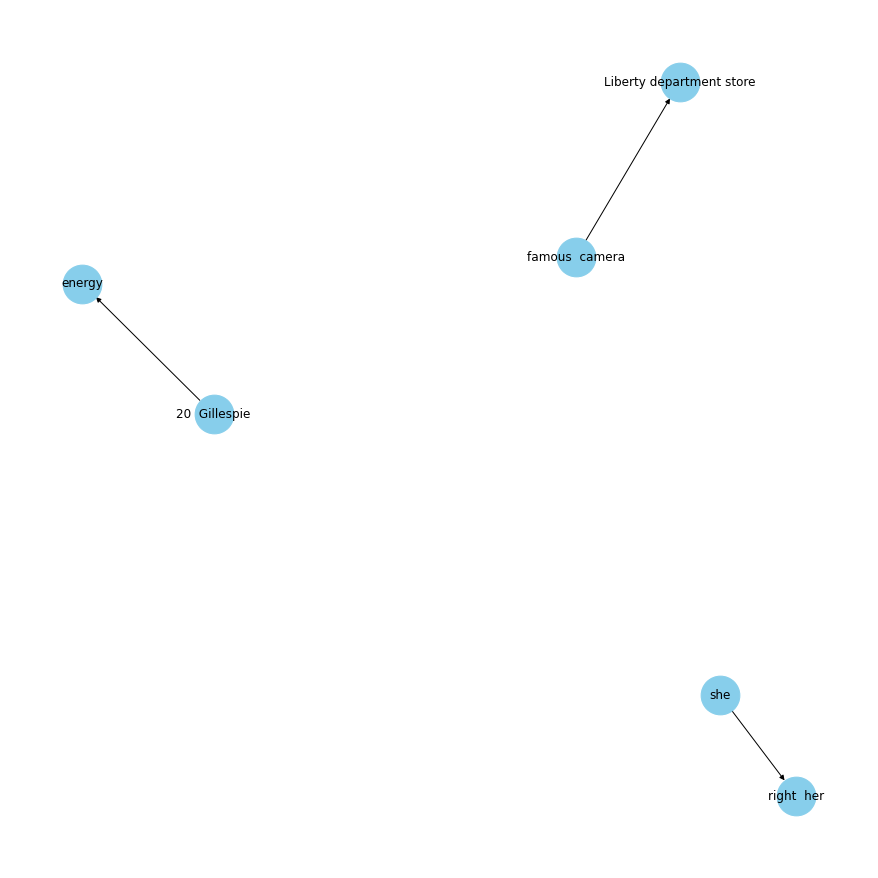

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="keeps"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

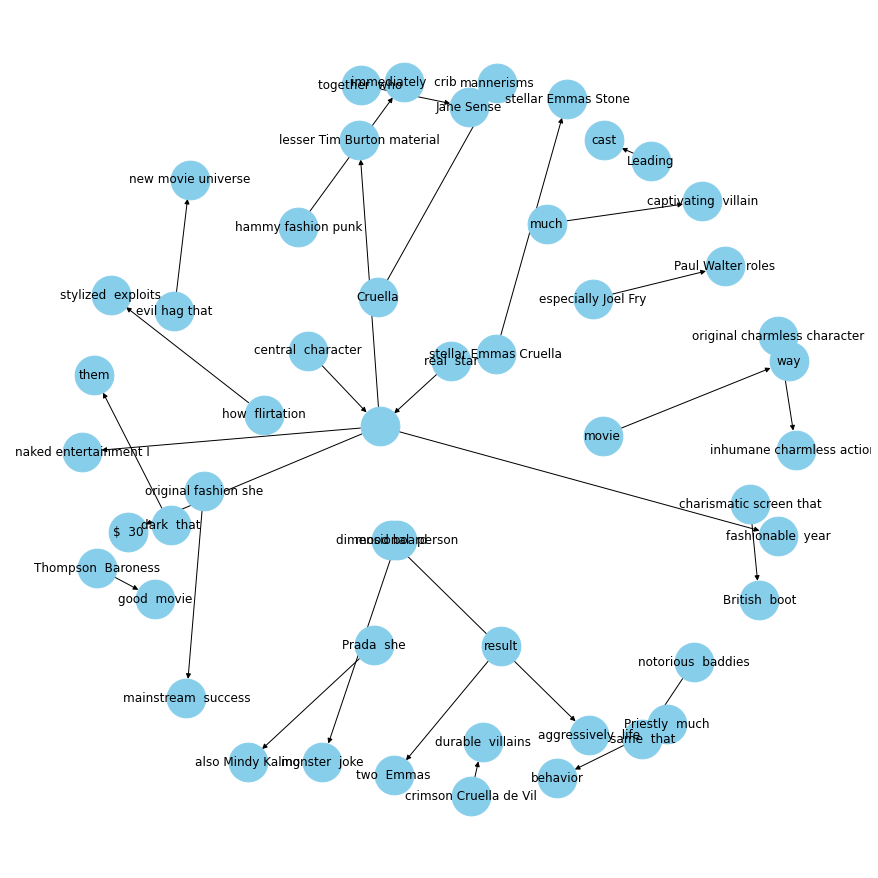

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="is"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

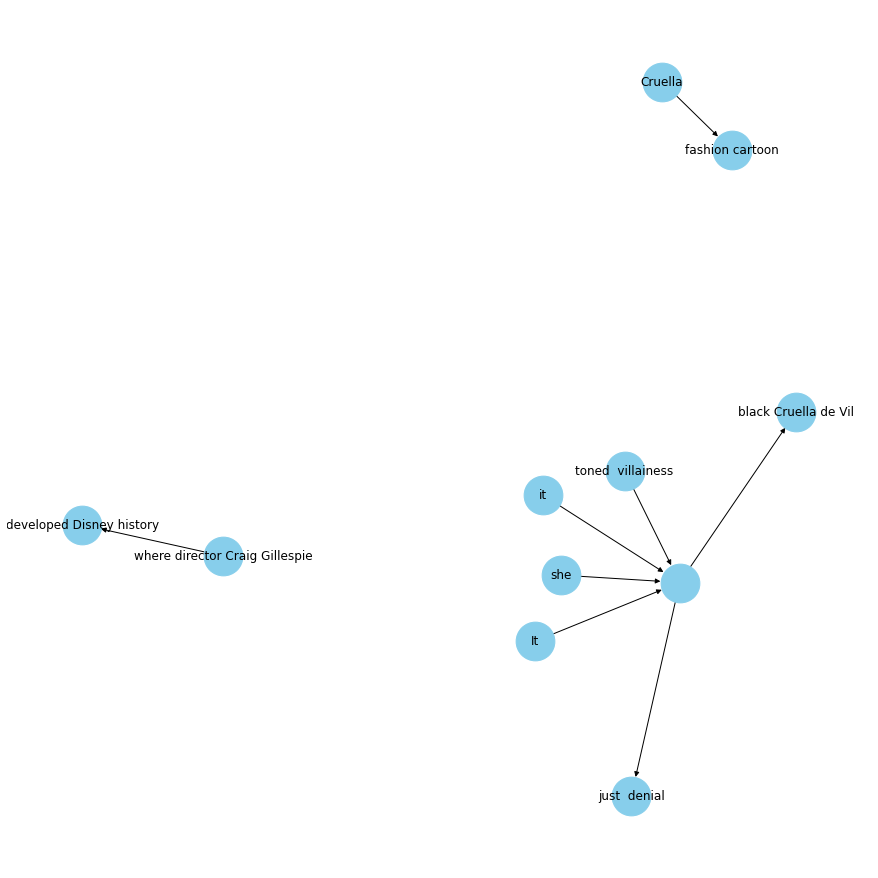

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="was"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

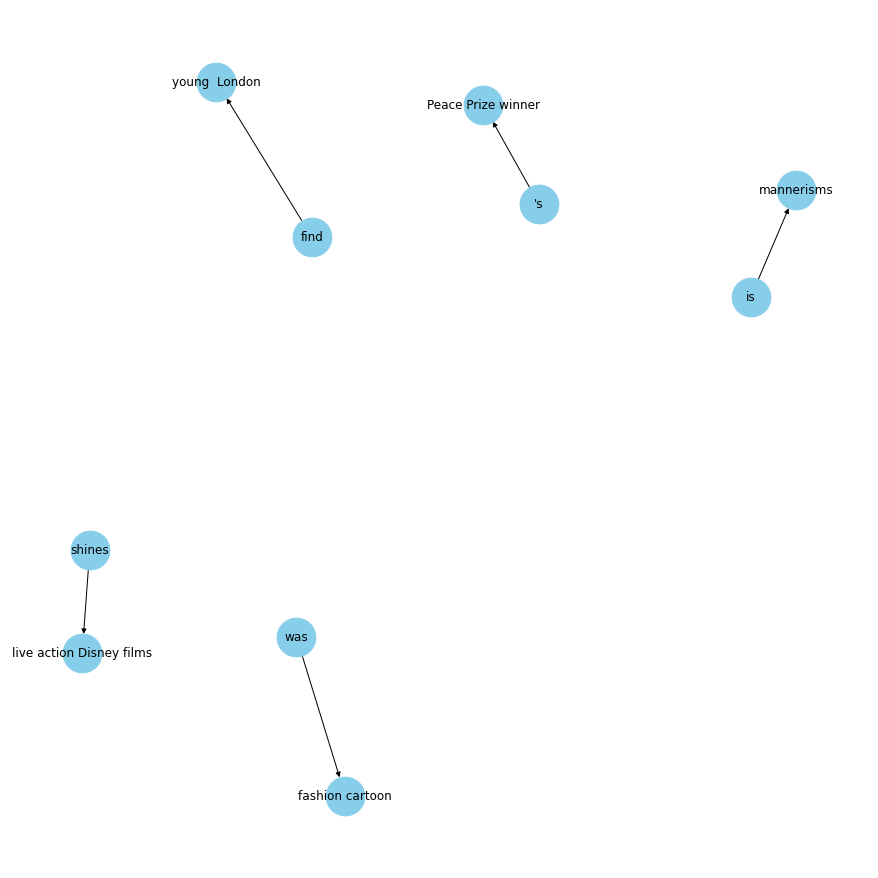

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="Cruella"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Entity pair extraction from corpus

In [ ]:
!python -m spacy download en_core_web_lg

2021-08-03 22:31:30.012774: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
     |████████████████████████████████| 777.1 MB 15 kB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [ ]:
nlp = spacy.load('en_core_web_lg')

## Create one big blog of text for knowledge graph generation

In [ ]:
corpusJoined = ' '.join([x for x in data['Text']]).split('.')

In [ ]:
corpusJoined[:5]

['Canadian director Denis Villeneuve made one great film in 2013 called Prisoners',
 ' Provocative, enthralling and beautifully composed, it peeled away the layers of a complex mystery story with a surprise in every frame',
 ' I was an instant fan',
 ' This promising relationship has come to a heartbreaking finale with every film since',
 ' Enemy and Sicario were unspeakable disasters, and Arrival, the director’s latest exercise in pretentious poopery, gives me every reason to believe I have parted company with Denis Villeneuve for good']

## Function for entity extraction

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 6715/6715 [01:27<00:00, 76.75it/s]


In [ ]:
entity_pairs[:5]

[['Canadian director Denis Villeneuve', 'called  Prisoners'],
 ['beautifully  it', 'complex mystery frame'],
 ['I', ''],
 ['promising  relationship', 'heartbreaking  film'],
 ['pretentious  I', 'Denis good']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         816
           406
’s         279
's         177
are        159
has        103
was         88
have        70
be          63
made        33
plays       33
makes       33
seems       30
takes       30
been        26
seem        24
gives       23
becomes     23
\n\n        22
had         22
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
kg_df.head(100)

,source,target,edge
0,Canadian director Denis Villeneuve,called Prisoners,made
1,beautifully it,complex mystery frame,peeled
2,I,,was
3,promising relationship,heartbreaking film,come to
4,pretentious I,Denis good,were unspeakable
...,...,...,...
95,language,real two,thinks
96,two people,together end,end
97,staid we,staid tropes,set
98,Arrival,trying times,is


In [ ]:
print(pd.Series(source).value_counts()[:20])

         566
it       154
It       146
that     124
he       107
I        101
they      86
who       66
He        65
you       64
we        53
she       51
They      45
film      39
movie     35
She       34
This      32
We        30
You       25
which     25
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

             767
it            94
them          48
you           28
him           27
film          27
movie         22
me            18
that          15
what          15
her           14
time          11
house         10
world         10
us            10
this           9
family         9
something      9
one            8
life           8
dtype: int64


## Create a directed-graph from the Dataframe

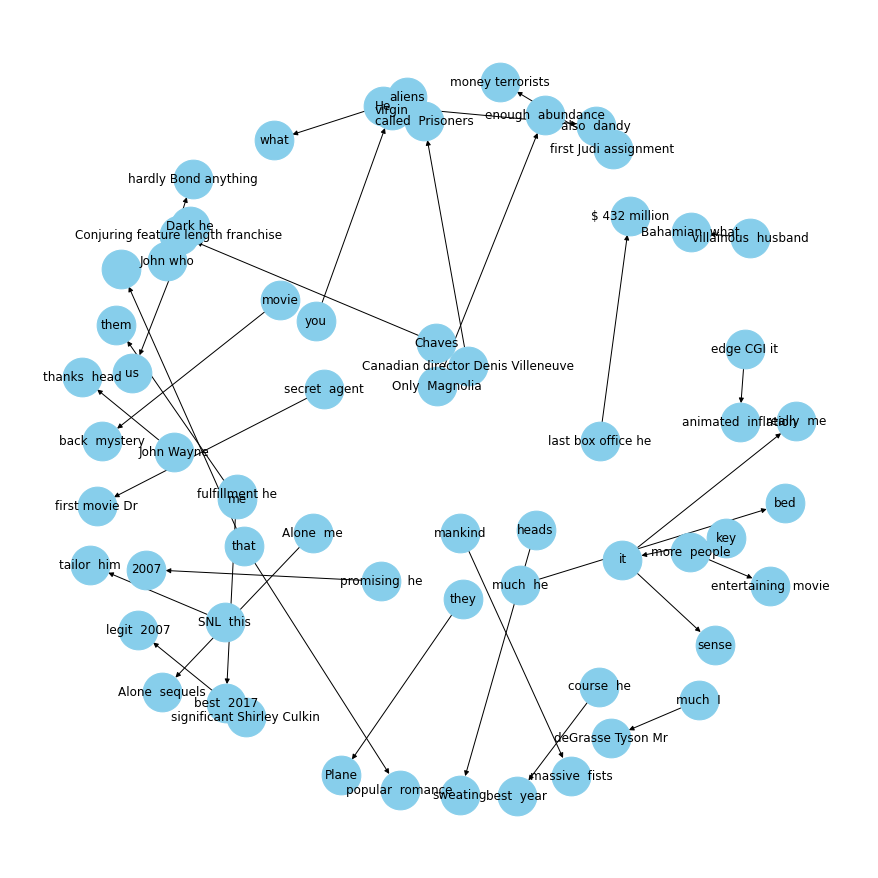

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

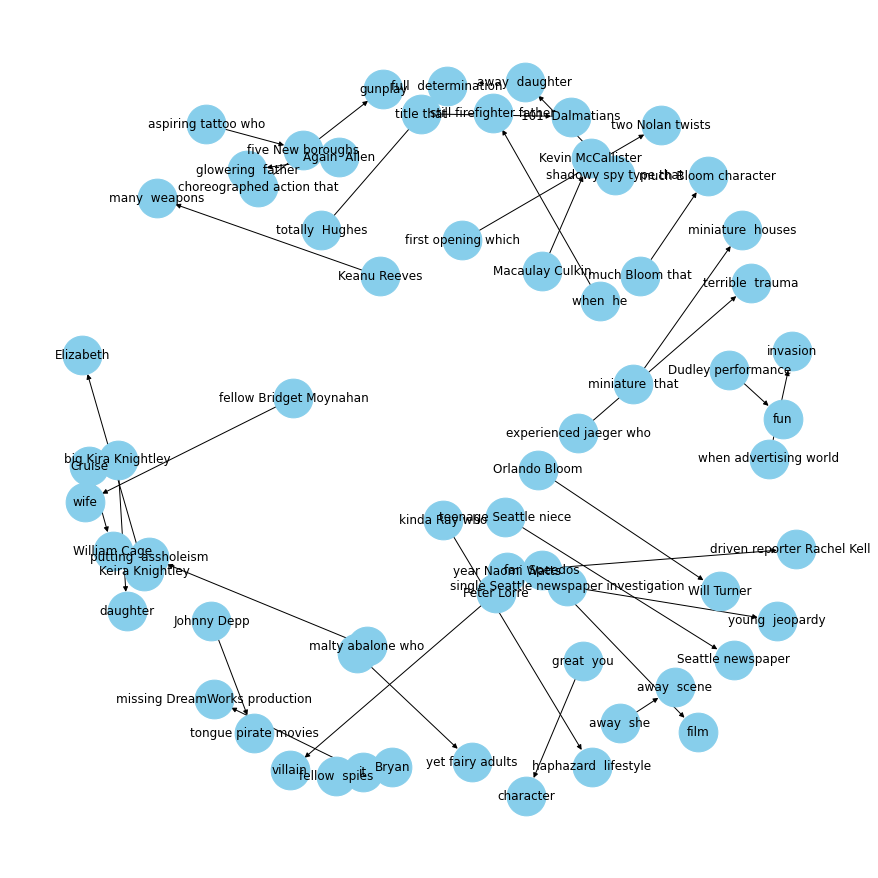

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

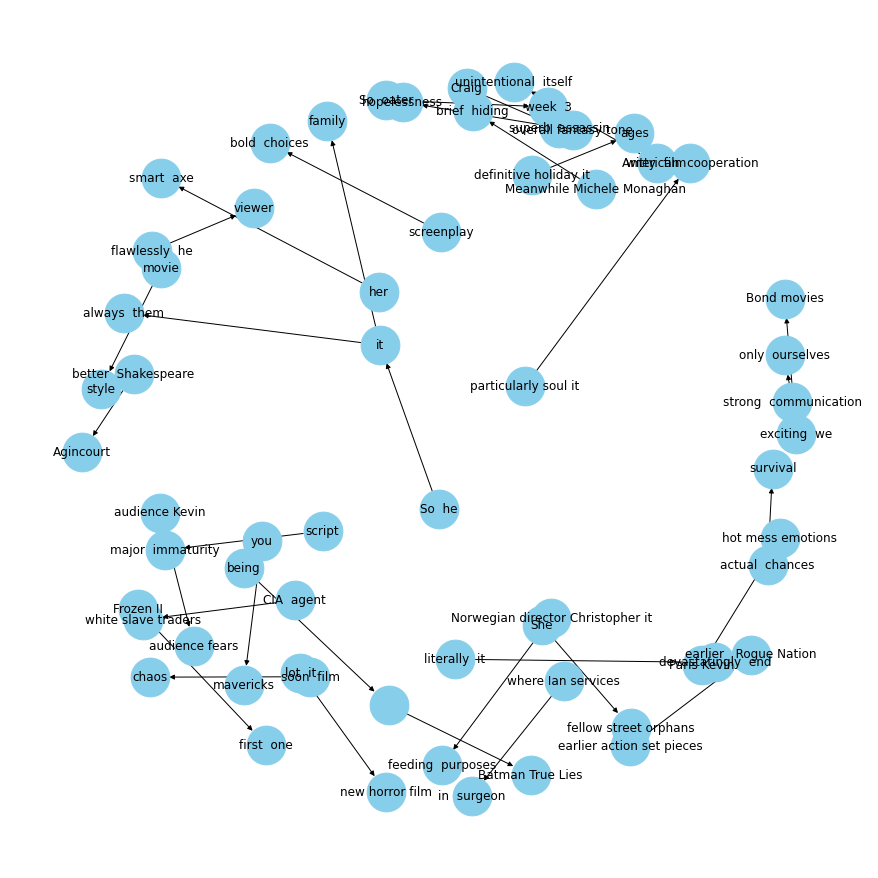

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

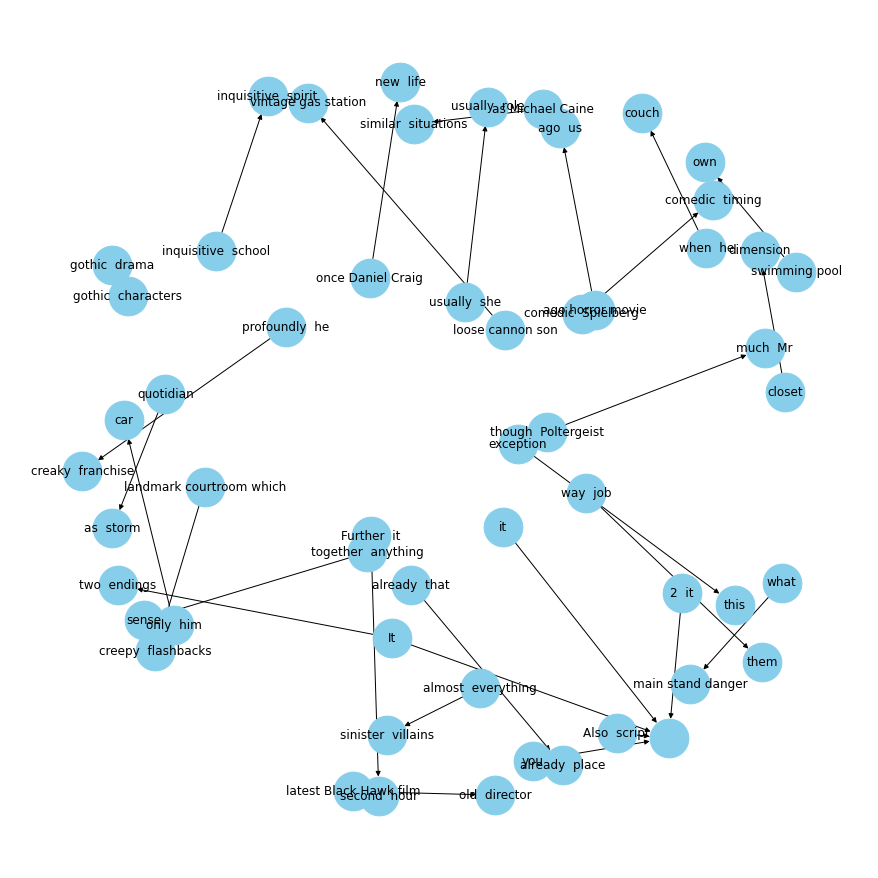

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="seems"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

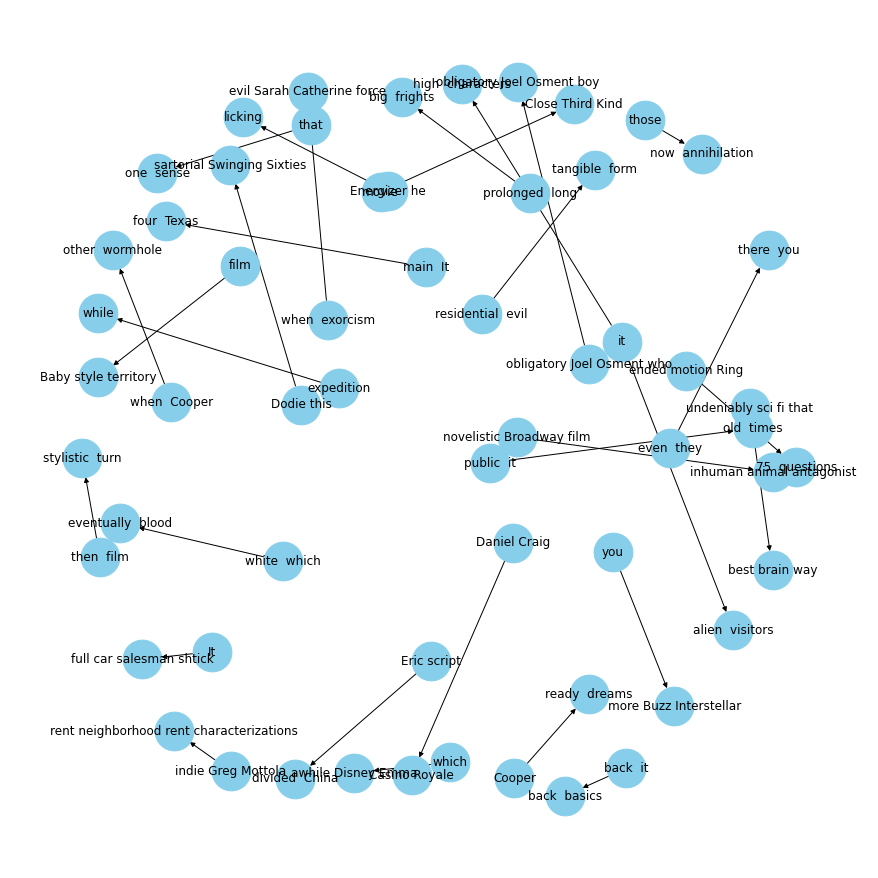

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

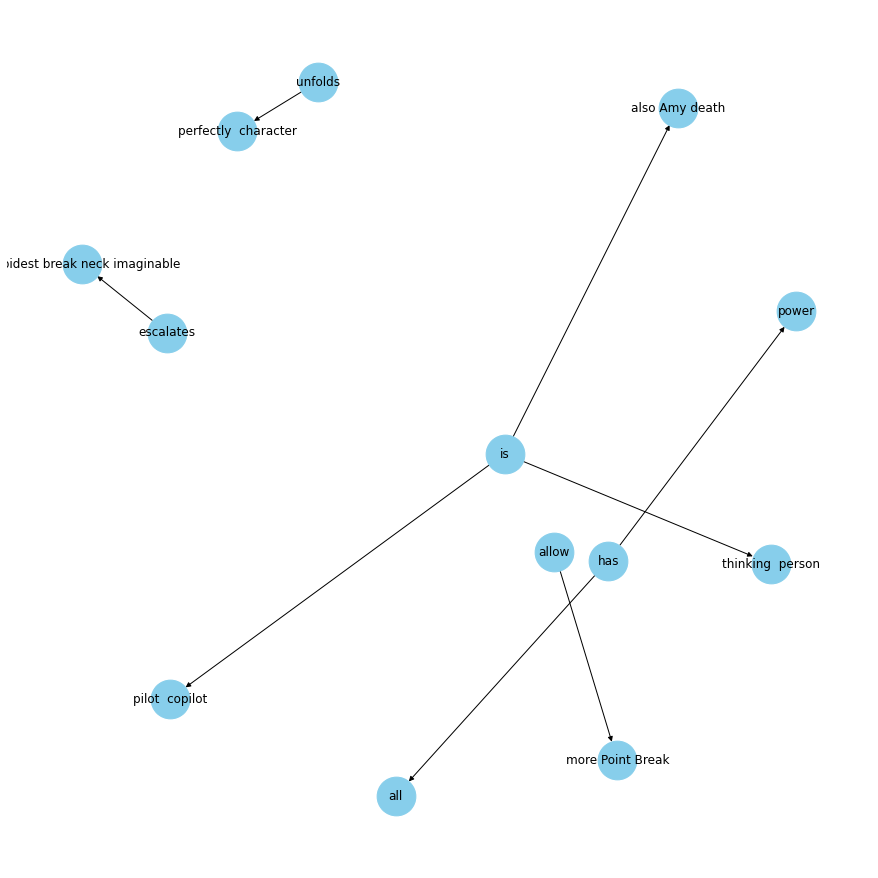

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="story"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation - SINGLE MOVIE

In [ ]:
data['Text'][160:170]

160    ﻿The new film Cruella (in theaters and on Disn...
161    ﻿I never expected to be able to use Disney and...
162    ﻿Cruella De Vil is one of Disney's most iconic...
163    ﻿In 1996, Glenn Close glided onto screens in f...
164    ﻿Think of the delicious new movie “Cruella” as...
165    ﻿In the original, animated 101 Dalmatians, the...
166    ﻿There's an excellent Emma in "Cruella," but i...
167    ﻿With her shock of black-and-white hair and cr...
168    ﻿Everything that’s good about “Cruella” can’t ...
169    ﻿Craig Gillespie’s Cruella explores the backst...
Name: Text, dtype: object

In [ ]:
corpusJoined = ' '.join([x for x in data['Text'][160:170]]).split('.')

In [ ]:
corpusJoined[:5]

['\ufeffThe new film Cruella (in theaters and on Disney+, May 28) is going okay until the fashion show',
 ' Young Cruella de Vil (Emma Stone) is trying to get revenge against a cruel couture designer, the Baroness (Emma Thompson), by staging a guerrilla runway show to upstage the Baroness’s own',
 ' It’s 1970s London, and Cruella and some other models take to the makeshift catwalk in shocking new glam-punk garb while a band thrashes away at a song',
 ' \n\nIt’s at this point that one realizes that the film, directed by I, Tonya’s Craig Gillespie, really is trying to be cool',
 ' And not just cool; it’s crediting a Disney character (inspired by a Dodie Smith character) with the invention of punk']

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 268/268 [00:03<00:00, 75.08it/s]


In [ ]:
entity_pairs[:5]

[['new  film', 'May'],
 ['de  Vil', 'cruel guerrilla runway own'],
 ['glam punk band', 'away  song'],
 ['film', 'I'],
 ['just  it', 'Dodie Smith punk']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         29
’s         18
was         9
            9
's          6
makes       4
wants       3
been        3
are         3
gets        3
keeps       3
takes       3
gives       3
becomes     3
’s at       2
have        2
made        2
meant       2
wasted      2
plays       2
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
print(pd.Series(source).value_counts()[:20])

                  17
Cruella           10
It                 8
she                8
She                7
movie              5
film               4
who                3
that               3
it                 3
you                2
which              2
Stone              2
we                 2
All                2
Estella            2
he                 2
fulfillment he     1
soundtrack         1
younger  we        1
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

                             26
them                          3
time                          2
her                           2
one                           2
101  Dalmatians               2
kids                          2
Cruella de Vil                2
Cruella                       2
supporting  cast              1
stellar Emmas Stone           1
inhumane  actions             1
alter  ego                    1
inhuman animal antagonist     1
perfect  Cruella              1
all Mickey logo               1
fatal rave derision           1
inevitable  collision         1
good  show                    1
two  Emmas                    1
dtype: int64


In [ ]:
kg_df.head(100)

## Create a directed-graph from the Dataframe

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

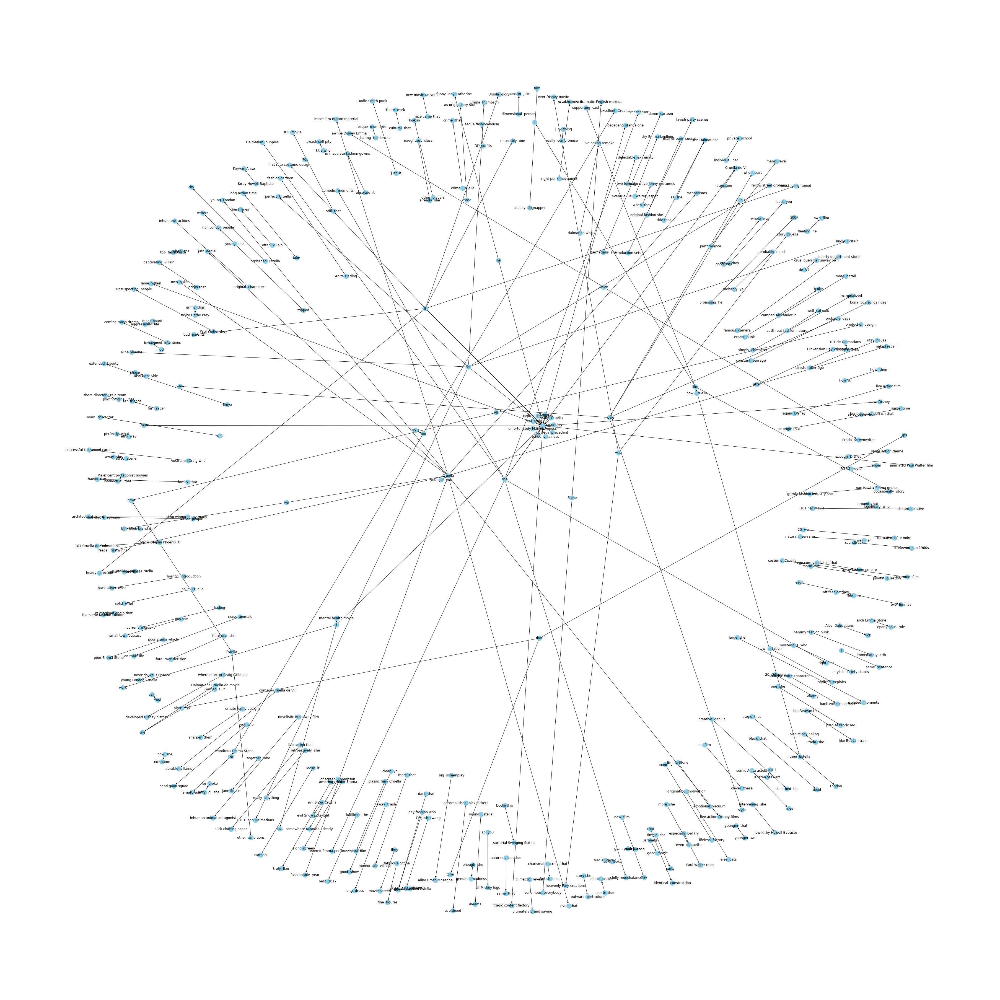

In [ ]:
plt.figure(figsize=(50,50))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
kg_df = kg_df.sort_values('source', ascending=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[0:67], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

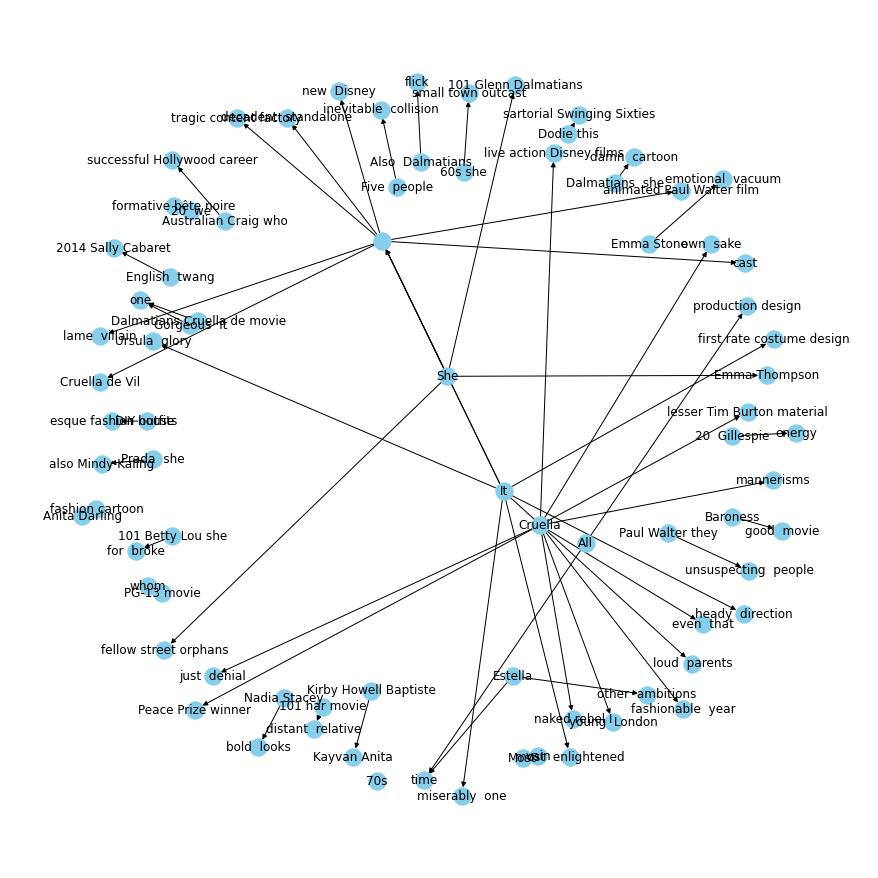

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[67:134], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

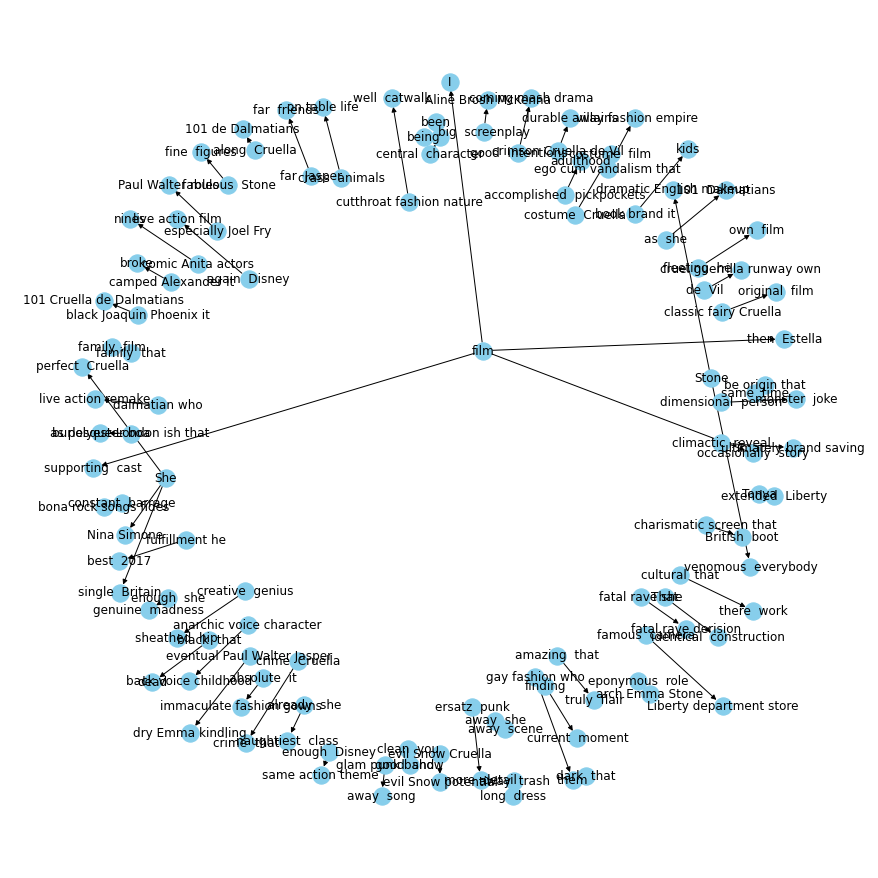

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[134:201], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

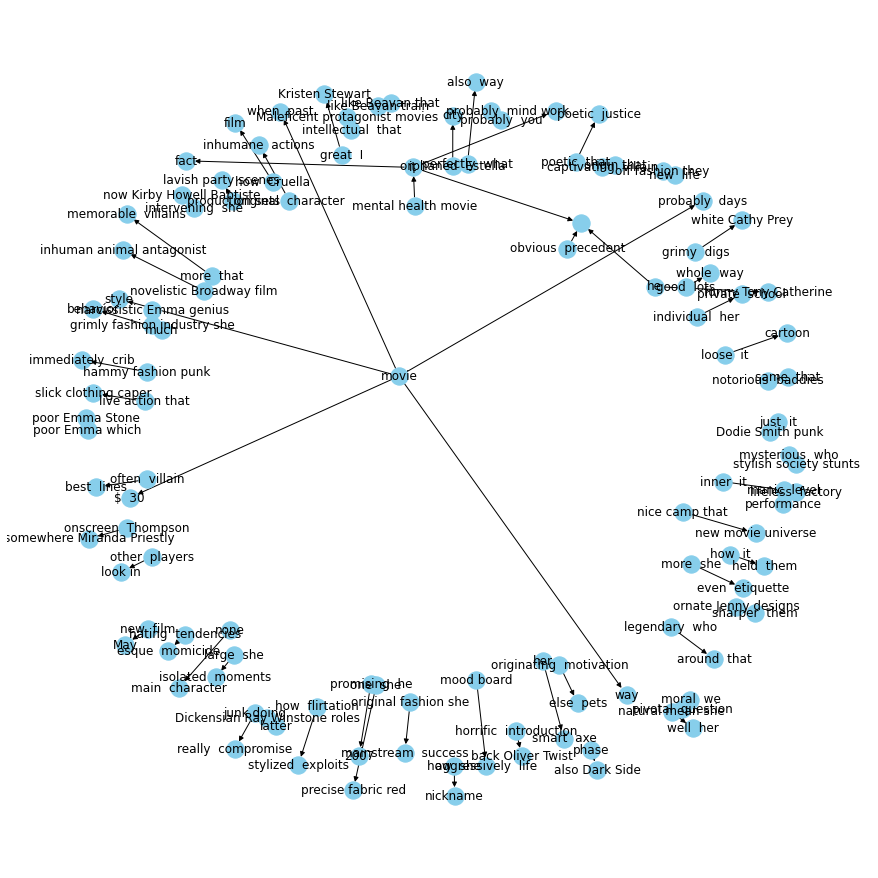

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[201:], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

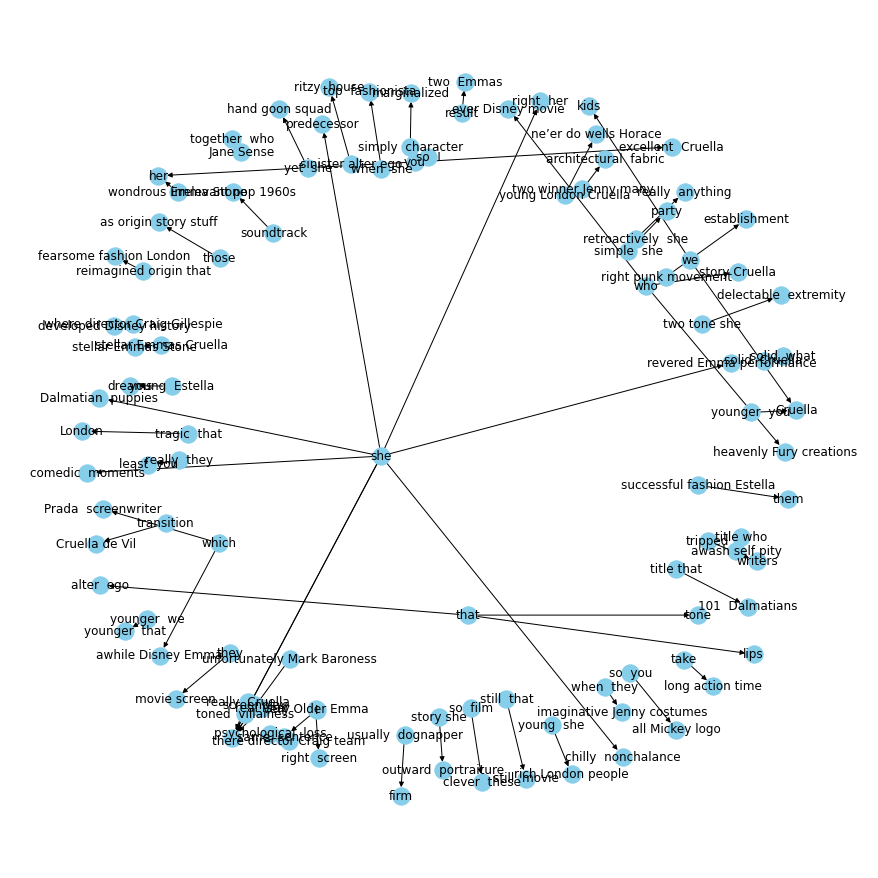

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
len(kg_df)

268

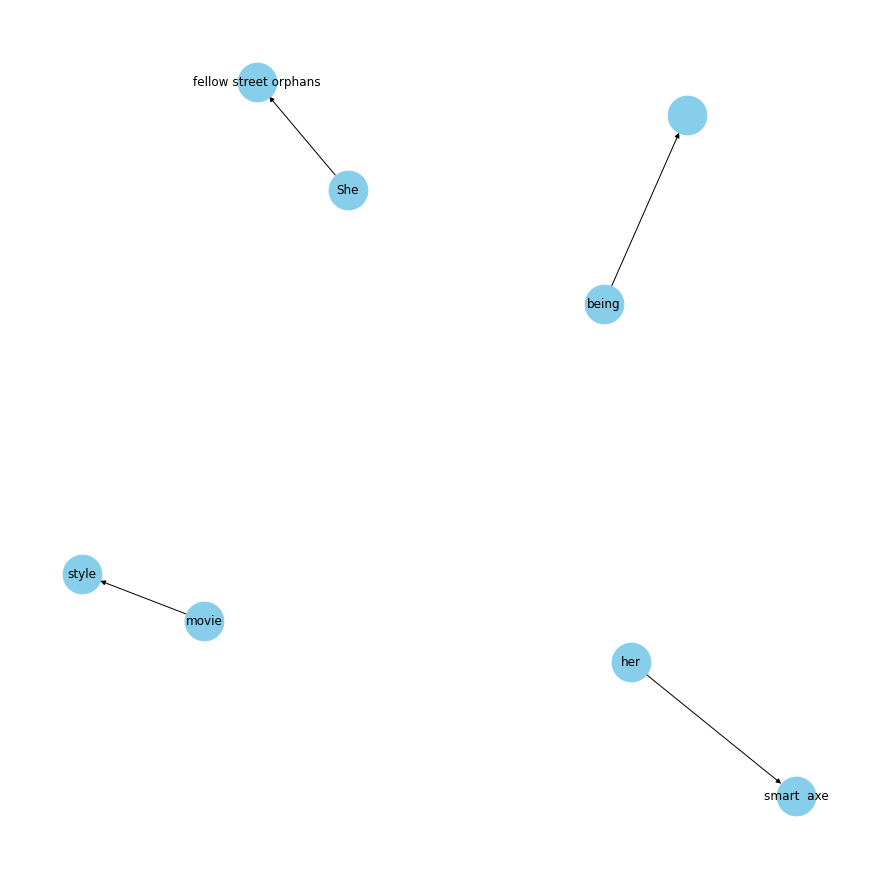

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

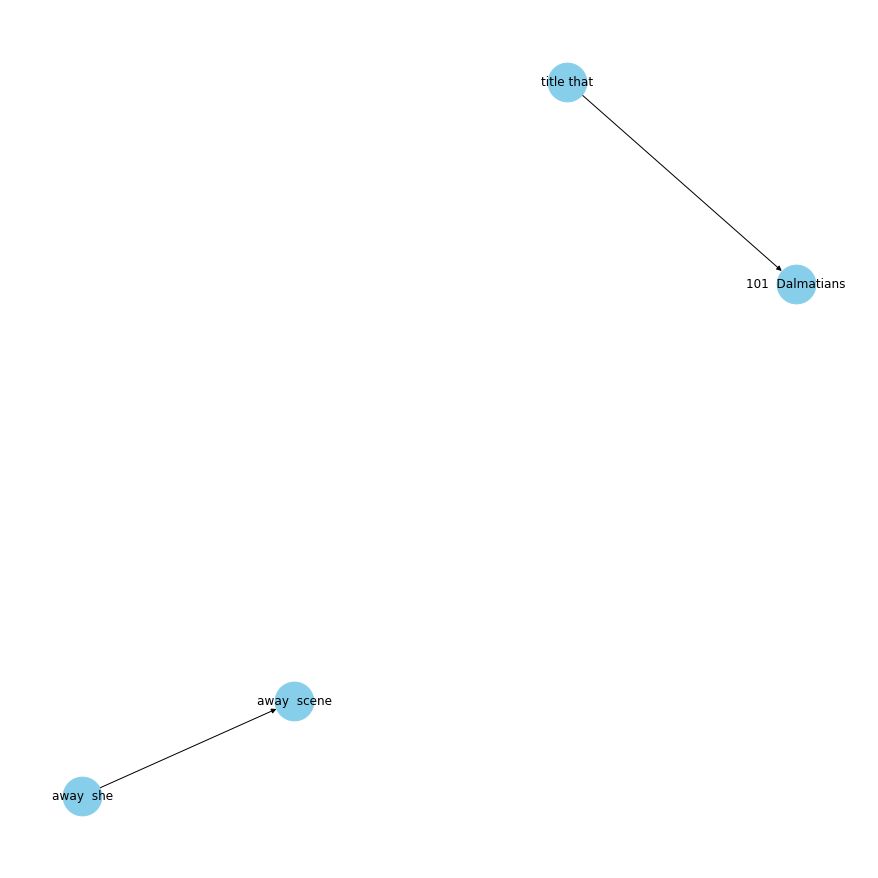

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

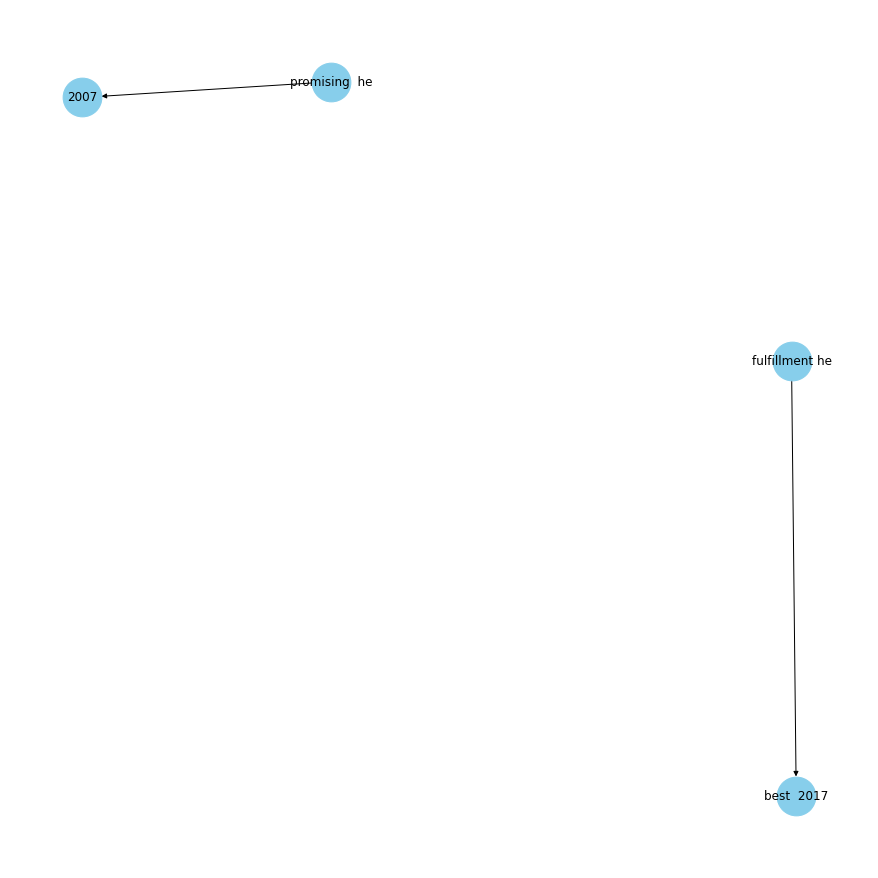

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

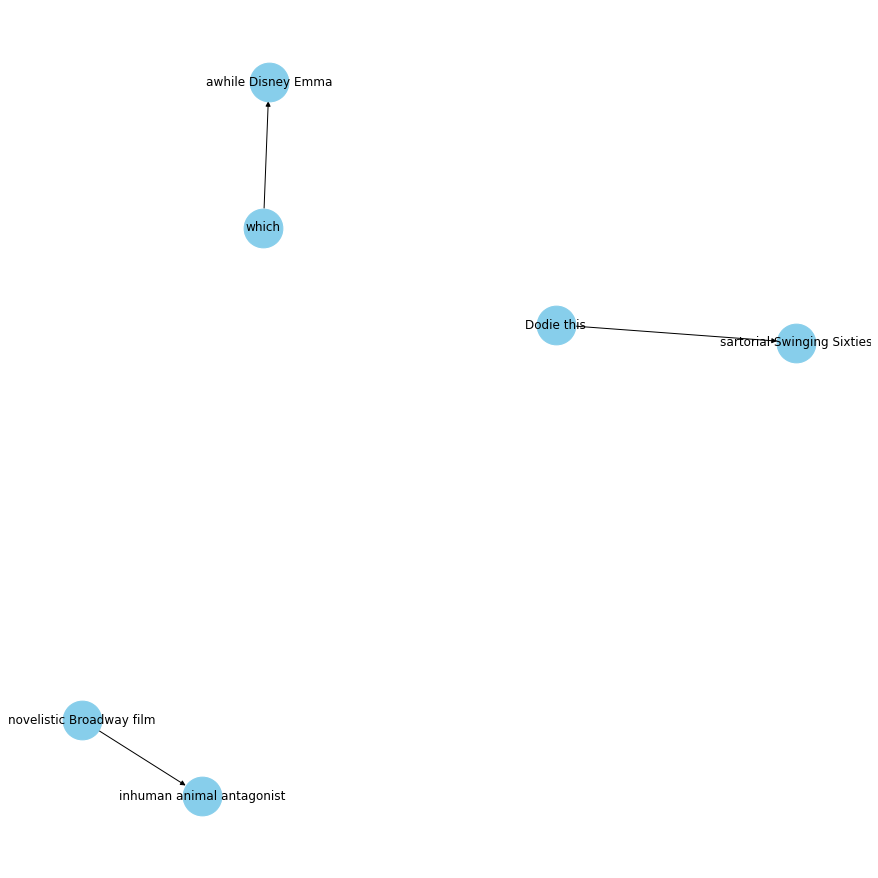

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

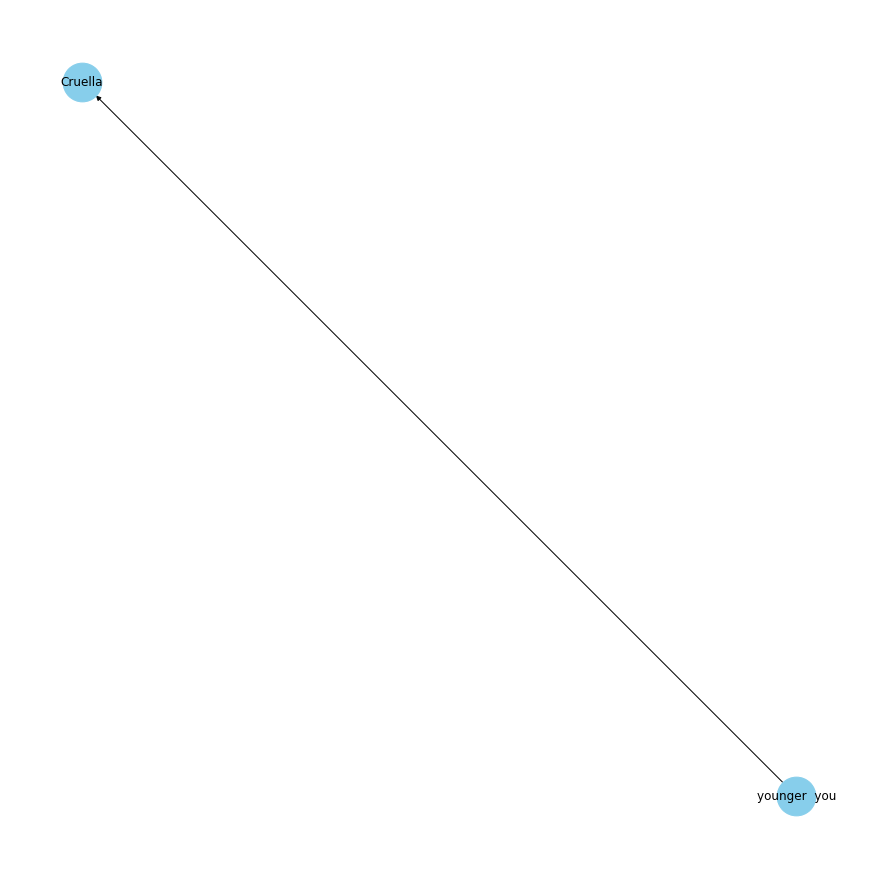

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

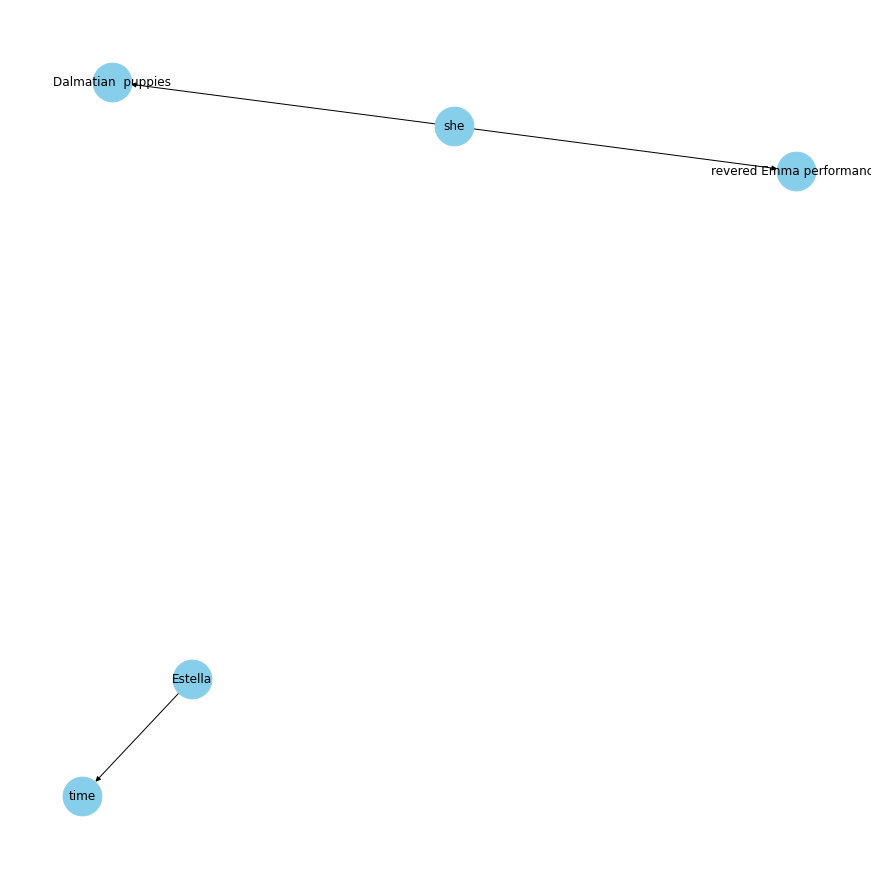

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="wants"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

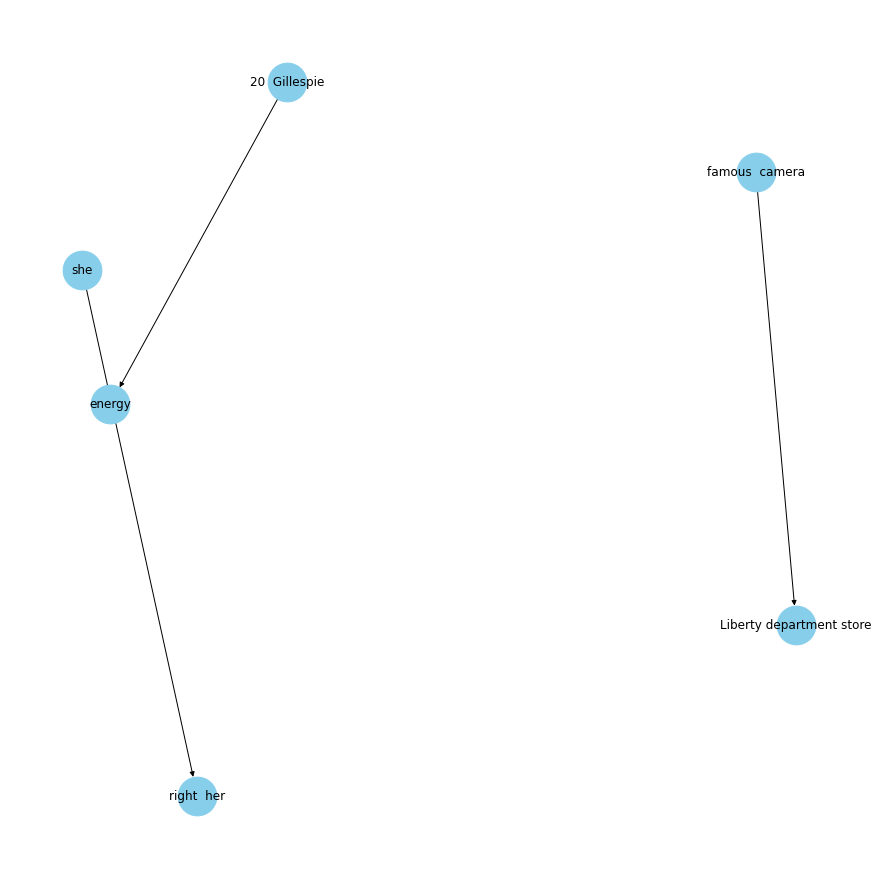

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="keeps"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

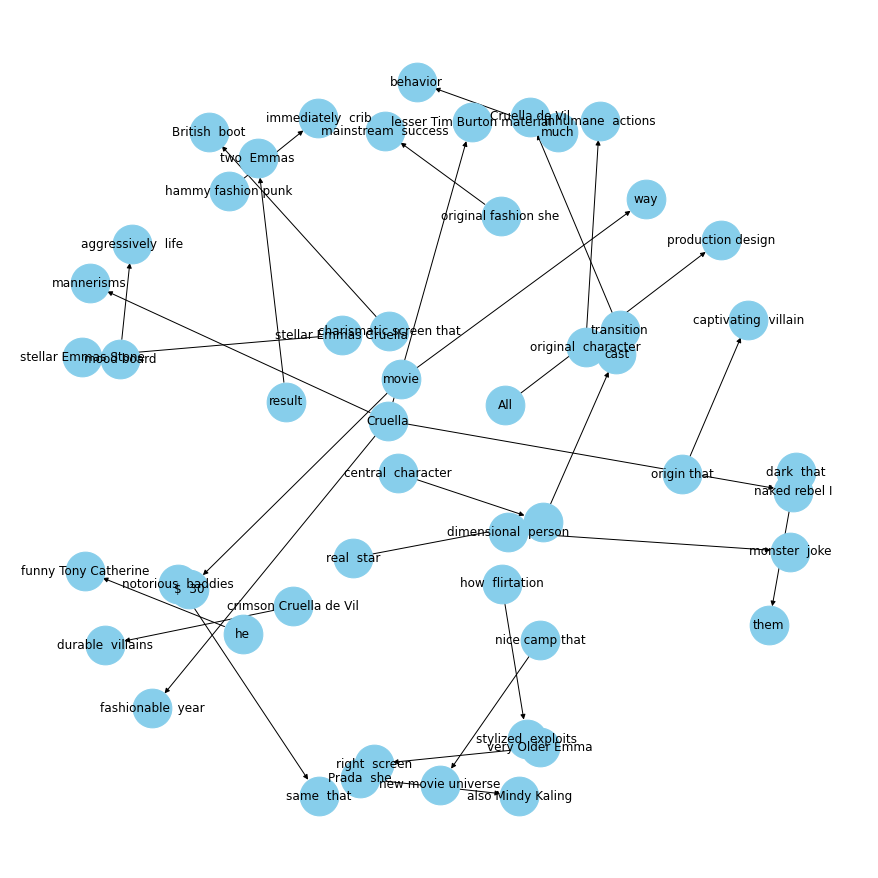

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="is"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

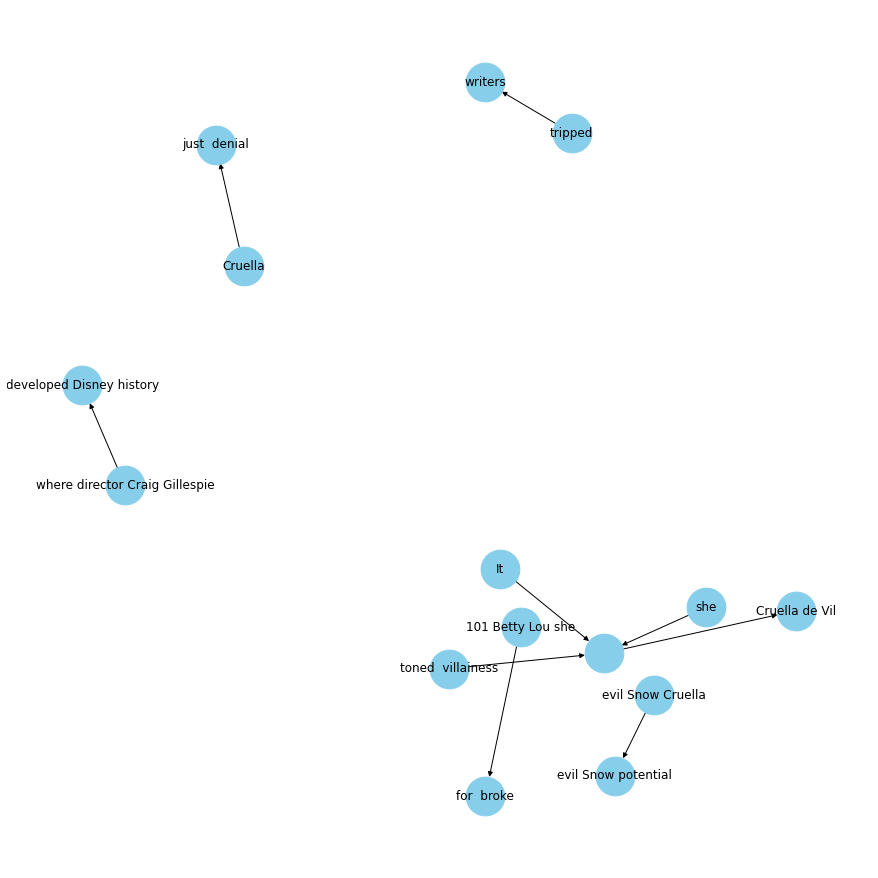

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="was"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

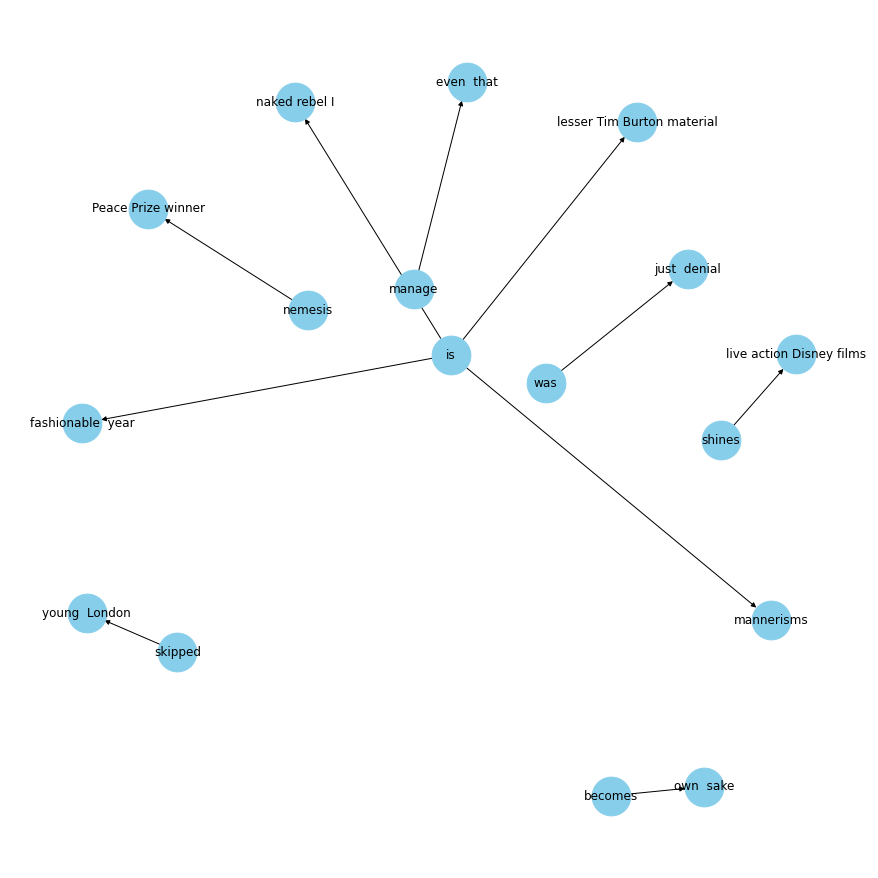

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="Cruella"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

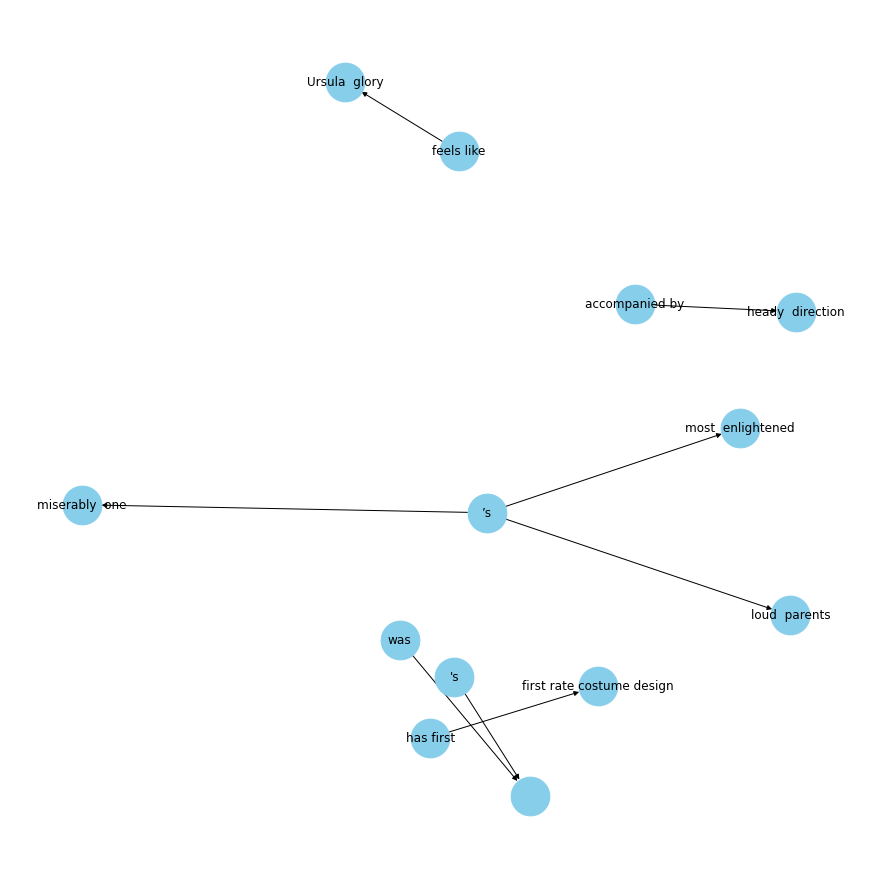

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="It"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

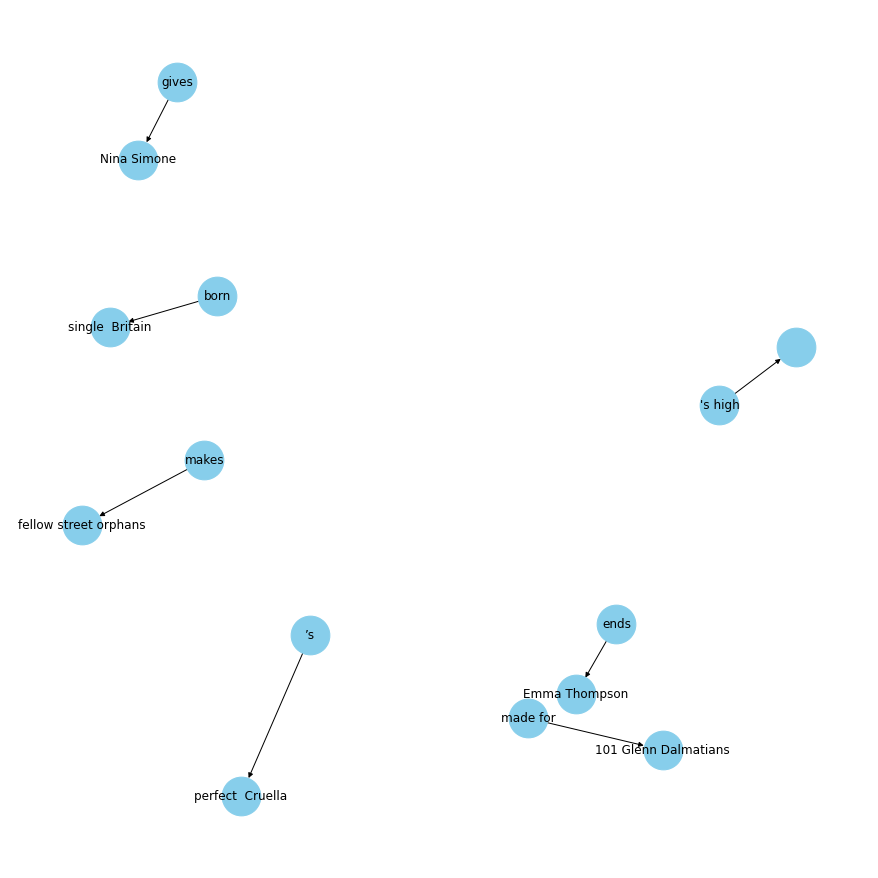

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="She"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

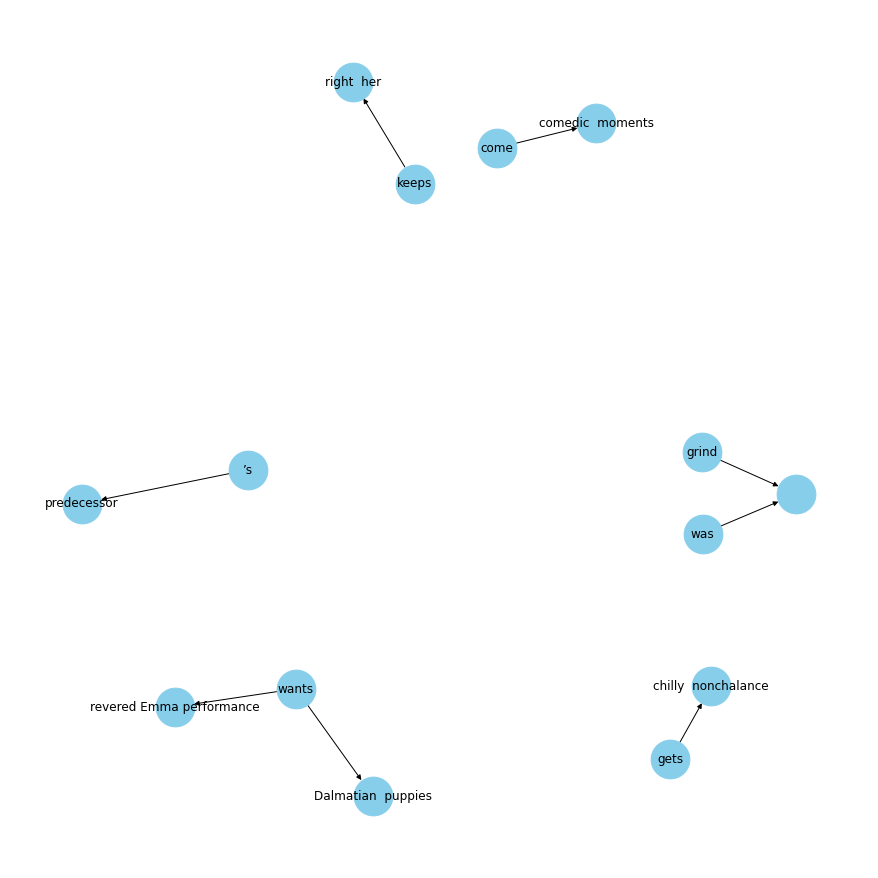

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="she"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

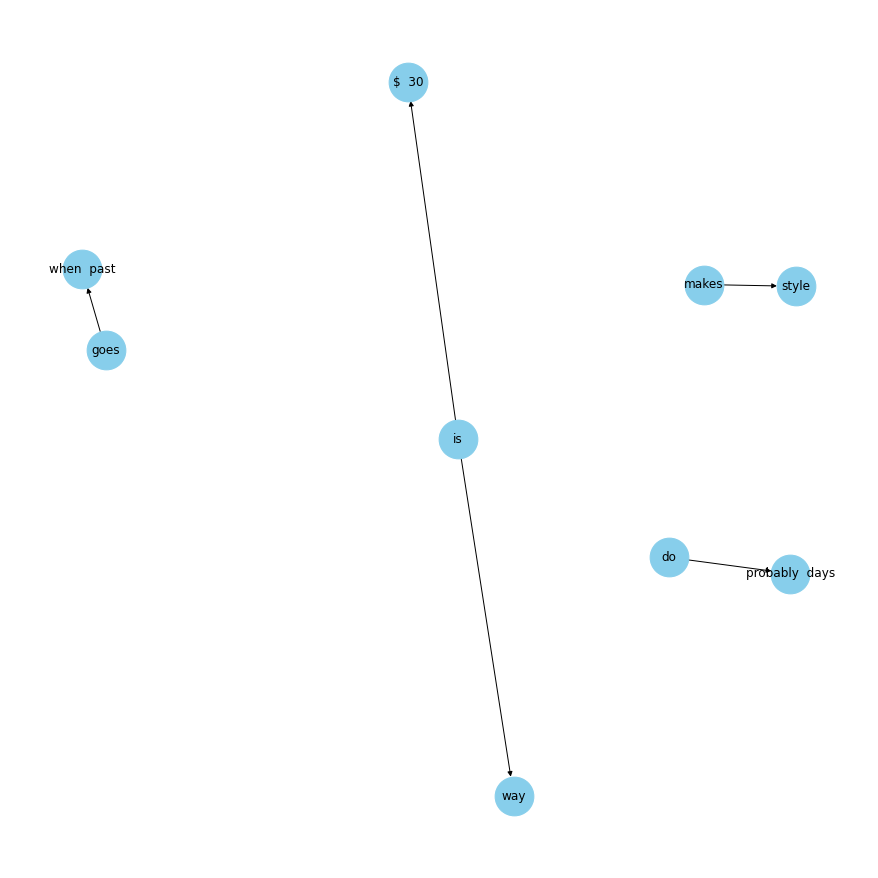

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="movie"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation

In [ ]:
corpusJoined = ' '.join([x for x in text]).split('.')

In [ ]:
corpusJoined[:5]

['Canadian director Denis Villeneuve made one great film in 2013 called Prisoners',
 ' Provocative, enthralling and beautifully composed, it peeled away the layers of a complex mystery story with a surprise in every frame',
 ' I was an instant fan',
 ' This promising relationship has come to a heartbreaking finale with every film since',
 ' Enemy and Sicario were unspeakable disasters, and Arrival, the director’s latest exercise in pretentious poopery, gives me every reason to believe I have parted company with Denis Villeneuve for good']

In [ ]:
#function for entity extraction
def get_entities_2(sent):
  ## chunk 1
  ent1 = ""
  ent2 = ""

  prv_tok_dep = ""    # dependency tag of previous token in the sentence
  prv_tok_text = ""   # previous token in the sentence

  prefix = ""
  modifier = ""

  #############################################################
  
  for tok in nlp(sent):
    ## chunk 2
    # if token is a punctuation mark then move on to the next token
    if tok.dep_ != "punct":
      # check: token is a compound word or not
      if tok.dep_ == "compound":
        prefix = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      
      # check: token is a modifier or not
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      
      ## chunk 3
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      

      ## chunk 4
      if (tok.dep_.find("obj") == True) | (tok.dep_.find("attr")+1 == True):
        ent2 = modifier +" "+ prefix +" "+ tok.text
        
      ## chunk 5  
      # update variables
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
  #############################################################

  return [ent1.strip(), ent2.strip()]

## Function for entity extraction

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities_2(i))

100%|██████████| 6715/6715 [01:23<00:00, 80.23it/s]


In [ ]:
entity_pairs[:5]

[['Canadian director Denis Villeneuve', 'called  Prisoners'],
 ['beautifully  it', 'complex mystery frame'],
 ['I', 'instant  fan'],
 ['promising  relationship', 'heartbreaking  film'],
 ['pretentious  I', 'Denis good']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         816
           406
’s         279
's         177
are        159
has        103
was         88
have        70
be          63
made        33
plays       33
makes       33
seems       30
takes       30
been        26
seem        24
gives       23
becomes     23
\n\n        22
had         22
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
print(pd.Series(source).value_counts()[:20])

         566
it       154
It       146
that     124
he       107
I        101
they      86
who       66
He        65
you       64
we        53
she       51
They      45
film      39
movie     35
She       34
This      32
We        30
You       25
which     25
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

             583
it            92
them          43
film          28
you           27
him           27
movie         22
what          18
me            15
something     15
that          15
her           13
time          10
world         10
life          10
one           10
house         10
story          9
anything       9
family         9
dtype: int64


# EDA on original dataset

In [ ]:
sent_len_df = pd.DataFrame()

In [ ]:
for i in range(len(corpusJoined)):
  temp_len = pd.Series(len(corpusJoined[i].split()))
  sent_len_df = sent_len_df.append(temp_len, ignore_index=True)

In [ ]:
sent_len_df.head()

,0
0,12.0
1,21.0
2,5.0
3,13.0
4,30.0


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f8d9fcbfa90>]],
      dtype=object)

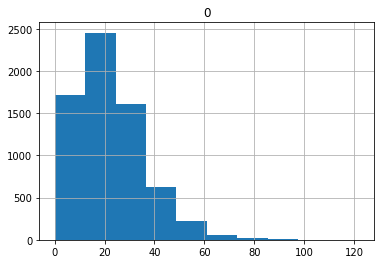

In [ ]:
sent_len_df.hist()

In [ ]:
sent_len_df.describe()

,0
count,6715.000000
mean,22.355175
std,13.901039
min,0.000000
25%,12.000000
50%,20.000000
75%,30.000000
max,122.000000


In [ ]:
ref_data=pd.read_csv('/content/wiki_sentences_v2.csv')

In [ ]:
ref_data['sentence'][0]

'confused and frustrated, connie decides to leave on her own.'

In [ ]:
ref_sent_len_df = pd.DataFrame()

In [ ]:
for i in range(len(ref_data['sentence'])):
  temp_len = pd.Series(len(ref_data['sentence'][i].split()))
  ref_sent_len_df = ref_sent_len_df.append(temp_len, ignore_index=True)

In [ ]:
ref_sent_len_df.head()

,0
0,10.0
1,9.0
2,7.0
3,6.0
4,6.0


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f8d9f7fc0d0>]],
      dtype=object)

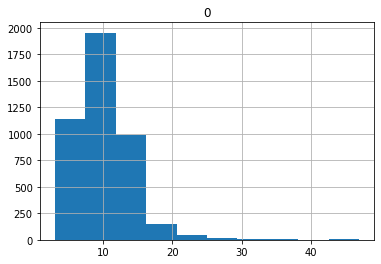

In [ ]:
ref_sent_len_df.hist()

In [ ]:
ref_sent_len_df.describe()

,0
count,4318.000000
mean,10.025243
std,4.023450
min,3.000000
25%,7.000000
50%,9.000000
75%,12.000000
max,47.000000


## Create one big blog of text for knowledge graph generation

In [ ]:
corpusJoined = ' '.join([x for x in data['Text']]).split('.')

In [ ]:
corpusJoined[:5]

['Canadian director Denis Villeneuve made one great film in 2013 called Prisoners',
 ' Provocative, enthralling and beautifully composed, it peeled away the layers of a complex mystery story with a surprise in every frame',
 ' I was an instant fan',
 ' This promising relationship has come to a heartbreaking finale with every film since',
 ' Enemy and Sicario were unspeakable disasters, and Arrival, the director’s latest exercise in pretentious poopery, gives me every reason to believe I have parted company with Denis Villeneuve for good']

In [ ]:
short_sentence = []

In [ ]:
for i in range(len(corpusJoined)):
  if len(corpusJoined[i].split()) <= 10:
    temp_sent = corpusJoined[i]
    short_sentence.append(temp_sent)
  else:
    pass

In [ ]:
corpusJoined = short_sentence

## Function for entity extraction

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 1339/1339 [00:12<00:00, 106.29it/s]


In [ ]:
entity_pairs[:5]

[['I', ''],
 ['Enter Amy Adams', 'linguistics professor'],
 ['', ''],
 ['nothing', ''],
 ['alien  ships', 'her']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

         156
is       138
’s        53
's        42
are       20
was       19
has       15
\n\n      15
be        10
have       8
S          8
e          8
makes      6
see        6
seems      6
\n         6
does       5
A          5
're        5
T          5
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
kg_df.head(100)

,source,target,edge
0,I,,was
1,Enter Amy Adams,linguistics professor,
2,,,S
3,nothing,,\n
4,alien ships,her,believes
...,...,...,...
95,time he,,is
96,He,,'s
97,So they,many,give
98,Q,,


In [ ]:
kg_df.replace('', np.nan, inplace=True)

In [ ]:
import numpy as np


In [ ]:
kg_df.dropna(inplace=True)

In [ ]:
print(pd.Series(source).value_counts()[:20])

         396
It        69
I         36
He        31
it        30
They      29
We        22
that      19
This      19
That      18
he        15
You       15
you       15
they      15
She       13
she        9
film       8
movie      6
we         6
who        6
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

             647
it            23
me             9
you            8
that           8
them           6
this           6
movie          5
film           5
house          4
time           4
Mr             4
what           3
years          3
something      3
Dr             3
her            2
window         2
audience       2
What           2
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

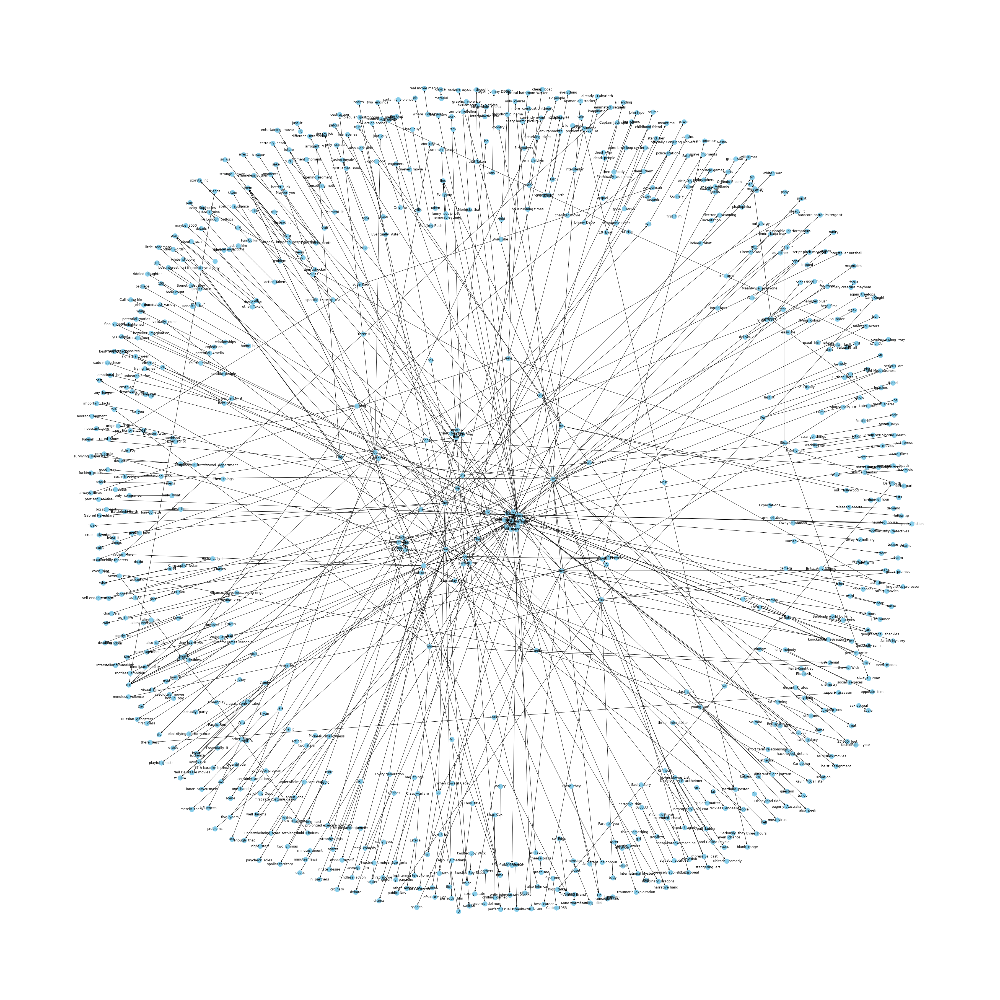

In [ ]:
plt.figure(figsize=(50,50))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

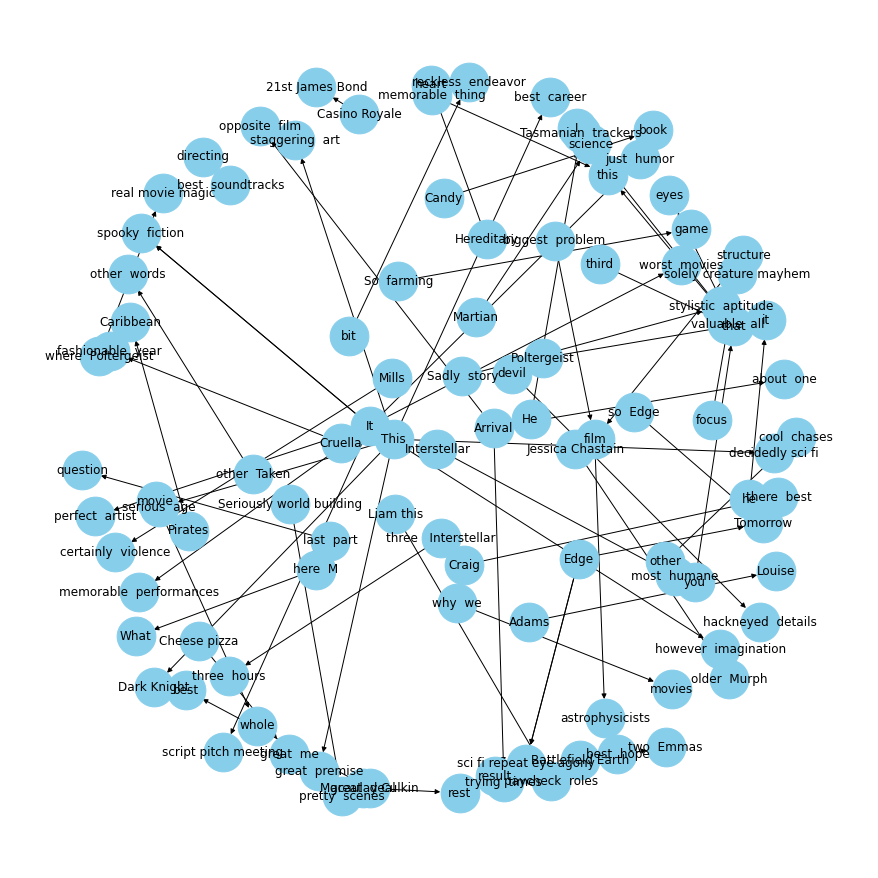

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="is"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

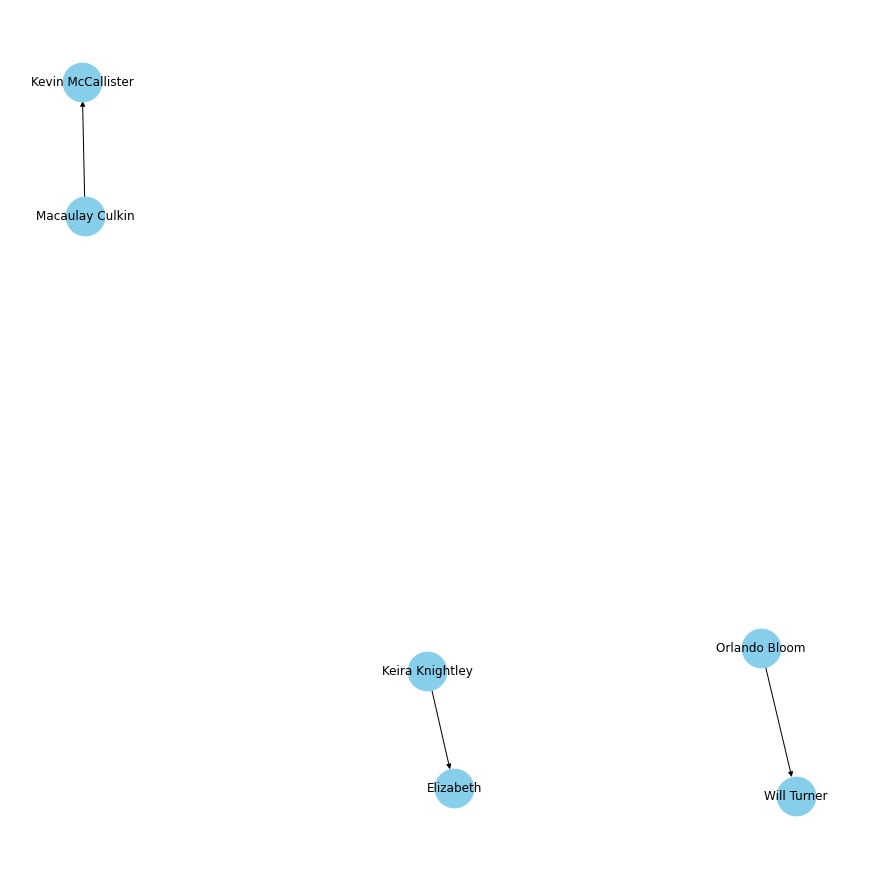

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

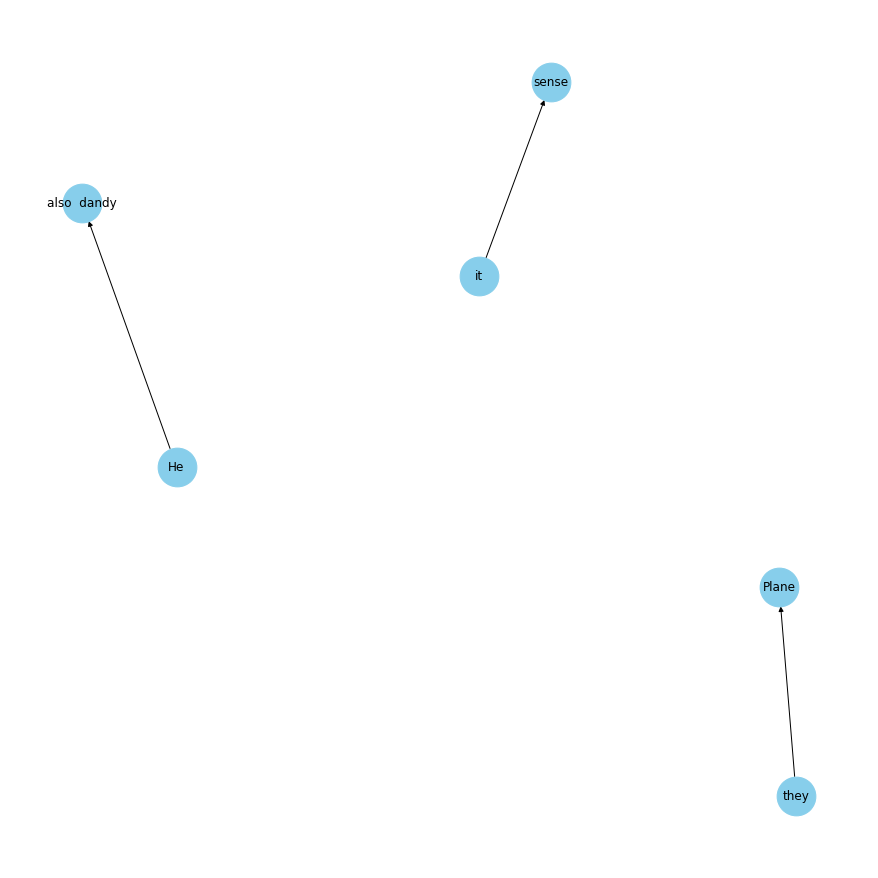

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

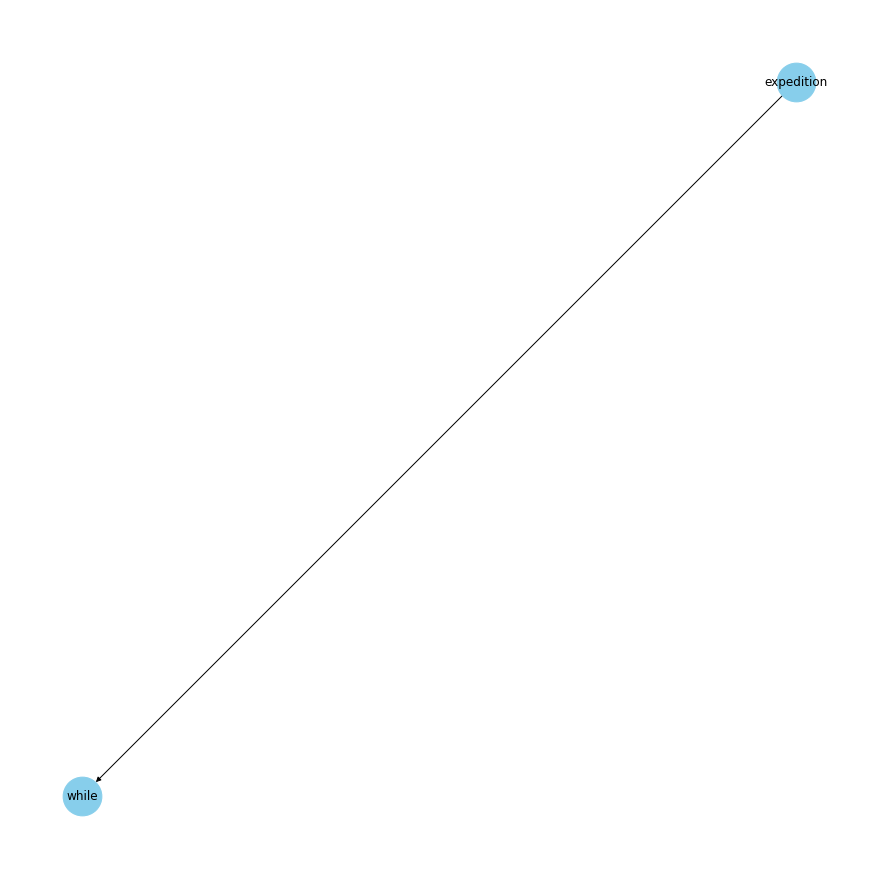

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

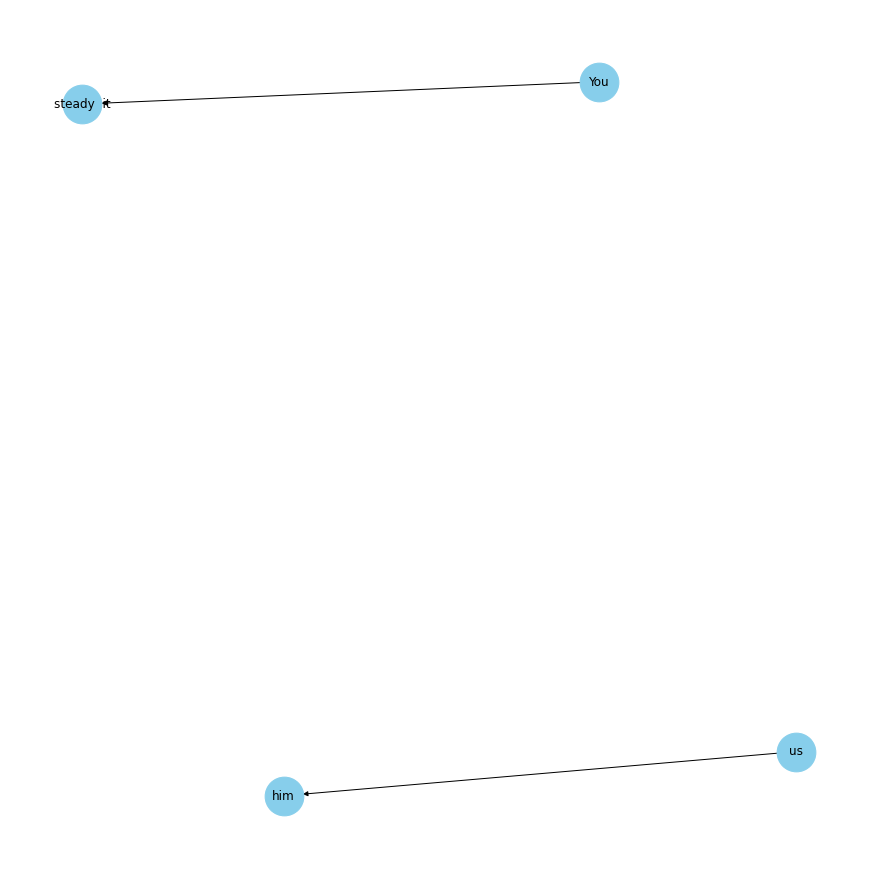

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

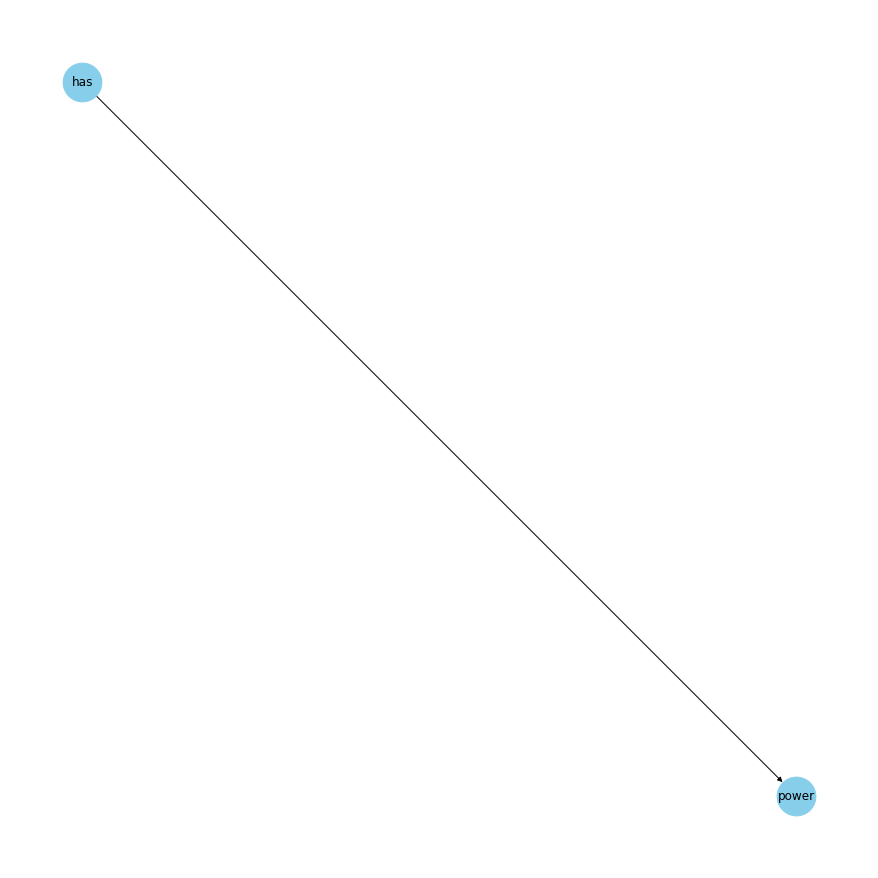

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="story"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation - SINGLE MOVIE

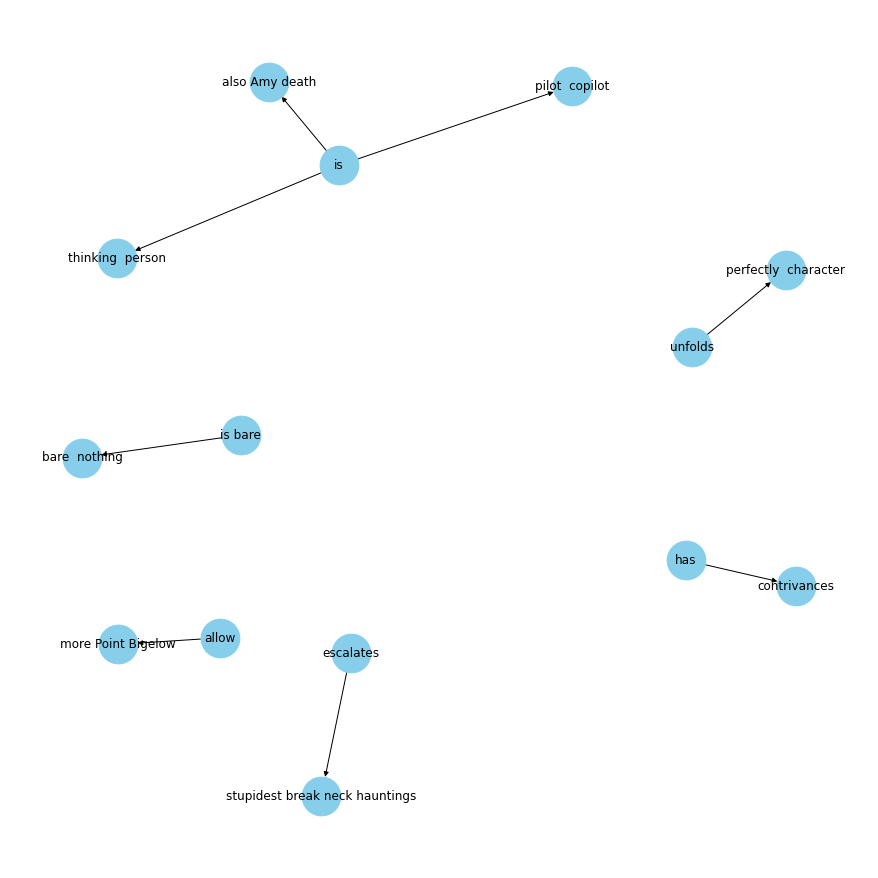

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="story"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation - SINGLE MOVIE

In [ ]:
data['Text'][160:170]

160    ﻿The new film Cruella (in theaters and on Disn...
161    ﻿I never expected to be able to use Disney and...
162    ﻿Cruella De Vil is one of Disney's most iconic...
163    ﻿In 1996, Glenn Close glided onto screens in f...
164    ﻿Think of the delicious new movie “Cruella” as...
165    ﻿In the original, animated 101 Dalmatians, the...
166    ﻿There's an excellent Emma in "Cruella," but i...
167    ﻿With her shock of black-and-white hair and cr...
168    ﻿Everything that’s good about “Cruella” can’t ...
169    ﻿Craig Gillespie’s Cruella explores the backst...
Name: Text, dtype: object

In [ ]:
corpusJoined = ' '.join([x for x in data['Text'][160:170]]).split('.')

In [ ]:
corpusJoined[:5]

['\ufeffThe new film Cruella (in theaters and on Disney+, May 28) is going okay until the fashion show',
 ' Young Cruella de Vil (Emma Stone) is trying to get revenge against a cruel couture designer, the Baroness (Emma Thompson), by staging a guerrilla runway show to upstage the Baroness’s own',
 ' It’s 1970s London, and Cruella and some other models take to the makeshift catwalk in shocking new glam-punk garb while a band thrashes away at a song',
 ' \n\nIt’s at this point that one realizes that the film, directed by I, Tonya’s Craig Gillespie, really is trying to be cool',
 ' And not just cool; it’s crediting a Disney character (inspired by a Dodie Smith character) with the invention of punk']

In [ ]:
short_sentence = []

In [ ]:
for i in range(len(corpusJoined)):
  if len(corpusJoined[i].split()) <= 10:
    temp_sent = corpusJoined[i]
    short_sentence.append(temp_sent)
  else:
    pass

In [ ]:
corpusJoined = short_sentence

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 36/36 [00:00<00:00, 112.72it/s]


In [ ]:
entity_pairs[:5]

[['', ''],
 ['', ''],
 ['Most', 'vain'],
 ['Estella', 'other  ambitions'],
 ['All', 'time']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

## Extract Source and Target

In [ ]:
print(pd.Series(relations).value_counts()[:20])

was                4
                   3
is                 3
makes              2
’s                 2
 Super             1
synergy            1
get                1
P                  1
is well            1
Let                1
manage             1
two                1
\n                 1
features           1
Rudin              1
cherishes other    1
's high            1
Enjoy              1
are total          1
dtype: int64


In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
print(pd.Series(source).value_counts()[:10])

                               10
It                              4
Cruella                         3
She                             2
she                             1
film                            1
movie                           1
unfortunately Mark Baroness     1
phase                           1
obvious  precedent              1
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:10])

                             19
time                          1
writers                       1
fashionable  year             1
first rate costume design     1
Cruella                       1
perfect  Cruella              1
flick                         1
supporting  cast              1
decadent  standalone          1
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
kg_df.replace('', np.nan, inplace=True)

In [ ]:
kg_df.dropna(inplace=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

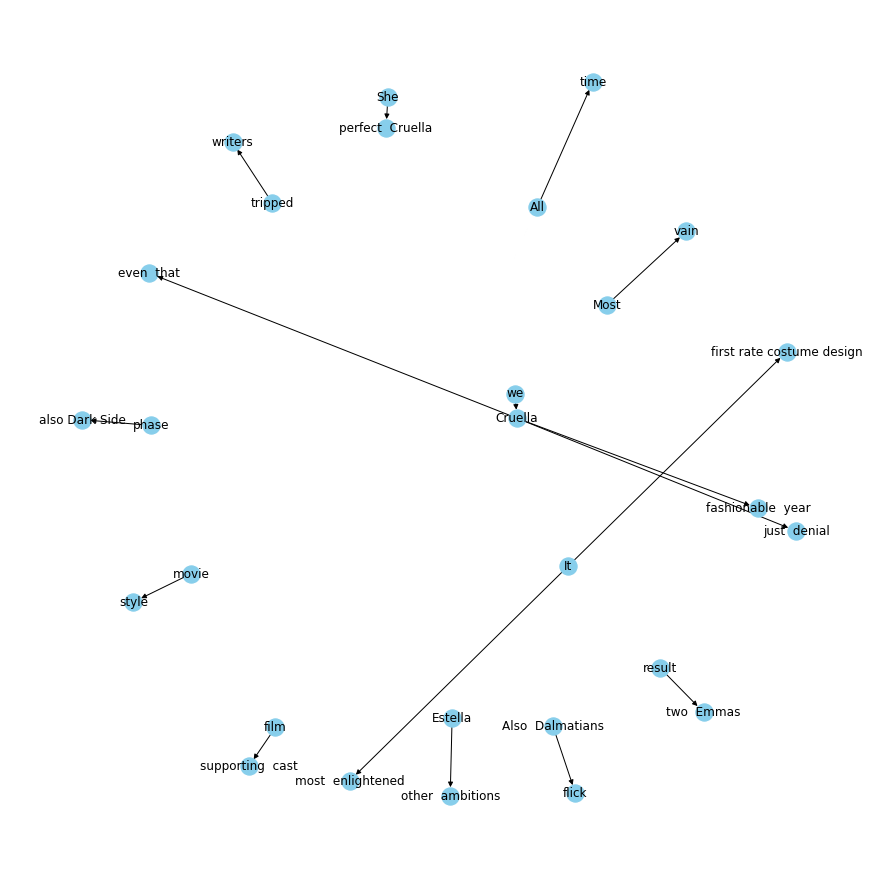

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

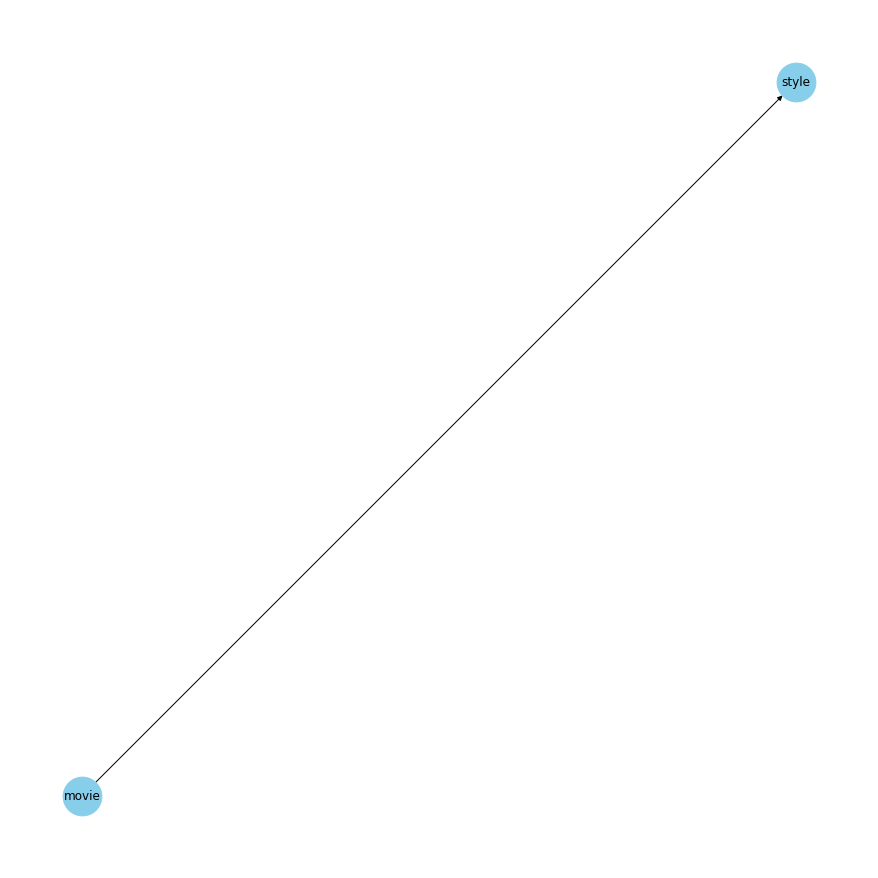

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

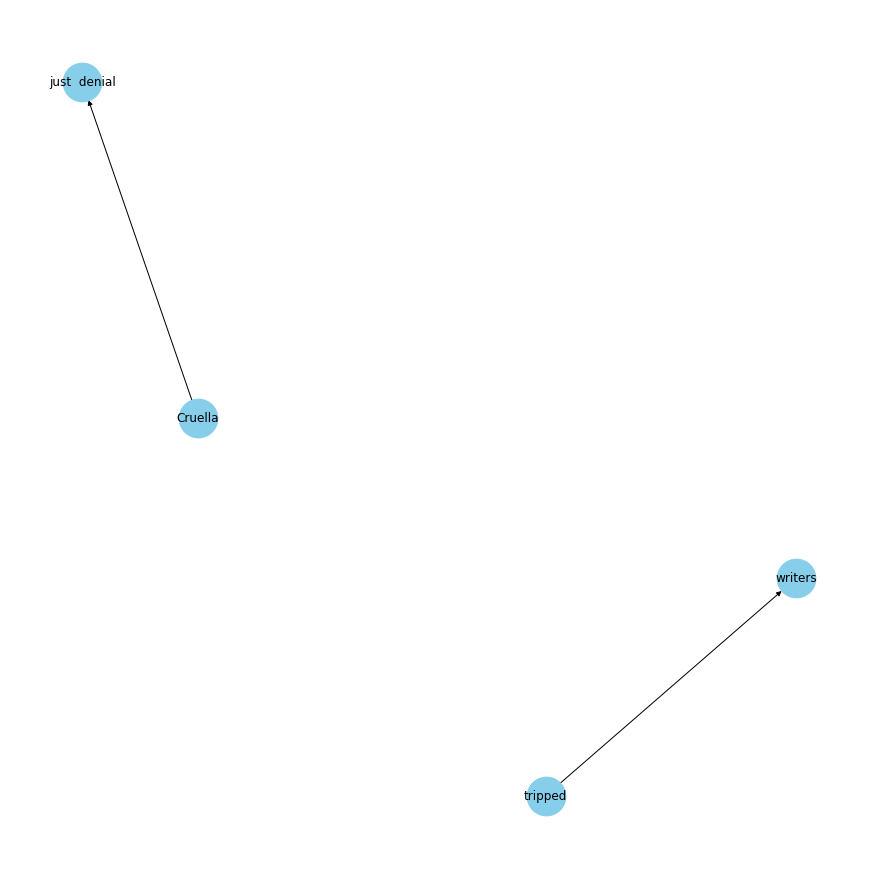

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="was"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

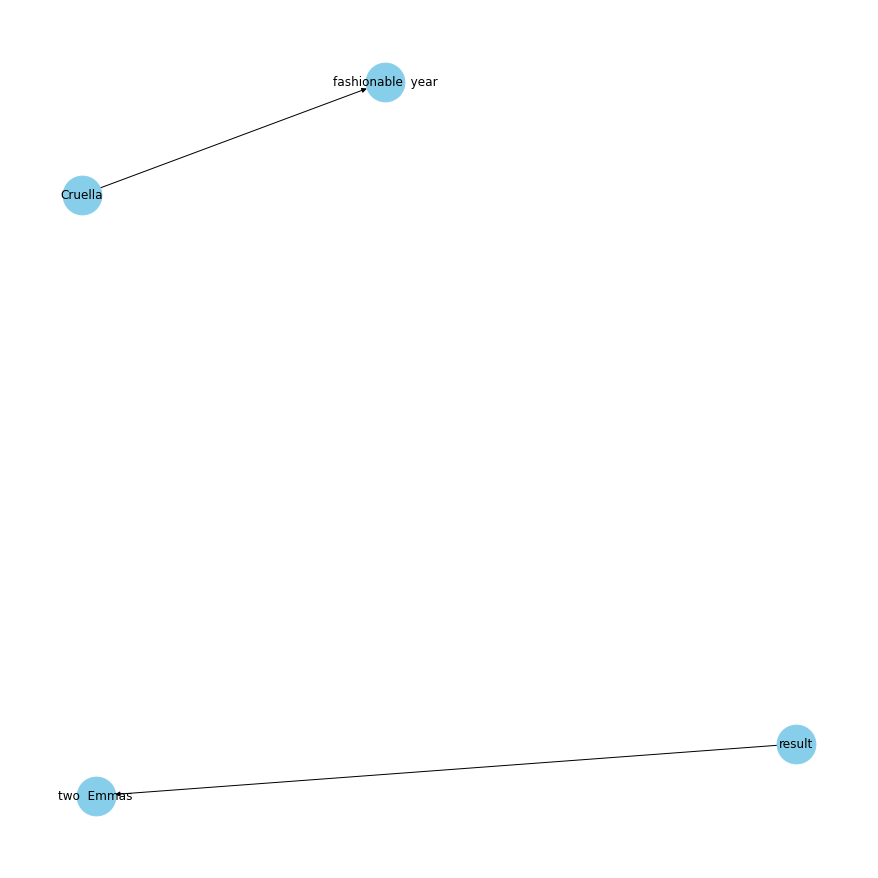

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="is"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

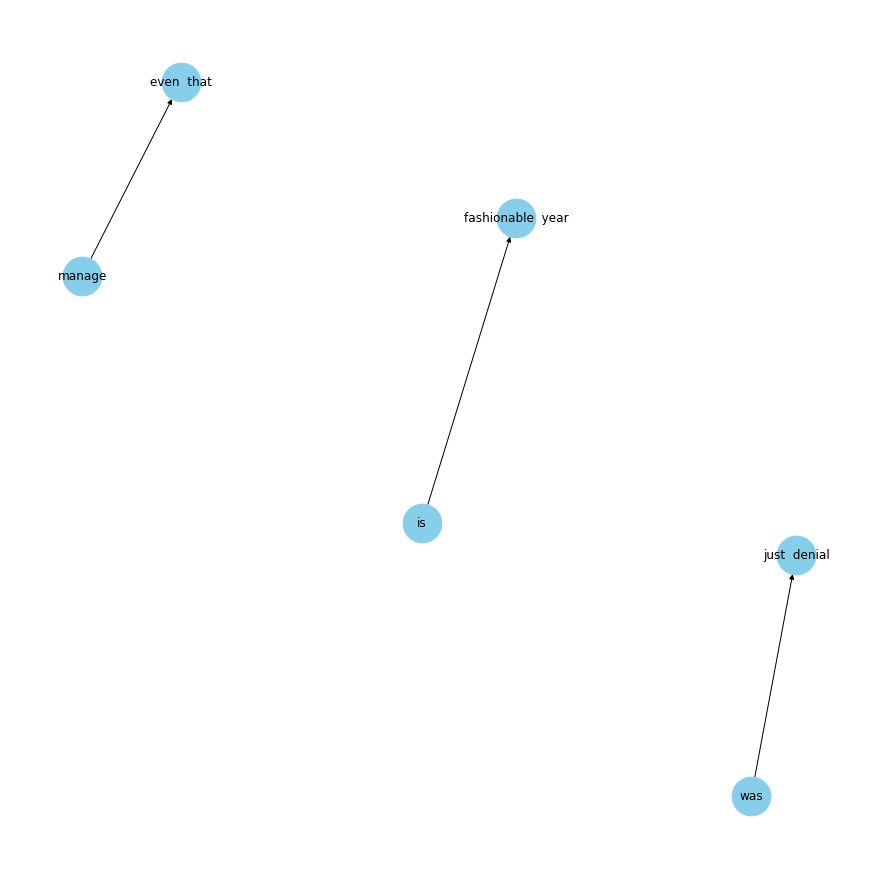

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="Cruella"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation

In [ ]:
corpusJoined = ' '.join([x for x in data['Text']]).split('.')

In [ ]:
corpusJoined[:5]

['Canadian director Denis Villeneuve made one great film in 2013 called Prisoners',
 ' Provocative, enthralling and beautifully composed, it peeled away the layers of a complex mystery story with a surprise in every frame',
 ' I was an instant fan',
 ' This promising relationship has come to a heartbreaking finale with every film since',
 ' Enemy and Sicario were unspeakable disasters, and Arrival, the director’s latest exercise in pretentious poopery, gives me every reason to believe I have parted company with Denis Villeneuve for good']

## Function for entity extraction

In [ ]:
#function for entity extraction
def get_entities(sent):
  ## chunk 1
  ent1 = ""
  ent2 = ""

  prv_tok_dep = ""    # dependency tag of previous token in the sentence
  prv_tok_text = ""   # previous token in the sentence

  prefix = ""
  modifier = ""

  #############################################################
  
  for tok in nlp(sent):
    ## chunk 2
    # if token is a punctuation mark then move on to the next token
    if tok.dep_ != "punct":
      # check: token is a compound word or not
      if tok.dep_ == "compound":
        prefix = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          prefix = prv_tok_text + " "+ tok.text
      
      # check: token is a modifier or not
      if tok.dep_.endswith("mod") == True:
        modifier = tok.text
        # if the previous word was also a 'compound' then add the current word to it
        if prv_tok_dep == "compound":
          modifier = prv_tok_text + " "+ tok.text
      
      ## chunk 3
      if tok.dep_.find("subj") == True:
        ent1 = modifier +" "+ prefix + " "+ tok.text
        prefix = ""
        modifier = ""
        prv_tok_dep = ""
        prv_tok_text = ""      

      ## chunk 4
      if tok.dep_.find("obj") == True:
        ent2 = modifier +" "+ prefix +" "+ tok.text
        
      ## chunk 5  
      # update variables
      prv_tok_dep = tok.dep_
      prv_tok_text = tok.text
  #############################################################

  return [ent1.strip(), ent2.strip()]

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 6715/6715 [01:24<00:00, 79.20it/s]


In [ ]:
entity_pairs[:5]

[['Canadian director Denis Villeneuve', 'called  Prisoners'],
 ['beautifully  it', 'complex mystery frame'],
 ['I', ''],
 ['promising  relationship', 'heartbreaking  film'],
 ['pretentious  I', 'Denis good']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         816
           406
’s         279
's         177
are        159
has        103
was         88
have        70
be          63
made        33
plays       33
makes       33
seems       30
takes       30
been        26
seem        24
gives       23
becomes     23
\n\n        22
had         22
dtype: int64


## Extract Source and Target

In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
kg_df.head(100)

,source,target,edge
0,Canadian director Denis Villeneuve,called Prisoners,made
1,beautifully it,complex mystery frame,peeled
2,I,,was
3,promising relationship,heartbreaking film,come to
4,pretentious I,Denis good,were unspeakable
...,...,...,...
95,language,real two,thinks
96,two people,together end,end
97,staid we,staid tropes,set
98,Arrival,trying times,is


In [ ]:
print(pd.Series(source).value_counts()[:20])

         566
it       154
It       146
that     124
he       107
I        101
they      86
who       66
He        65
you       64
we        53
she       51
They      45
film      39
movie     35
She       34
This      32
We        30
You       25
which     25
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:20])

             767
it            94
them          48
you           28
him           27
film          27
movie         22
me            18
that          15
what          15
her           14
time          11
house         10
world         10
us            10
this           9
family         9
something      9
one            8
life           8
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
kg_df.replace('', np.nan, inplace=True)

In [ ]:
kg_df.dropna(inplace=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

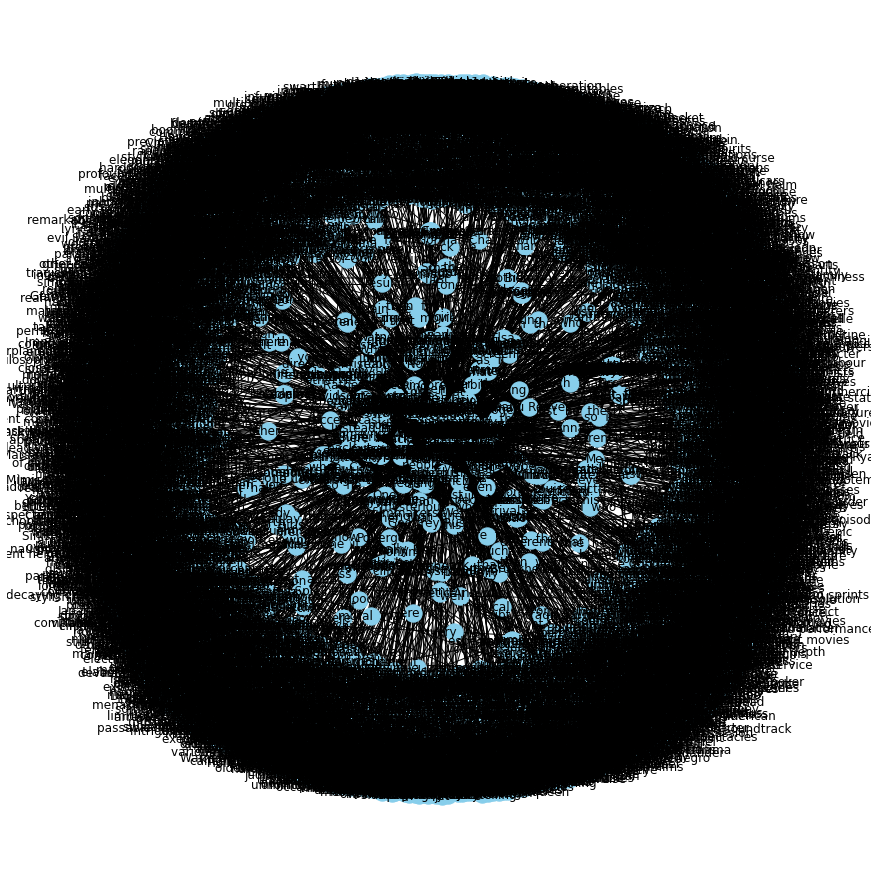

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

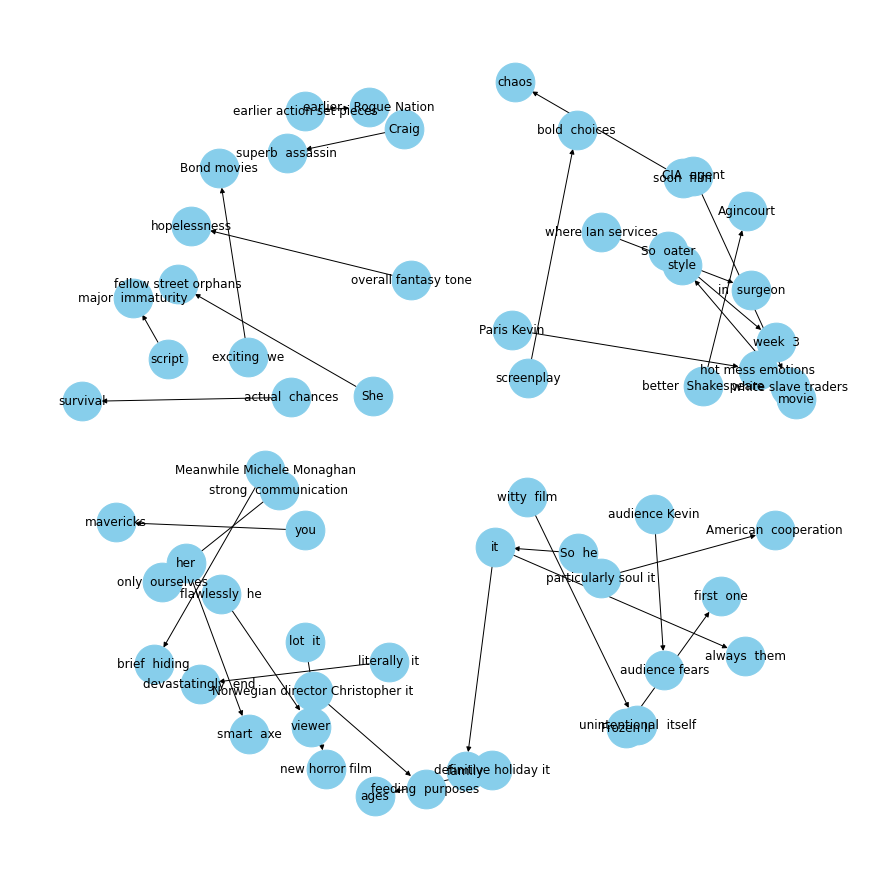

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

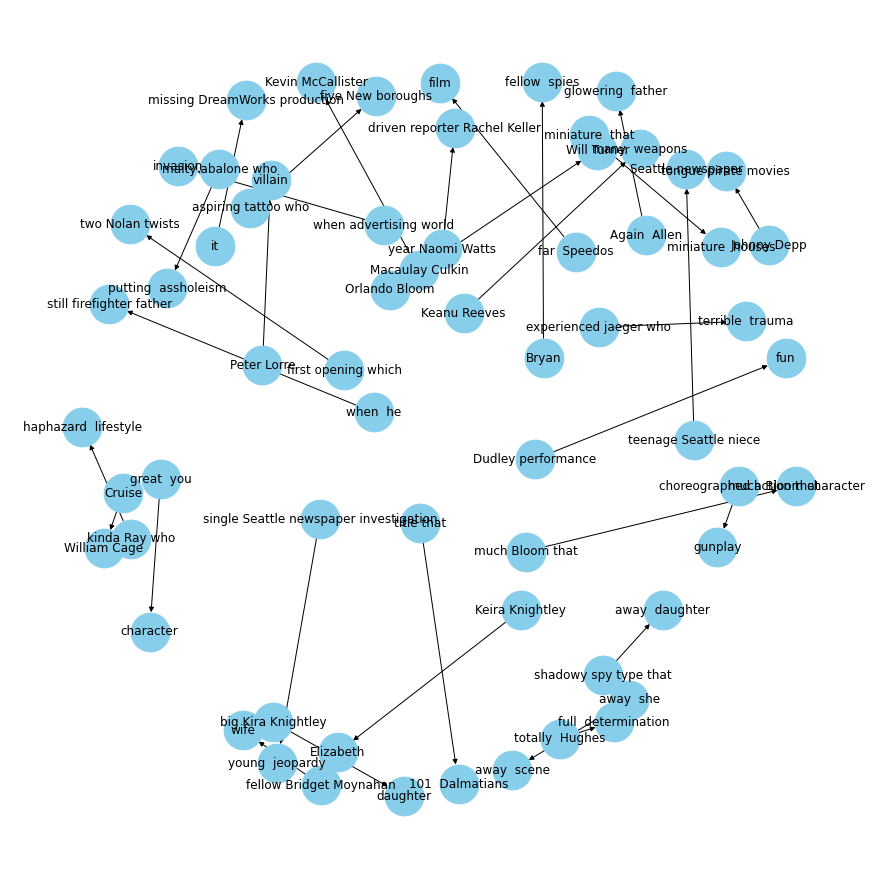

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

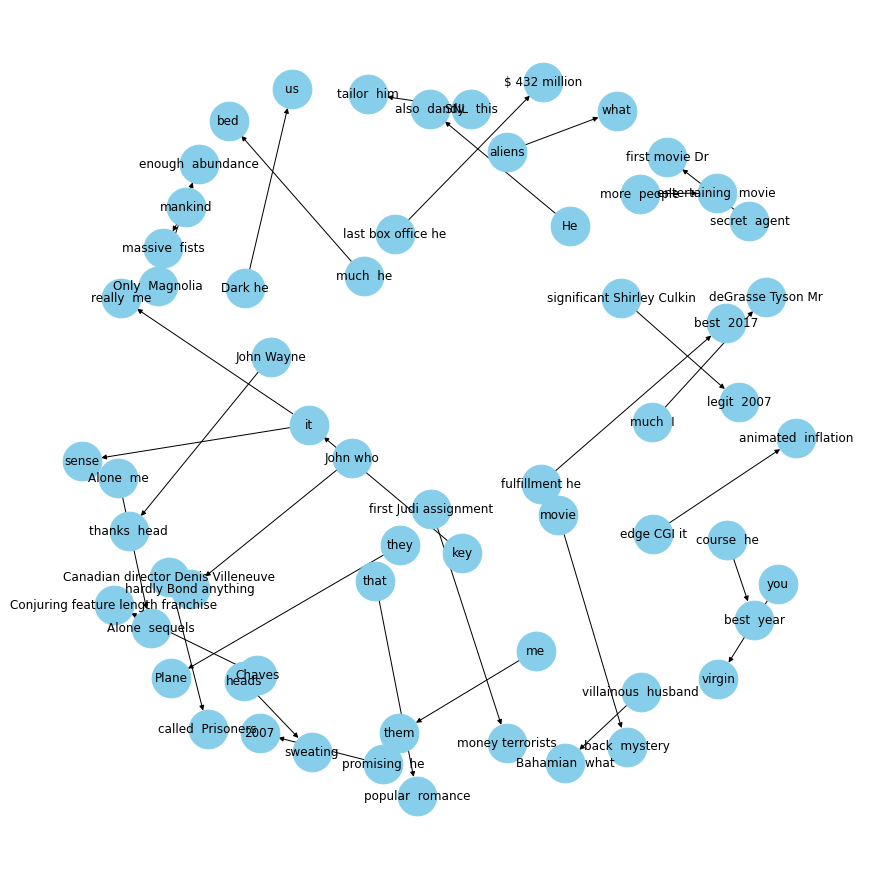

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

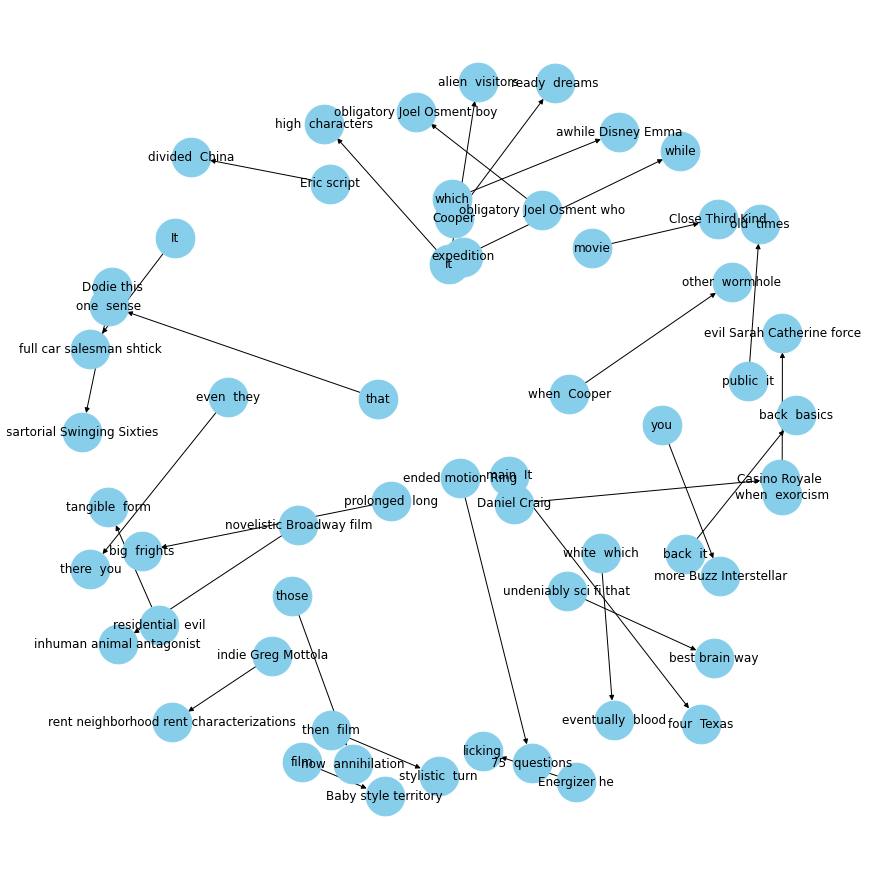

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

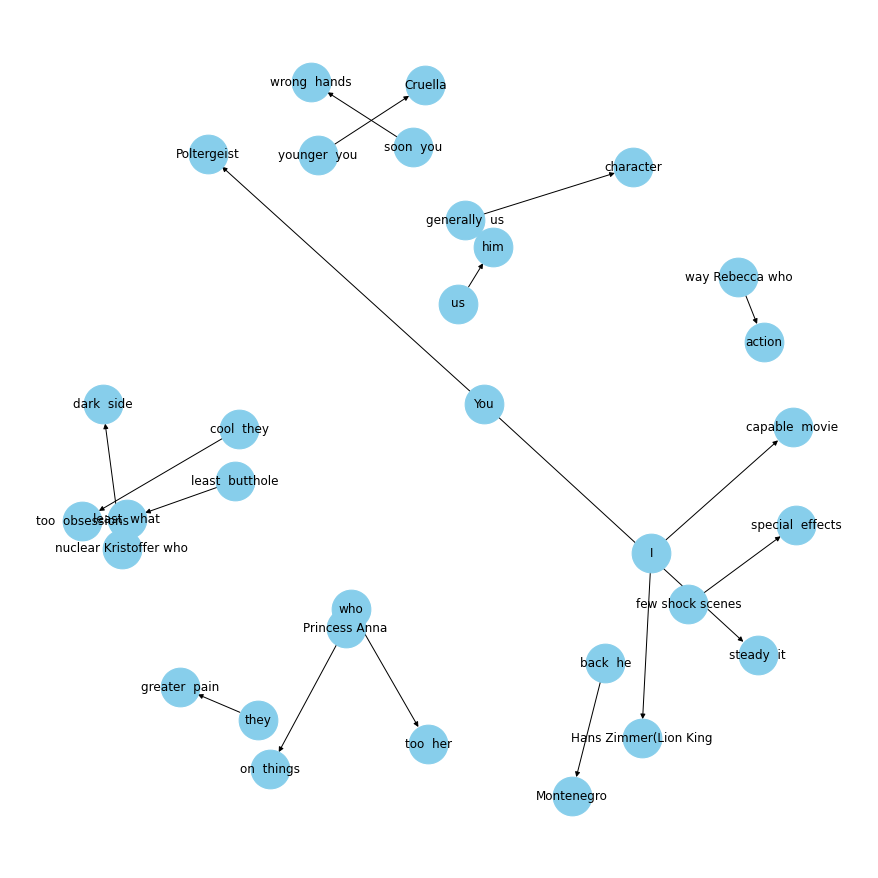

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

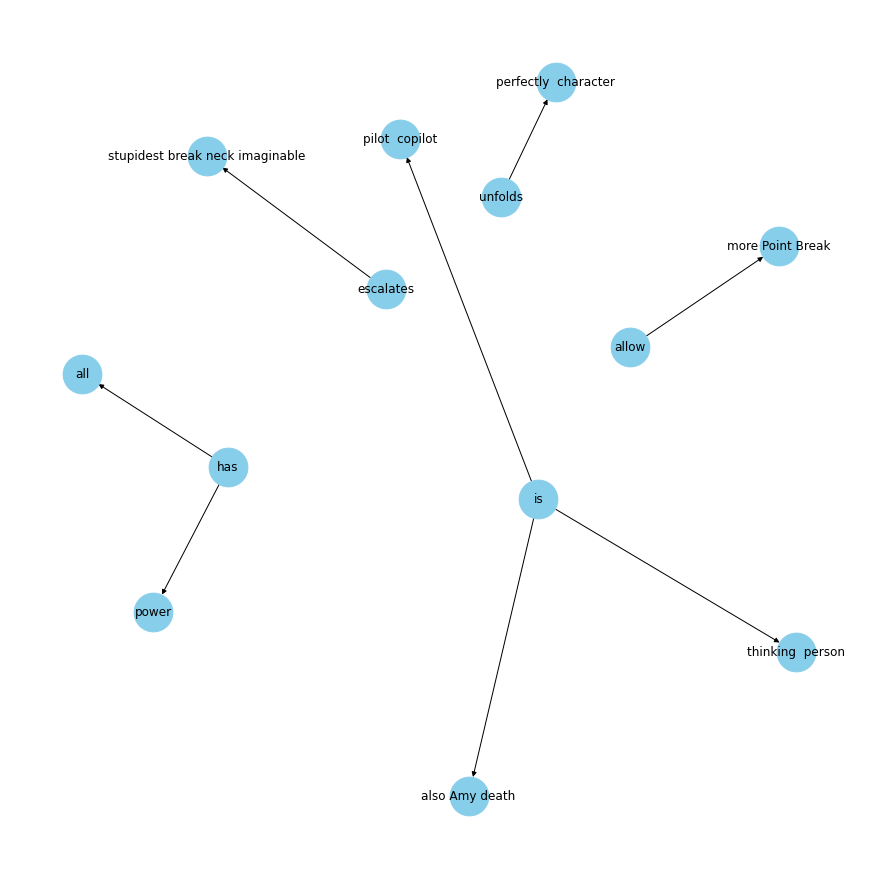

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="story"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Create one big blog of text for knowledge graph generation - SINGLE MOVIE

In [ ]:
data['Text'][160:170]

160    ﻿The new film Cruella (in theaters and on Disn...
161    ﻿I never expected to be able to use Disney and...
162    ﻿Cruella De Vil is one of Disney's most iconic...
163    ﻿In 1996, Glenn Close glided onto screens in f...
164    ﻿Think of the delicious new movie “Cruella” as...
165    ﻿In the original, animated 101 Dalmatians, the...
166    ﻿There's an excellent Emma in "Cruella," but i...
167    ﻿With her shock of black-and-white hair and cr...
168    ﻿Everything that’s good about “Cruella” can’t ...
169    ﻿Craig Gillespie’s Cruella explores the backst...
Name: Text, dtype: object

In [ ]:
corpusJoined = ' '.join([x for x in data['Text'][160:170]]).split('.')

In [ ]:
corpusJoined[:5]

['\ufeffThe new film Cruella (in theaters and on Disney+, May 28) is going okay until the fashion show',
 ' Young Cruella de Vil (Emma Stone) is trying to get revenge against a cruel couture designer, the Baroness (Emma Thompson), by staging a guerrilla runway show to upstage the Baroness’s own',
 ' It’s 1970s London, and Cruella and some other models take to the makeshift catwalk in shocking new glam-punk garb while a band thrashes away at a song',
 ' \n\nIt’s at this point that one realizes that the film, directed by I, Tonya’s Craig Gillespie, really is trying to be cool',
 ' And not just cool; it’s crediting a Disney character (inspired by a Dodie Smith character) with the invention of punk']

## Entity pair extraction from corpus

In [ ]:
#entity pair extraction from corpus
entity_pairs = []

for i in tqdm(corpusJoined):
  entity_pairs.append(get_entities(i))

100%|██████████| 268/268 [00:03<00:00, 77.20it/s]


In [ ]:
entity_pairs[:5]

[['new  film', 'May'],
 ['de  Vil', 'cruel guerrilla runway own'],
 ['glam punk band', 'away  song'],
 ['film', 'I'],
 ['just  it', 'Dodie Smith punk']]

## Function to Get Relations

In [ ]:
relations = []

for i in corpusJoined:
    relations.append(get_relation(i))

## Extract Source and Target

In [ ]:
print(pd.Series(relations).value_counts()[:20])

is         29
’s         18
was         9
            9
's          6
makes       4
wants       3
been        3
are         3
gets        3
keeps       3
takes       3
gives       3
becomes     3
’s at       2
have        2
made        2
meant       2
wasted      2
plays       2
dtype: int64


In [ ]:
#extract subject
source = [i[0] for i in entity_pairs]

# extract object
target = [i[1] for i in entity_pairs]

kg_df = pd.DataFrame({'source':source, 'target':target, 'edge':relations})

In [ ]:
print(pd.Series(source).value_counts()[:10])

           17
Cruella    10
It          8
she         8
She         7
movie       5
film        4
who         3
that        3
it          3
dtype: int64


In [ ]:
print(pd.Series(target).value_counts()[:10])

                    26
them                 3
time                 2
her                  2
one                  2
101  Dalmatians      2
kids                 2
Cruella de Vil       2
Cruella              2
supporting  cast     1
dtype: int64


## Create a directed-graph from the Dataframe

In [ ]:
kg_df.replace('', np.nan, inplace=True)

In [ ]:
kg_df.dropna(inplace=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df, "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

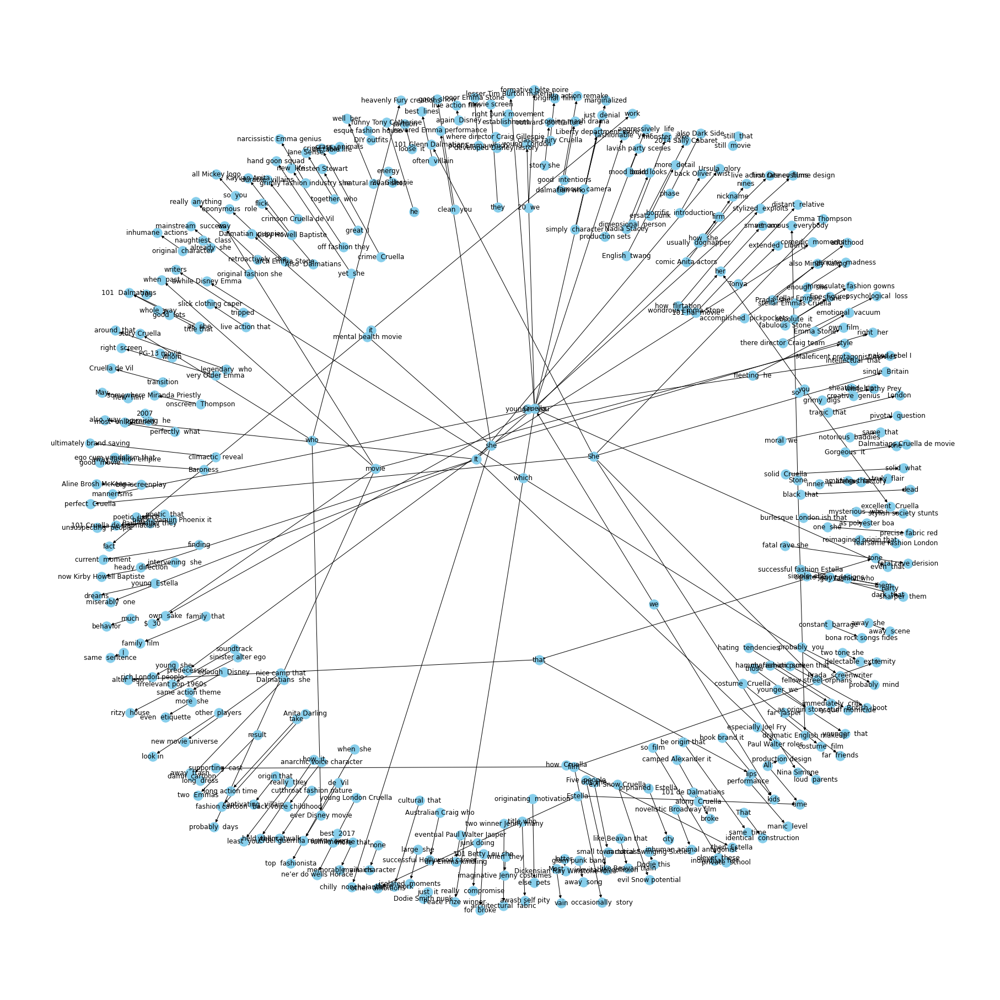

In [ ]:
plt.figure(figsize=(25,25))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
kg_df = kg_df.sort_values('source', ascending=True)

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[0:67], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

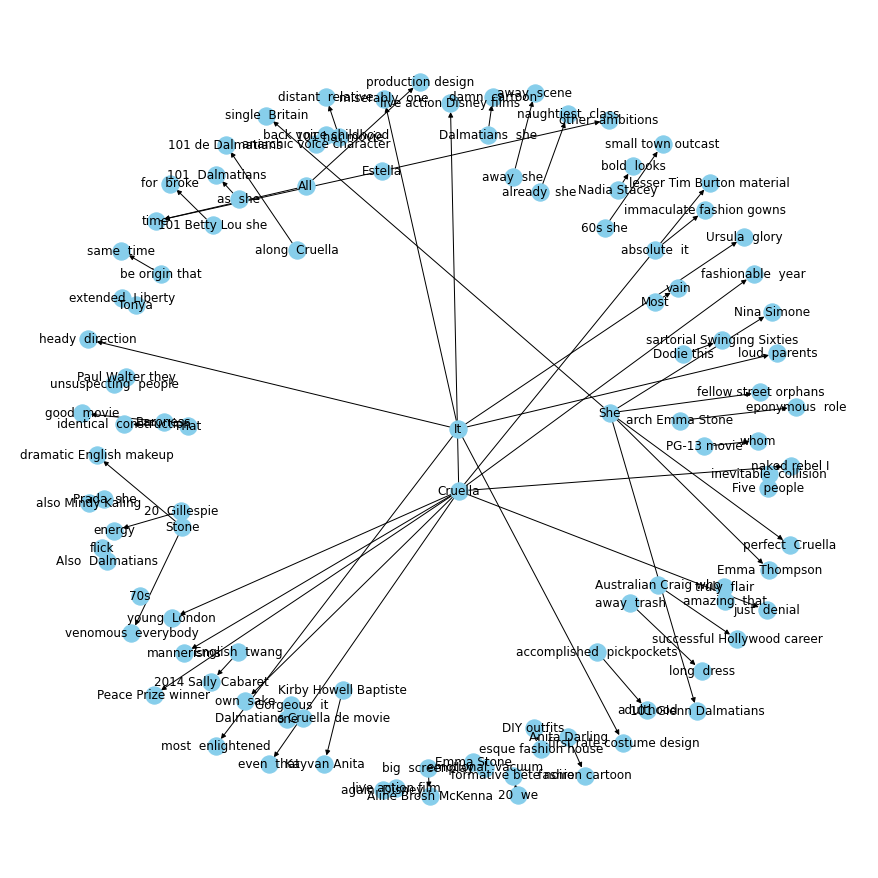

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[67:134], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

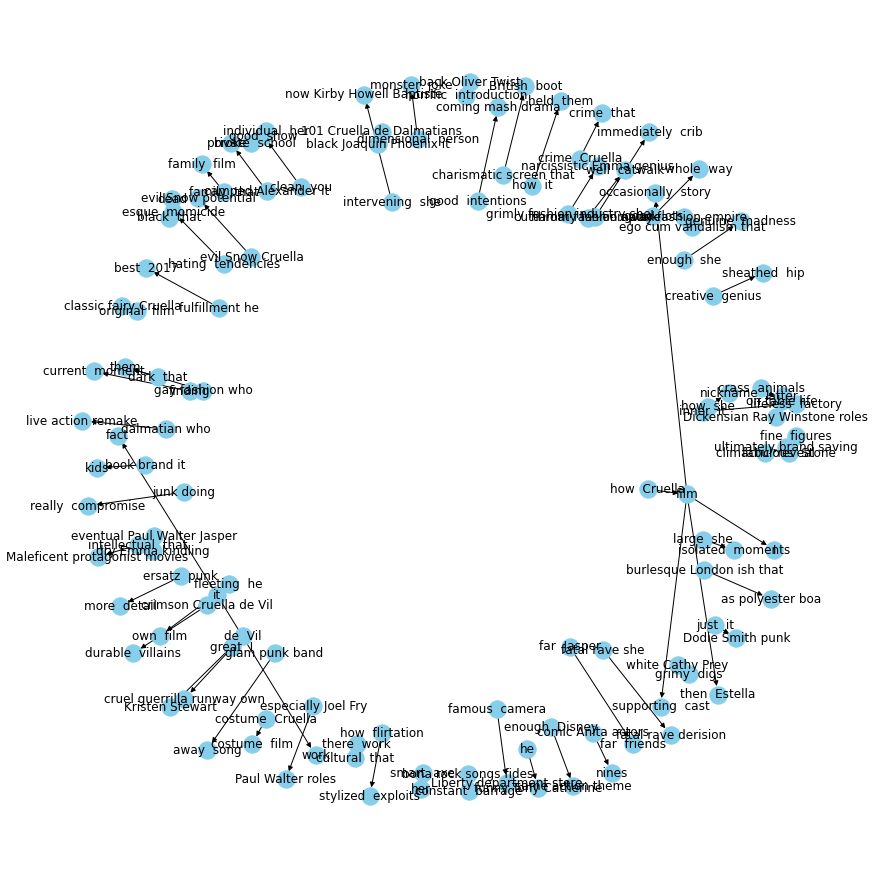

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[134:201], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

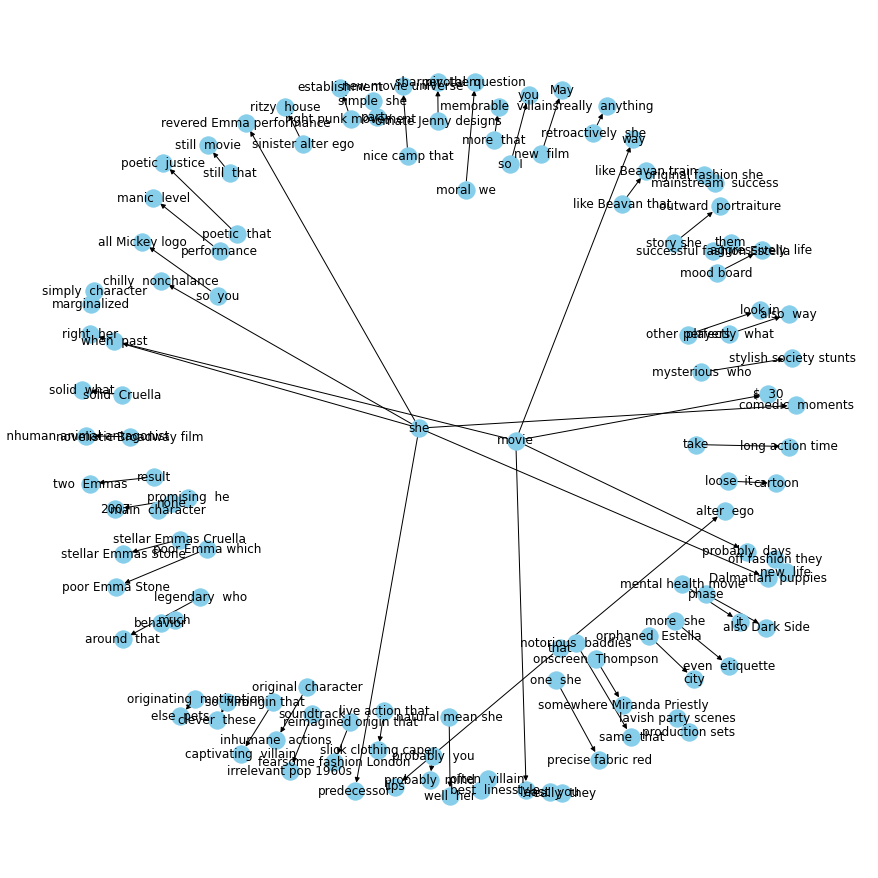

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
# create a directed-graph from a dataframe
G=nx.from_pandas_edgelist(kg_df[201:], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

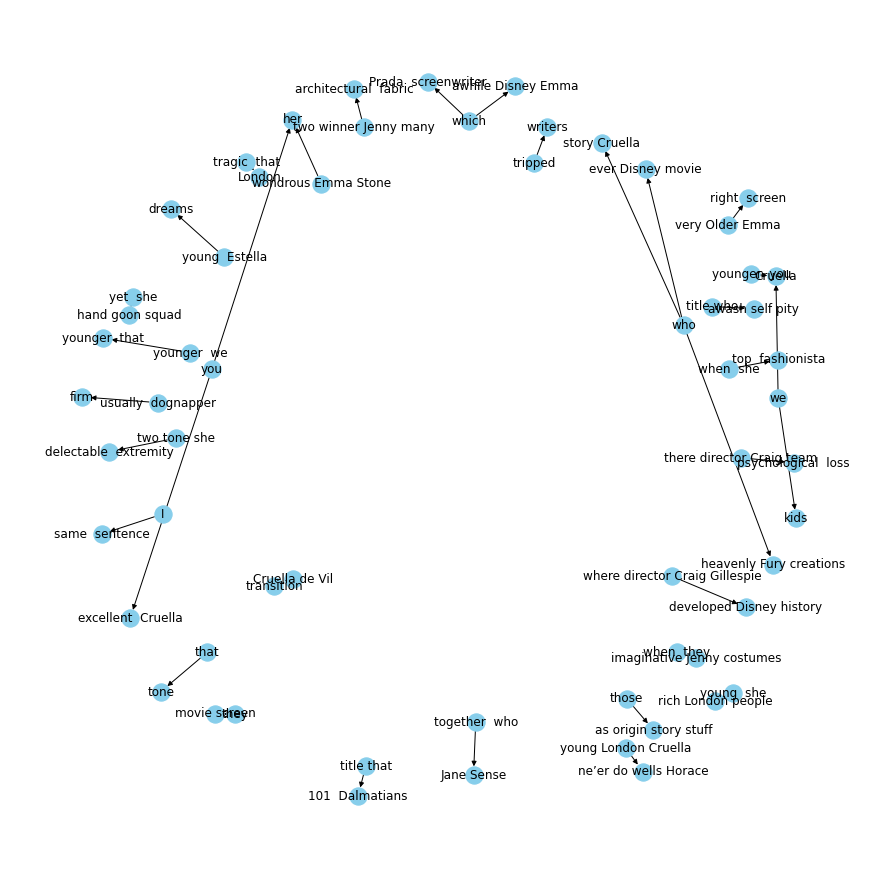

In [ ]:
plt.figure(figsize=(12,12))

pos = nx.spring_layout(G)
nx.draw(G, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

In [ ]:
len(kg_df)

235

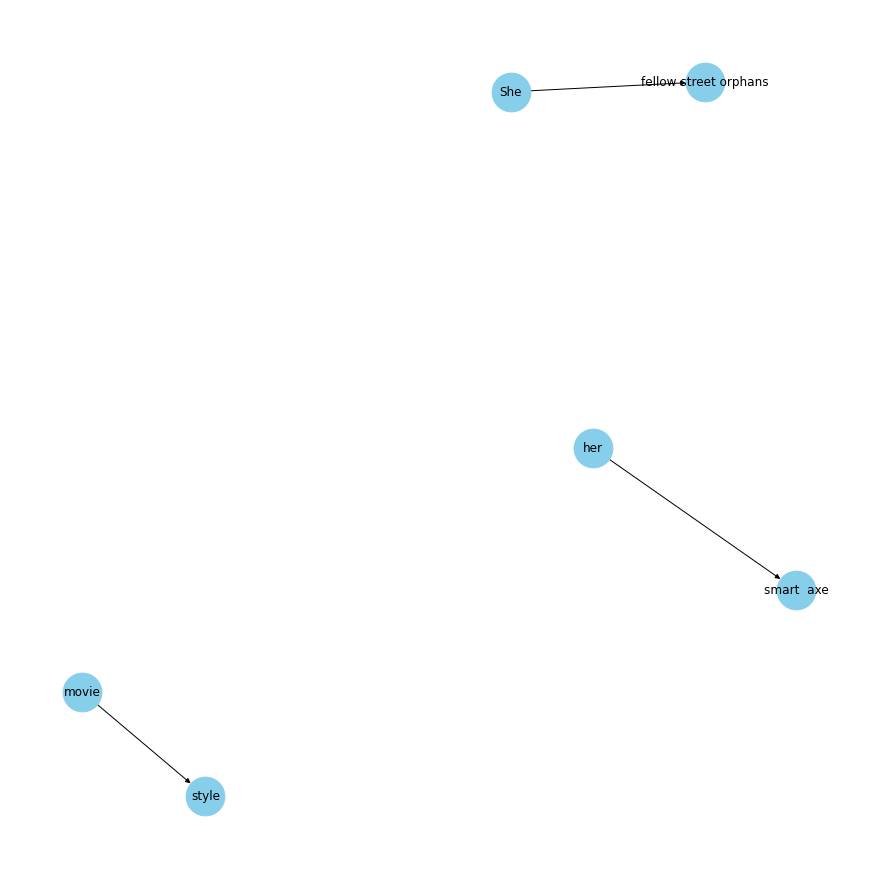

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="makes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

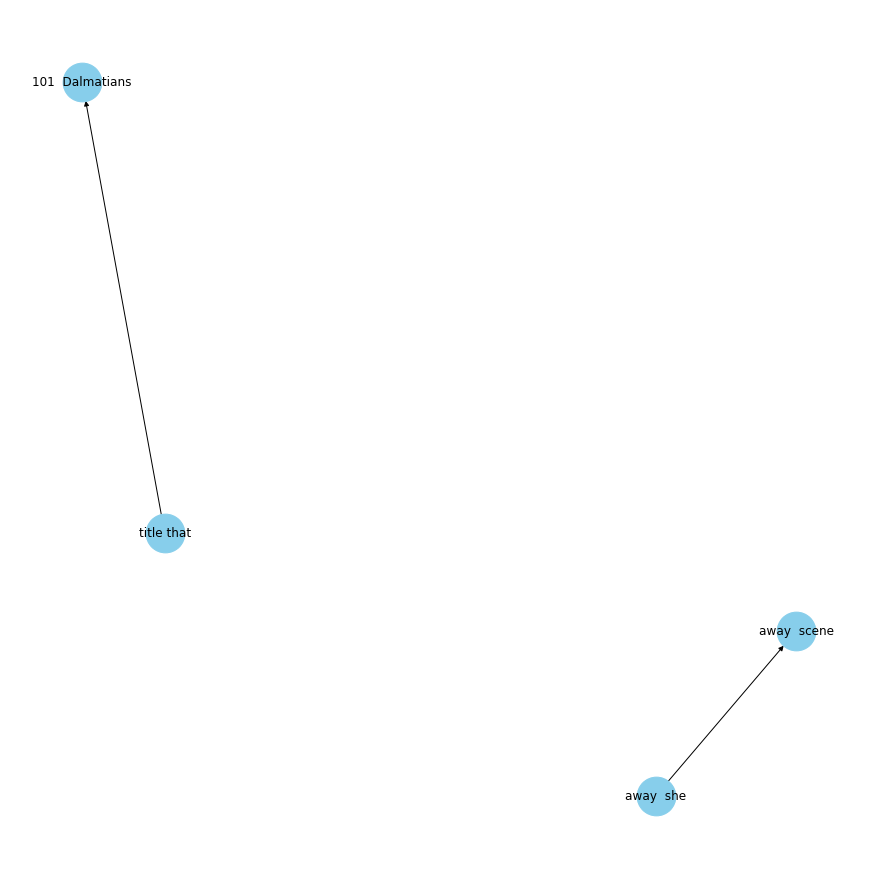

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="plays"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

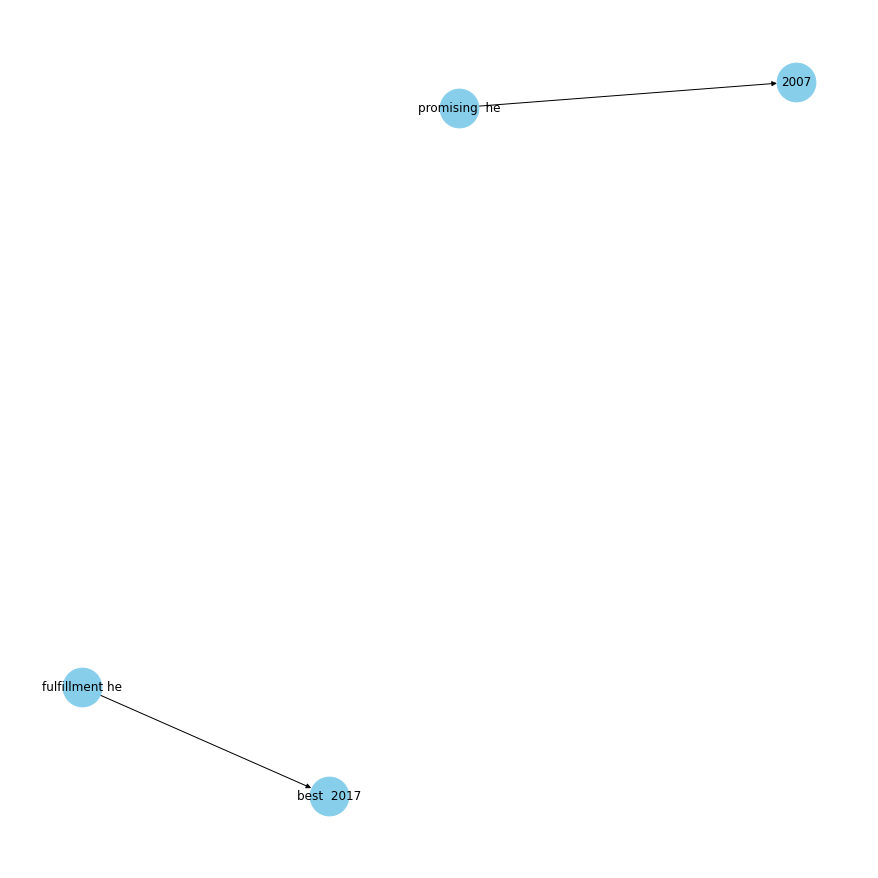

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="made"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

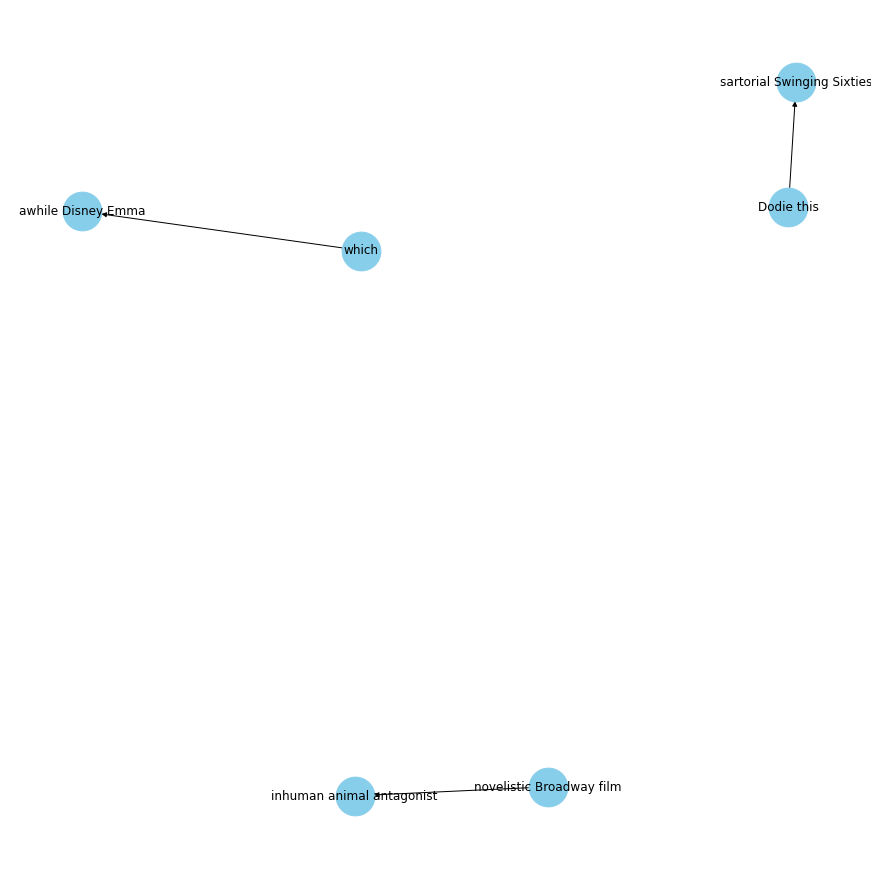

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="takes"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

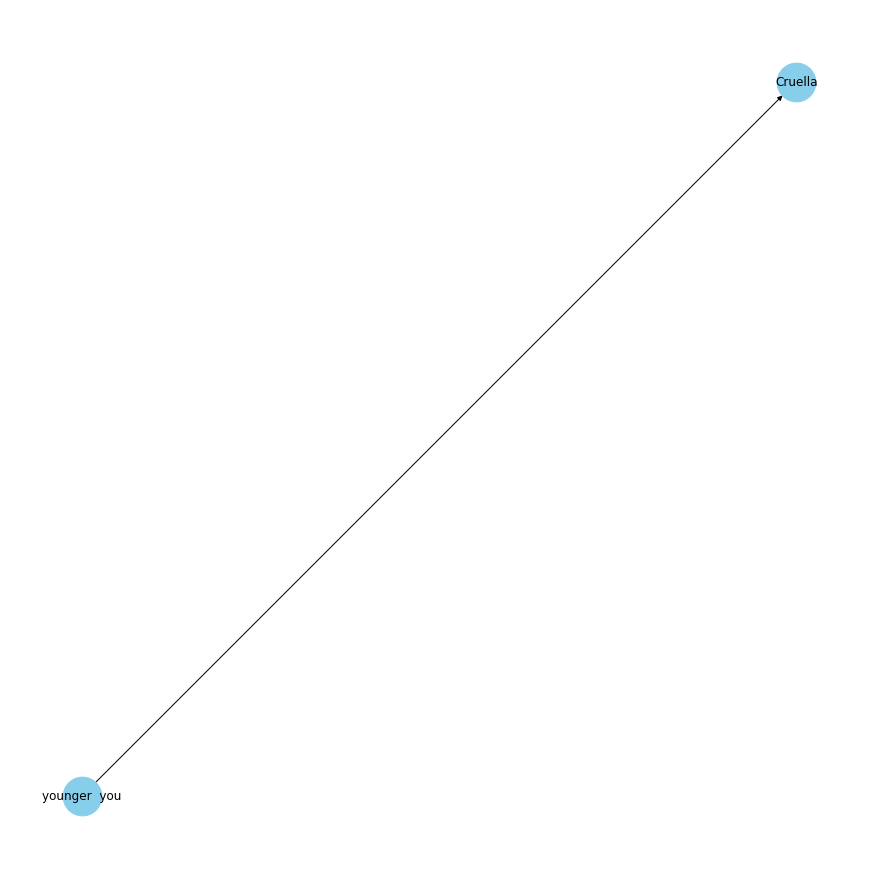

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="want"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

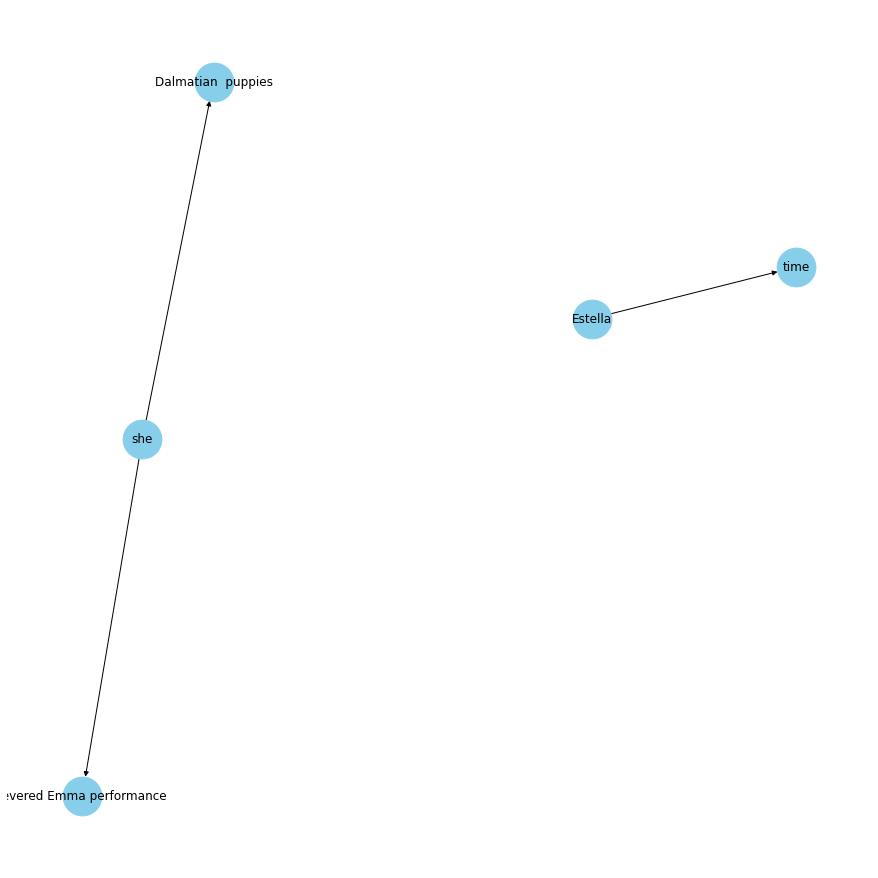

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="wants"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

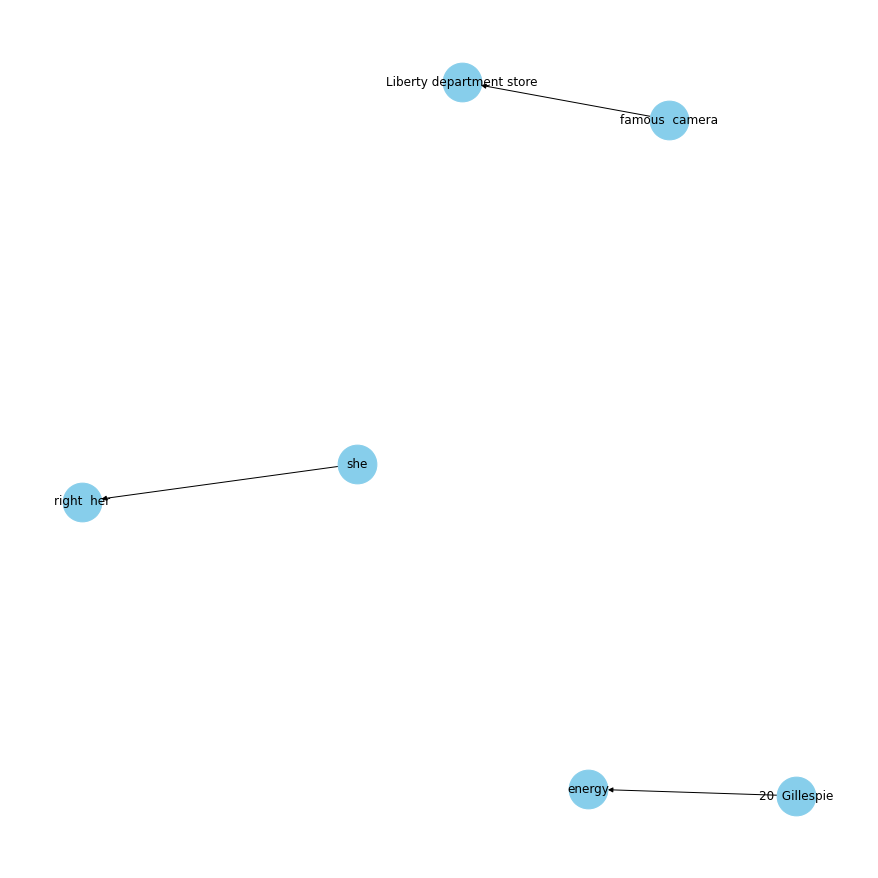

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="keeps"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

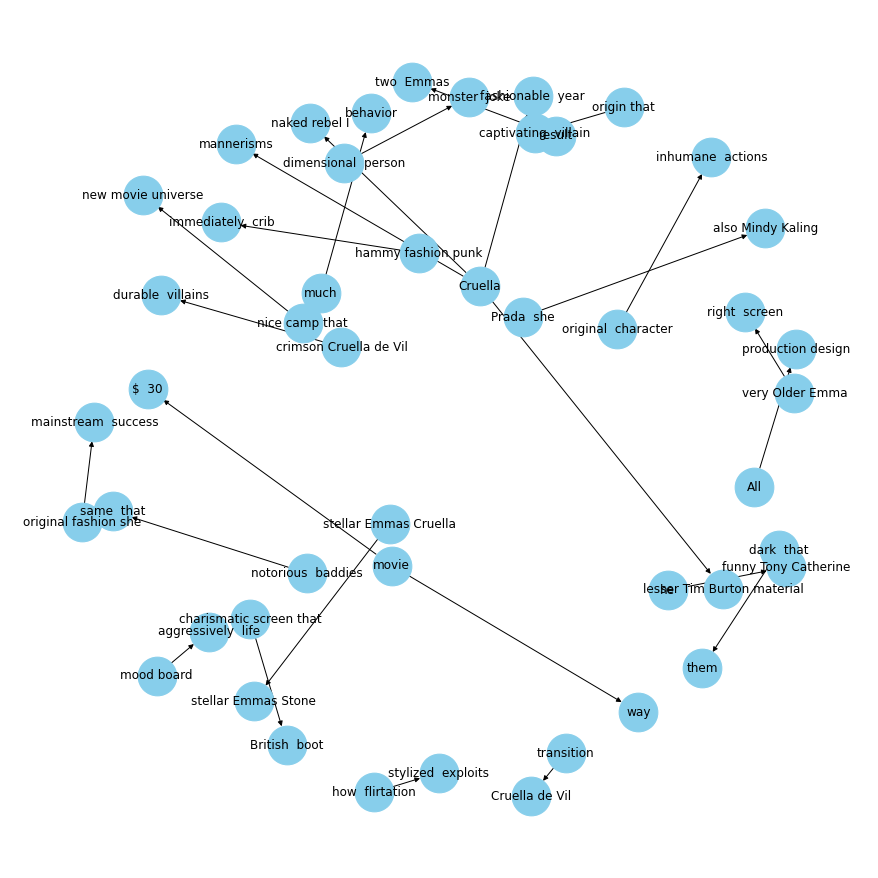

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="is"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

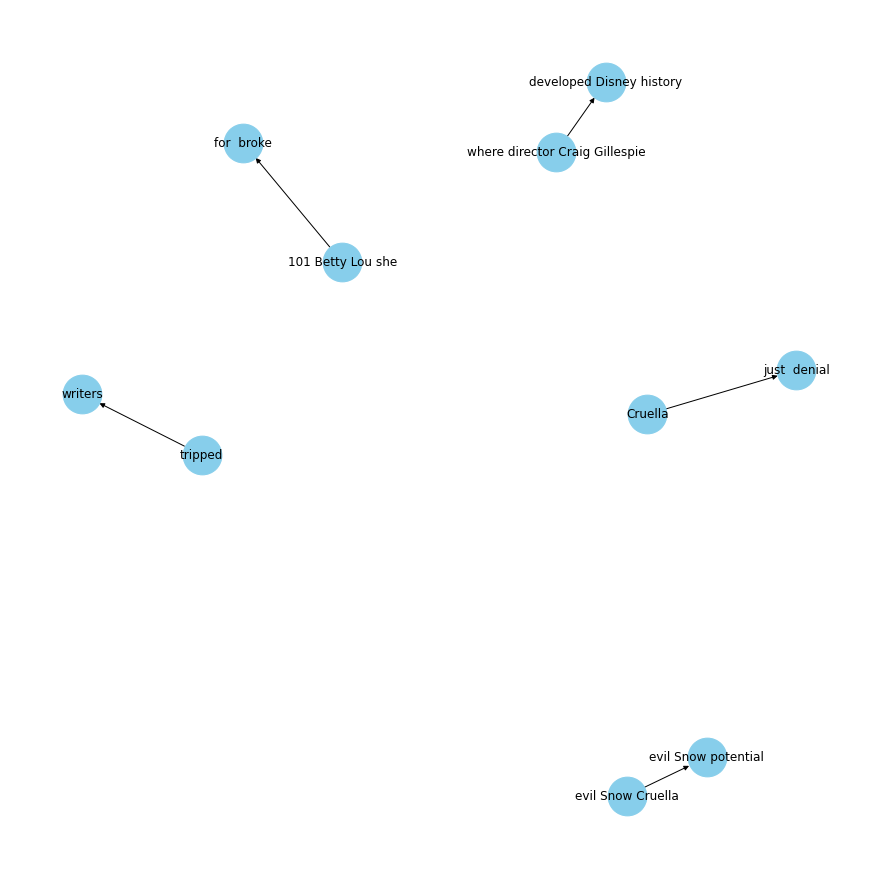

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['edge']=="was"], "source", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

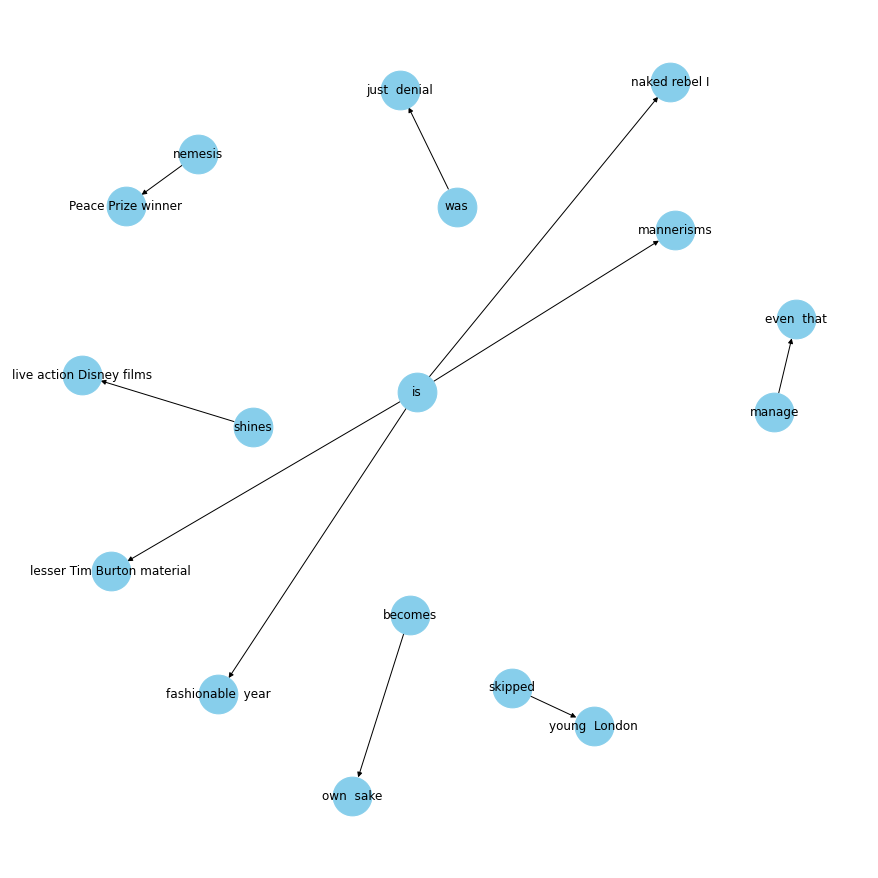

In [ ]:
G=nx.from_pandas_edgelist(kg_df[kg_df['source']=="Cruella"], "edge", "target", 
                          edge_attr=True, create_using=nx.MultiDiGraph())

plt.figure(figsize=(12,12))
pos = nx.spring_layout(G, k = 0.5) # k regulates the distance between nodes
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_cmap=plt.cm.Blues, pos = pos)
plt.show()

## Make HTML

In [ ]:
%%shell
jupyter nbconvert --to html /content/Holst_Assignment_A_3_Ontology_and_Context.ipynb

[NbConvertApp] Converting notebook /content/Holst_Assignment_A_3_Ontology_and_Context.ipynb to html
/usr/local/lib/python2.7/dist-packages/nbconvert/filters/datatypefilter.py:41: UserWarning: Your element with mimetype(s) [u'application/vnd.colab-display-data+json'] is not able to be represented.
  mimetypes=output.keys())
[NbConvertApp] Writing 23910389 bytes to /content/Holst_Assignment_A_3_Ontology_and_Context.html
